# <b> Neutrophil Lymphangioleiomyomatosis (LAM) Analysis - for Sasha-Gaye Richards, PhD from the Johnson Lab <b>
This is the notebook for the analysis of different Neutrophil phenotypes using online available datasets of single cell RNA Seq data.
- Single-Cell Transcriptomic Analysis Identifies a Unique Pulmonary Lymphangioleiomyomatosis Cell
    - DOI: https://doi.org/10.1164/rccm.201912-2445OC
    - GEO: GSE135851
        - Samples:
            - GSE135851_LAM1
            - GSE135851_LAM2
            - GSE135851_LAM3
            - GSE135851_LAM4
- Midkine expression by stem-like tumor cells drives persistence to mTOR inhibition and an immune-suppressive microenvironment
    - DOI: https://doi.org/10.1038/s41467-022-32673-7
    - GEO: GSE190260
        - Samples:
            - GSE190260_LAM1
            - GSE190260_LAM2
            - GSE190260_LAM3
For a reference dataset the following publication was used:
- Neutrophil single-cell analysis identifies a type II interferon-related subset for predicting relapse of autoimmune small vessel vasculitis.
    - DOI: https://doi.org/10.1038/s41467-025-58550-7
    - Online: https://ddbj.nig.ac.jp/public/ddbj_database/gea/experiment/E-GEAD-000/E-GEAD-867/
        - Samples:
            - HD-1
            - HD-2
            - HD-3
            - HD-4
            - HD-5
            - HD-6
            - HD-7
            - MPA-1
            - MPA-2
            - MPA-3
            - MPA-4
            - MPA-5
            - MPA-6  

## <b>Analysis<b>
The analysis was done by first isolating the Neutrophil using *MPO* as a marker.

Datasets were then merged by using the *harmonizepy* package.

After this was done different subsets of Neutrophils were marked as **N1** and **N2**, depending on a set of gene expression markers.

| **N1 Neutrophils** | **N2 Neutrophils** |
| --- | --- |
| CD11b (ITGAM) | CD11b (ITGAM) |
| CD16 (FCGR3B) | CD16 (FCGR3B) |
| CD66 (CEACAM1) | CD66 (CEACAM1) |
| CD177 (GPI) | CD177 (GPI) |
| ICAM1 | CD62L (SELL/L-selectin)|
| CXCL1 | CD206 (MRC1) |
| CXCL2 | |
| CXCL3 | |
| CXCL10 | |
| TNF | |
| MYD88 | |

In [2]:
#| remove-cell
import random
import scanpy as sc
import scanpy.external as sce
import anndata as adata
import numpy as np
import pandas as pd
import scipy
import os
import scipy.io as sio
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
from matplotlib.colors import Normalize
import seaborn as sns
import gseapy
import scvi
import tempfile
import numba
import pooch
import pynndescent
import torch
import scipy.sparse as sp
import gdown
import gzip
import shutil
import urllib.request
from gprofiler import GProfiler
import celltypist
from celltypist import models
import warnings
import logging
from IPython.display import display, HTML
from sc_plot_and_embed import sc_plot_and_embed
from onedrive_share import onedrive_direct_link 

# Initialize the g:Profiler object
gp = GProfiler(return_dataframe=True)
print(gp.profile)

data_path = '/gpfs01/home/mzxcs8/Extra/Neutrophil LAM Phenotype - Johnson Lab/Analysis_LAM/'

<bound method GProfiler.profile of <gprofiler.gprofiler.GProfiler object at 0x1545bf060440>>


In [3]:
#| remove-cell
random.seed(1325)
sc.settings.verbosity = 0 # verbosity: errors (0), warnings (1), info (2), hints (3)
warnings.filterwarnings("ignore")
logging.getLogger().setLevel(logging.ERROR)
sc.settings.set_figure_params(dpi=100, fontsize=10, dpi_save=100, figsize=(6,5), format='tiff')
sc.settings.figdir = '/gpfs01/home/mzxcs8/Extra/Neutrophil LAM Phenotype - Johnson Lab/Analysis_LAM/_static/Figures'
OneDrive = 'https://uniofnottm.sharepoint.com/:f:/r/sites/MacrophagePaper/Shared%20Documents/General/Bioinformatics/Analysis%20for%20Publication/scRNASeq/LCC_Healthy/Figures?csf=1&web=1&e=BeWfn7'

### GSE135851

In [4]:
#| remove-cell
!ls
%cd /gpfs01/home/mzxcs8/Extra/Neutrophil LAM Phenotype - Johnson Lab/GSE135851
!pwd
!tar -xvf GSM4035465_LAM1.mtx.tsv.tar.gz
!tar -xvf GSM4035466_LAM2.mtx.tsv.tar.gz
!tar -xvf GSM4035467_LAM3.mtx.tsv.tar.gz
!tar -xvf GSM4035468_LAM4.mtx.tsv.tar.gz

All_Code.ipynb			  __pycache__
HLCA_Comparison.ipynb		  _static
Initial_Neutrophil_Query.ipynb	  onedrive_share.py
Intro.ipynb			  sc_plot_and_embed.py
MPO_Neutrophils.ipynb		  tag_cells.py
Reference_Neutrophil_Query.ipynb
/gpfs01/home/mzxcs8/Extra/Neutrophil LAM Phenotype - Johnson Lab/GSE135851
/gpfs01/home/mzxcs8/Extra/Neutrophil LAM Phenotype - Johnson Lab/GSE135851
LAM1/
LAM1/barcodes.tsv
LAM1/genes.tsv
LAM1/matrix.mtx
LAM2/
LAM2/barcodes.tsv
LAM2/genes.tsv
LAM2/matrix.mtx
LAM3/
LAM3/barcodes.tsv
LAM3/genes.tsv
LAM3/matrix.mtx
LAM4/
LAM4/barcodes.tsv
LAM4/genes.tsv
LAM4/matrix.mtx


In [5]:
#| remove-cell
# Load each sample into python.
GSE135851_LAM1 = sc.read_10x_mtx('LAM1/', var_names='gene_symbols')
GSE135851_LAM2 = sc.read_10x_mtx('LAM2/', var_names='gene_symbols')
GSE135851_LAM3 = sc.read_10x_mtx('LAM3/', var_names='gene_symbols')
GSE135851_LAM4 = sc.read_10x_mtx('LAM4/', var_names='gene_symbols')

#### LAM1

In [6]:
#| remove-cell
GSE135851_LAM1.obs['sample'] = "GSE135851_LAM1"
GSE135851_LAM1.obs['dataset'] = "GSE135851"

In [7]:
#| remove-cell
GSE135851_LAM1

AnnData object with n_obs × n_vars = 737280 × 32738
    obs: 'sample', 'dataset'
    var: 'gene_ids'

In [8]:
#| remove-cell
sc.pp.filter_cells(GSE135851_LAM1, min_genes=75)
sc.pp.filter_cells(GSE135851_LAM1, max_genes=7500)
sc.pp.filter_genes(GSE135851_LAM1, min_cells=3)

# Returns the dimensions of the expression matrix (cells, genes)
GSE135851_LAM1.shape

(16700, 19835)

In [9]:
#| remove-cell
sc.pp.normalize_total(GSE135851_LAM1, target_sum=1e4)
sc.pp.log1p(GSE135851_LAM1)

In [10]:
#| remove-cell
sc.pp.neighbors(GSE135851_LAM1)
sc.tl.umap(GSE135851_LAM1)
sc.tl.leiden(GSE135851_LAM1,flavor = "igraph", resolution=0.5, n_iterations = 2)
sc.tl.dendrogram(GSE135851_LAM1, groupby = "leiden")

##### Unifold Manifold and Approximation (**UMAP**), also known as **TSNE**, plots.
- **leiden**: Shows the 'leiden' clusters that were made. These clusters of cells are done based on their transcriptomic similarities. Showing potential cell populations based on their most differentially expressed set of genes on each population.
- **dataset**: Shows a colorcoded umap based on the dataset the samples come from.
- **sample**: Shows a colorcoded umap based on the samples it contains. 

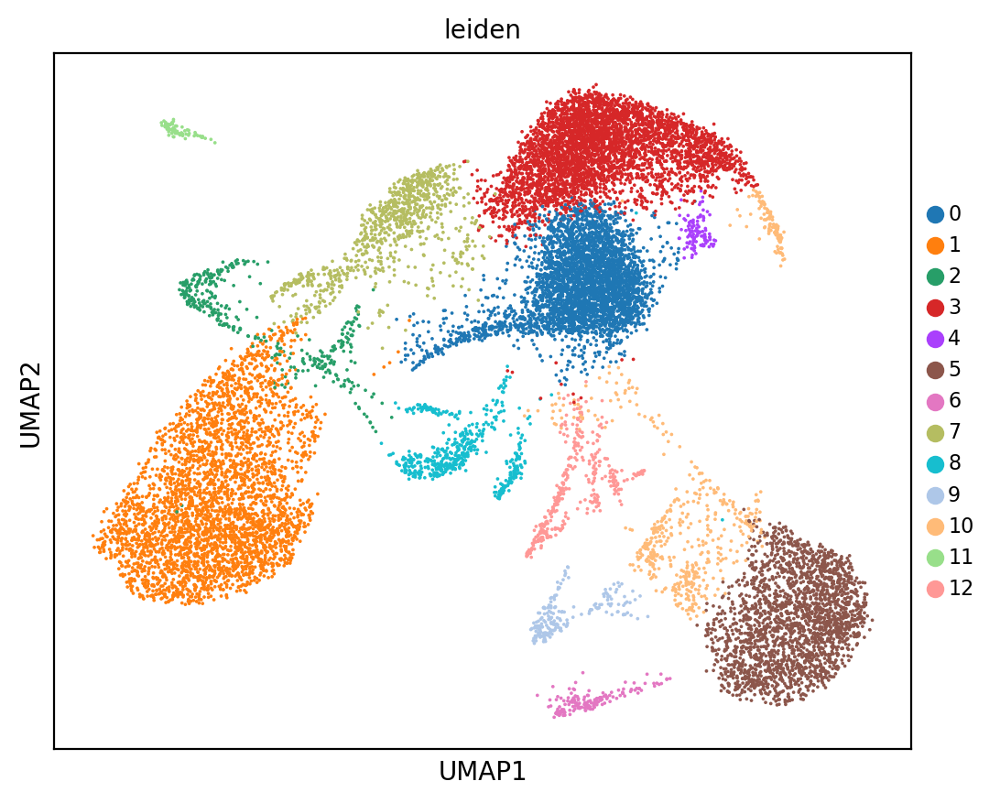

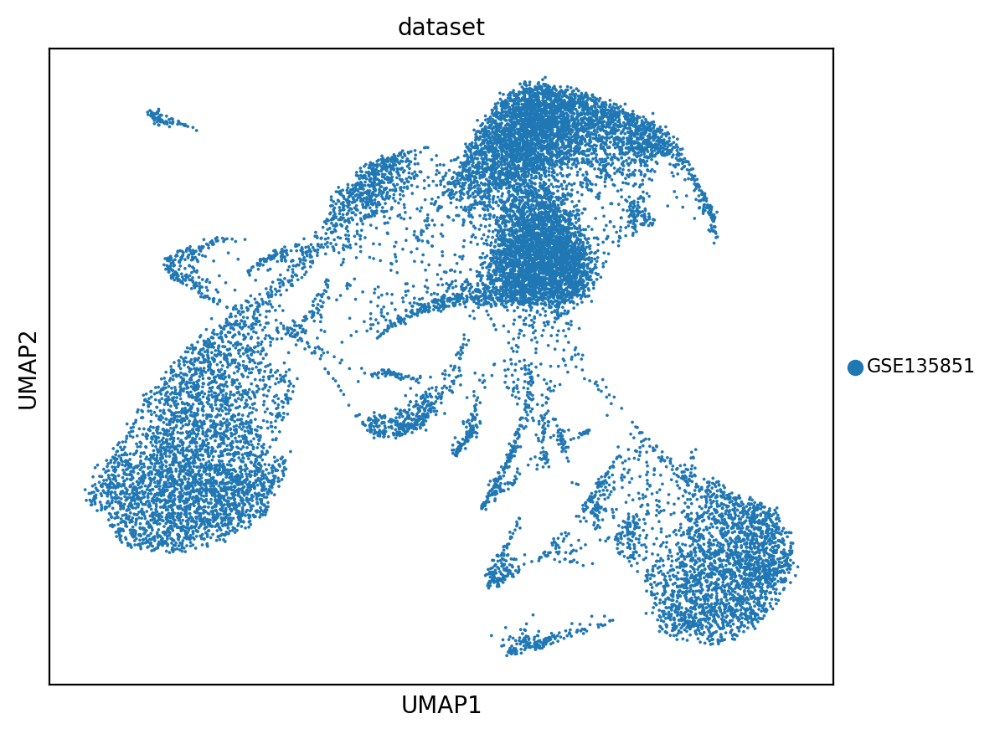

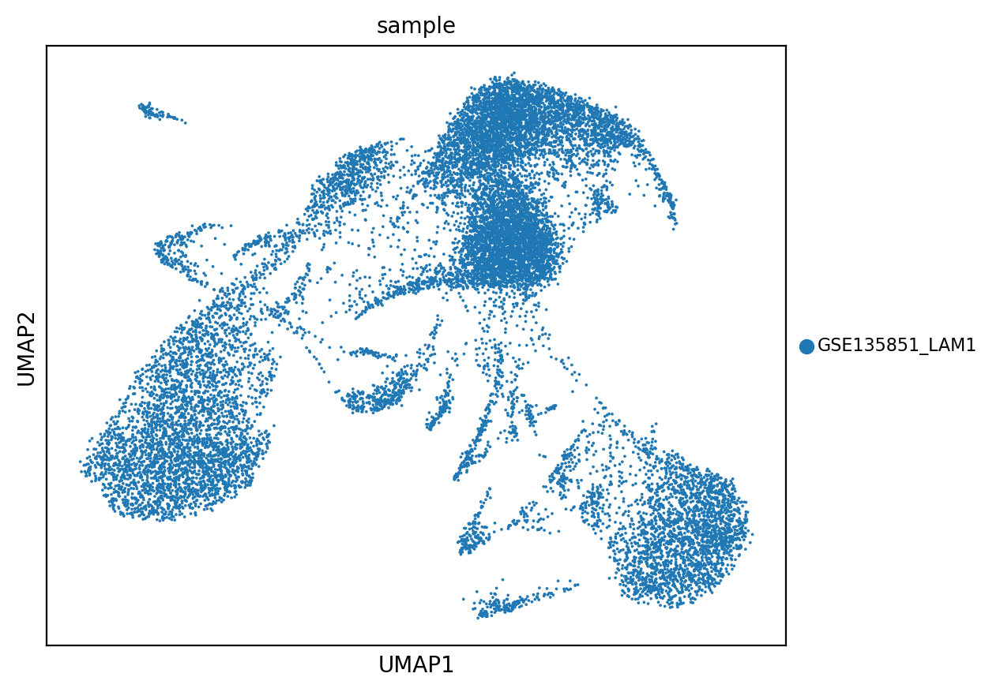

In [11]:
#| hide-input
sc.pl.umap(GSE135851_LAM1,color=['leiden'], legend_fontsize=8)
sc.pl.umap(GSE135851_LAM1,color=['dataset'], legend_fontsize=8)
sc.pl.umap(GSE135851_LAM1,color=['sample'], legend_fontsize=8)

##### UMAP showing expression of some Neutrophil markers within the population.

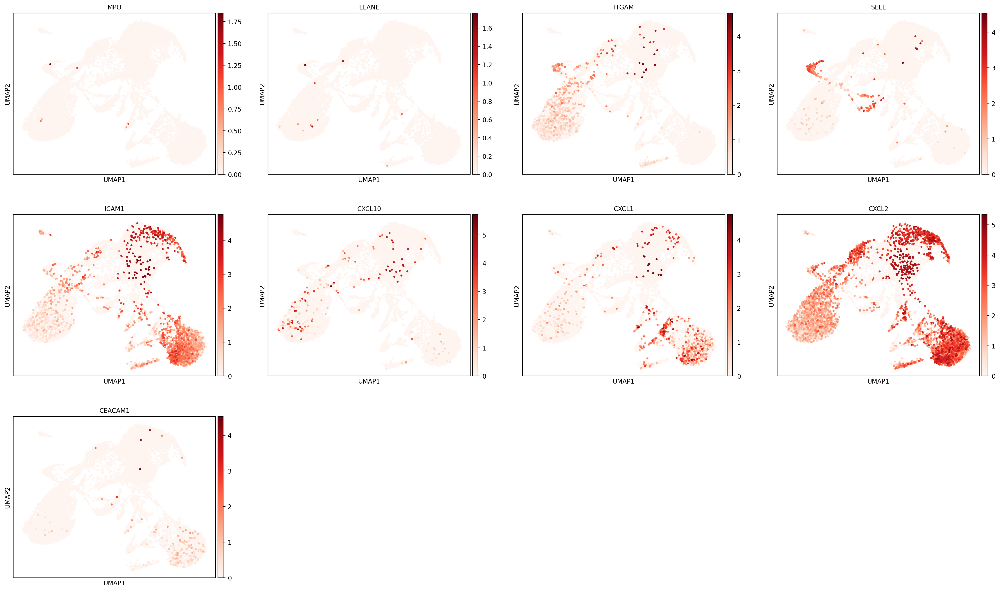

In [12]:
#| hide-input
## Main Neutrophil Markers
sc.pl.umap(GSE135851_LAM1,color=['MPO','ELANE','ITGAM','SELL','ICAM1','CXCL10','CXCL1','CXCL2','CEACAM1'], legend_fontsize=20, size = 40, cmap = 'Reds')

##### Dotplot showing expression of general neutrophil, N1 and N2 specific neutrophil markers.

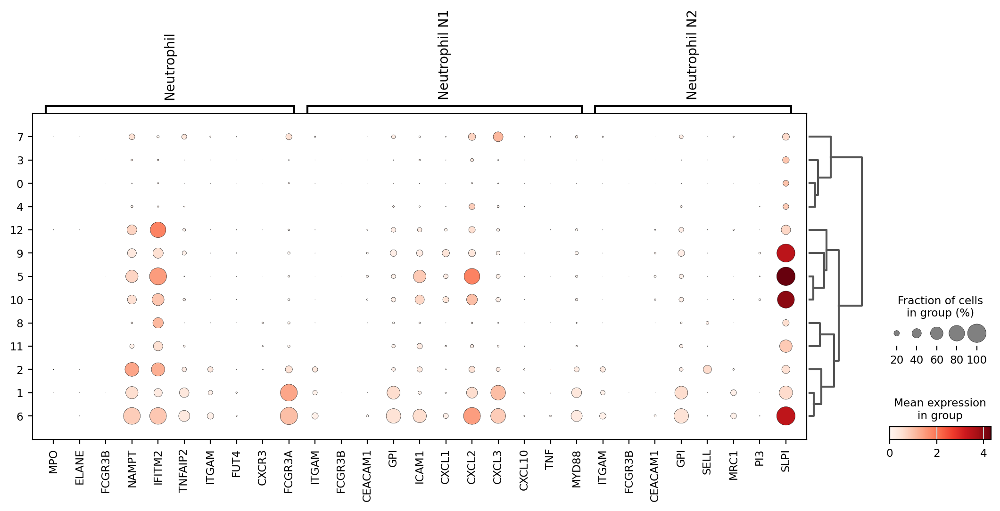

In [13]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    GSE135851_LAM1,
    marker_Neutrophil,
    groupby = ["leiden"], 
    dendrogram=True,
    use_raw=False,
    #title = 'Dotplot of Neutrophil specific markers in leiden clusters - Lam 1 Samples [GSE135851]'
)

In [14]:
#| remove-cell
GSE135851_LAM1.obs["Cell_Type"] = "Other"
GSE135851_LAM1.obs["Cell_Type"] = GSE135851_LAM1.obs["Cell_Type"].astype("category")

In [15]:
#| remove-cell
GSE135851_LAM1

AnnData object with n_obs × n_vars = 16700 × 19835
    obs: 'sample', 'dataset', 'n_genes', 'leiden', 'Cell_Type'
    var: 'gene_ids', 'n_cells'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'dendrogram_leiden', 'leiden_colors', 'dataset_colors', 'sample_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [16]:
#| hide-input
# Utility function to safely extract gene expression values
# Step 1: Subset epithelial only
GSE135851_LAM1_Neutrophil = GSE135851_LAM1.copy()

def get_gene_expression(adata, gene_name):
    """Extract expression values for a given gene safely, accounting for sparse matrices."""
    if gene_name in adata.var_names:
        gene_idx = adata.var_names.get_loc(gene_name)
        values = adata.X[:, gene_idx].toarray() if sp.issparse(adata.X) else adata.X[:, gene_idx]
        return values.flatten()
    else:
        print(f"Warning: Gene {gene_name} not found in dataset.")
        return np.zeros(adata.shape[0])

#Neutrophil
MPO_values = get_gene_expression(GSE135851_LAM1_Neutrophil, 'MPO')
ELANE_values = get_gene_expression(GSE135851_LAM1_Neutrophil, 'ELANE')

if "Neutrophil MPO+" not in GSE135851_LAM1_Neutrophil.obs["Cell_Type"].cat.categories:
    GSE135851_LAM1_Neutrophil.obs["Cell_Type"] = GSE135851_LAM1_Neutrophil.obs["Cell_Type"].cat.add_categories(["Neutrophil MPO+"]) 

neutrophil_mask = (MPO_values > 0.001)
GSE135851_LAM1_Neutrophil.obs.loc[neutrophil_mask, 'Cell_Type'] = "Neutrophil MPO+"

GSE135851_LAM1_Neutrophil.obs["Cell_Type"] = GSE135851_LAM1_Neutrophil.obs["Cell_Type"].astype("category")

print(GSE135851_LAM1_Neutrophil.obs['Cell_Type'].value_counts())

Cell_Type
Other              16693
Neutrophil MPO+        7
Name: count, dtype: int64


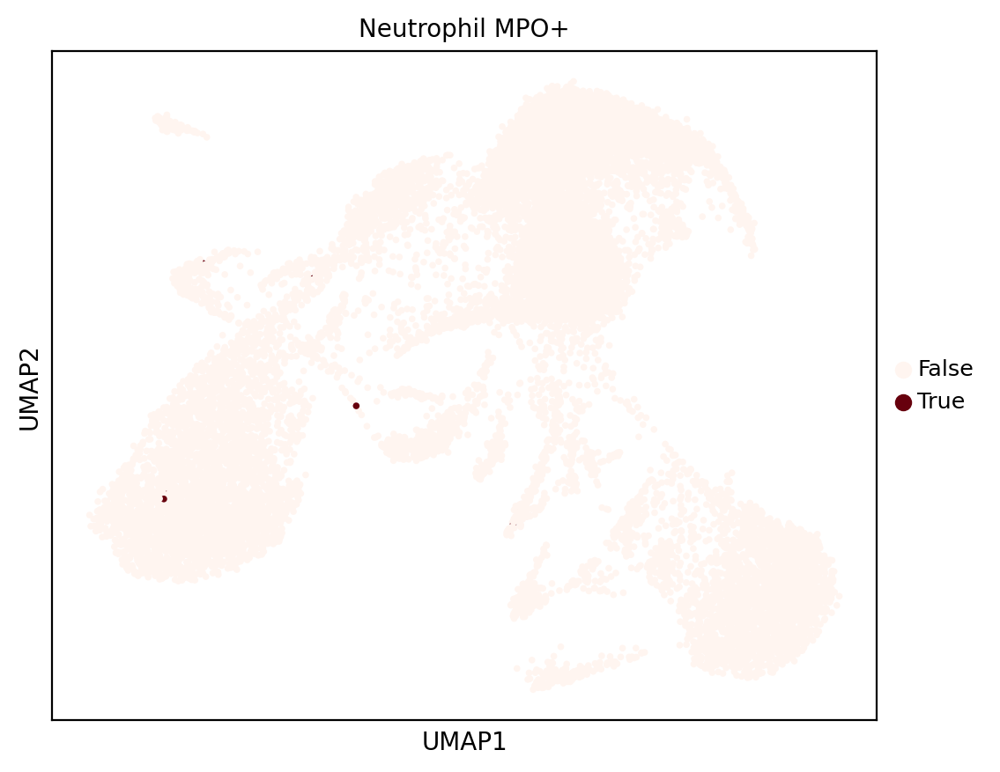

In [17]:
#| hide-input
GSE135851_LAM1_Neutrophil.obs['NP_Only'] = GSE135851_LAM1_Neutrophil.obs['Cell_Type'] == 'Neutrophil MPO+'
sc.pl.umap(GSE135851_LAM1_Neutrophil, color='NP_Only', palette = 'Reds', size = 30, title = 'Neutrophil MPO+')

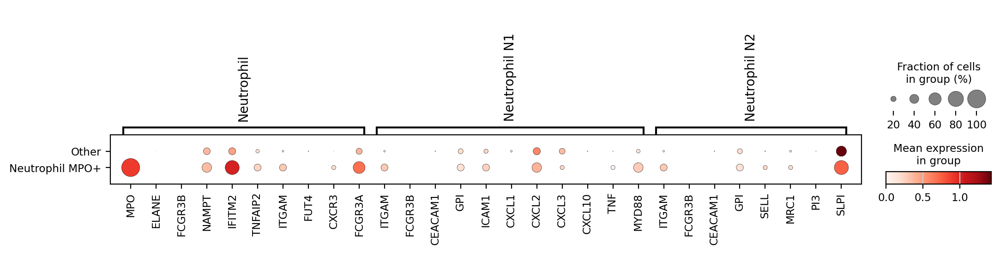

In [18]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    GSE135851_LAM1_Neutrophil,
    marker_Neutrophil,
    groupby = ["Cell_Type"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - Lam 1 Samples [GSE135851]'
)

#### LAM2

In [19]:
#| remove-cell
GSE135851_LAM2.obs['sample'] = "GSE135851_LAM2"
GSE135851_LAM2.obs['dataset'] = "GSE135851"

In [20]:
#| remove-cell
GSE135851_LAM2

AnnData object with n_obs × n_vars = 737280 × 32738
    obs: 'sample', 'dataset'
    var: 'gene_ids'

In [21]:
#| remove-cell
sc.pp.filter_cells(GSE135851_LAM2, min_genes=75)
sc.pp.filter_cells(GSE135851_LAM2, max_genes=7500)
sc.pp.filter_genes(GSE135851_LAM2, min_cells=3)

# Returns the dimensions of the expression matrix (cells, genes)
GSE135851_LAM2.shape

(37436, 19170)

In [22]:
#| remove-cell
sc.pp.normalize_total(GSE135851_LAM2, target_sum=1e4)
sc.pp.log1p(GSE135851_LAM2)

In [23]:
#| remove-cell
sc.pp.neighbors(GSE135851_LAM2)
sc.tl.umap(GSE135851_LAM2)
sc.tl.leiden(GSE135851_LAM2,flavor = "igraph", resolution=0.5, n_iterations = 2)
sc.tl.dendrogram(GSE135851_LAM2, groupby = "leiden")

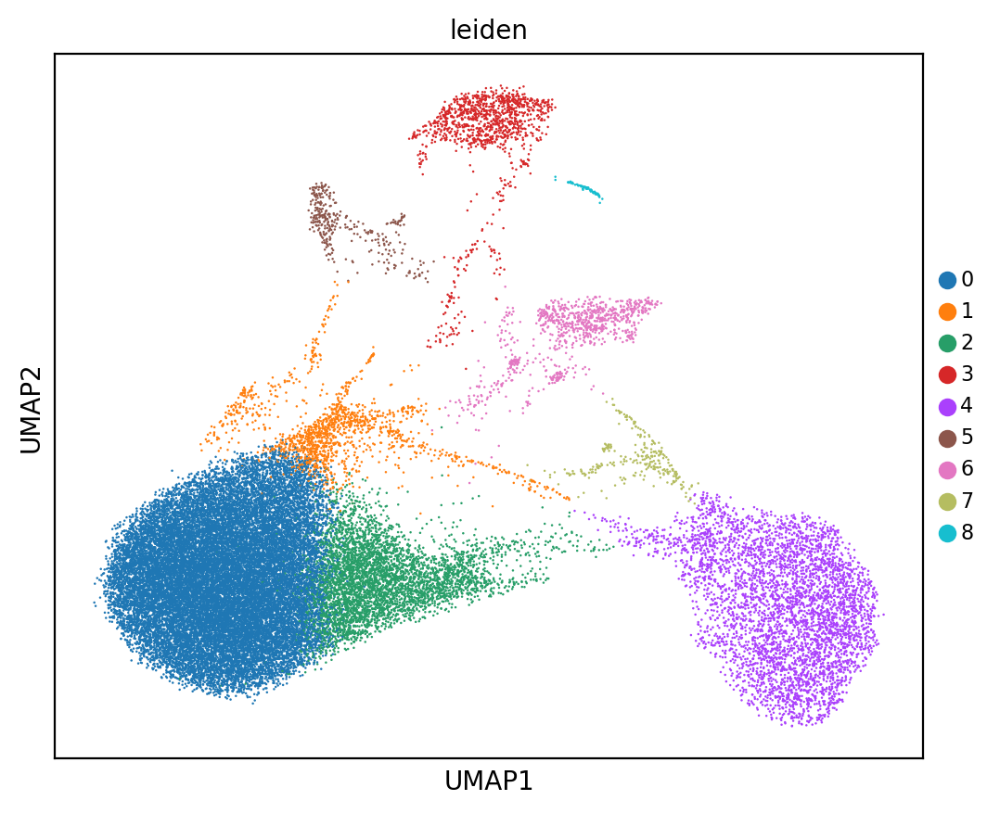

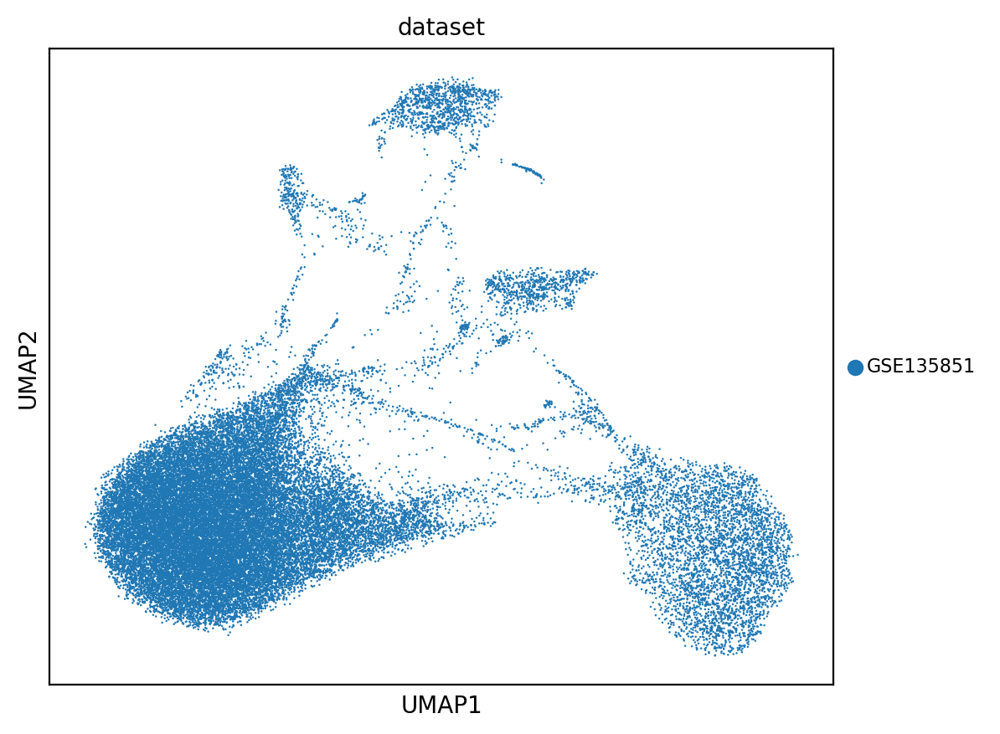

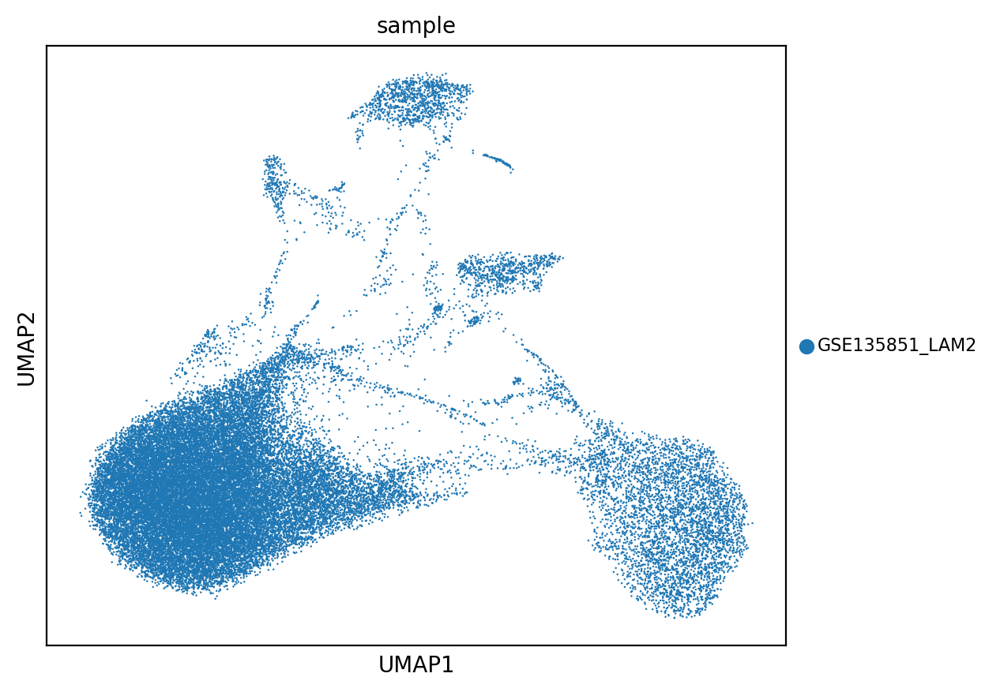

In [24]:
#| hide-input
sc.pl.umap(GSE135851_LAM2,color=['leiden'], legend_fontsize=8)
sc.pl.umap(GSE135851_LAM2,color=['dataset'], legend_fontsize=8)
sc.pl.umap(GSE135851_LAM2,color=['sample'], legend_fontsize=8)

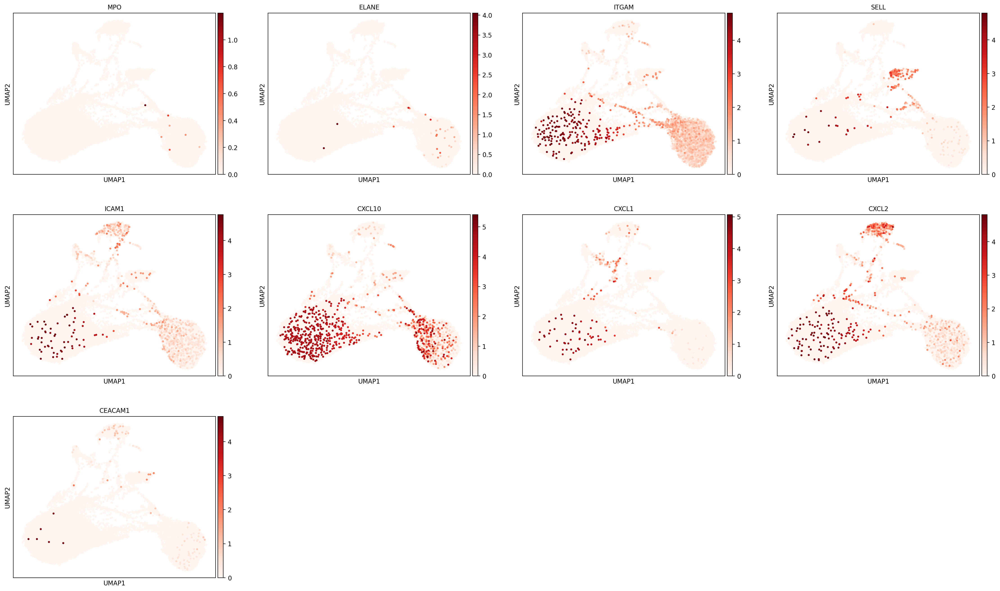

In [25]:
#| hide-input
## Main Neutrophil Markers
sc.pl.umap(GSE135851_LAM2,color=['MPO','ELANE','ITGAM','SELL','ICAM1','CXCL10','CXCL1','CXCL2','CEACAM1'], legend_fontsize=20, size = 40, cmap = 'Reds')

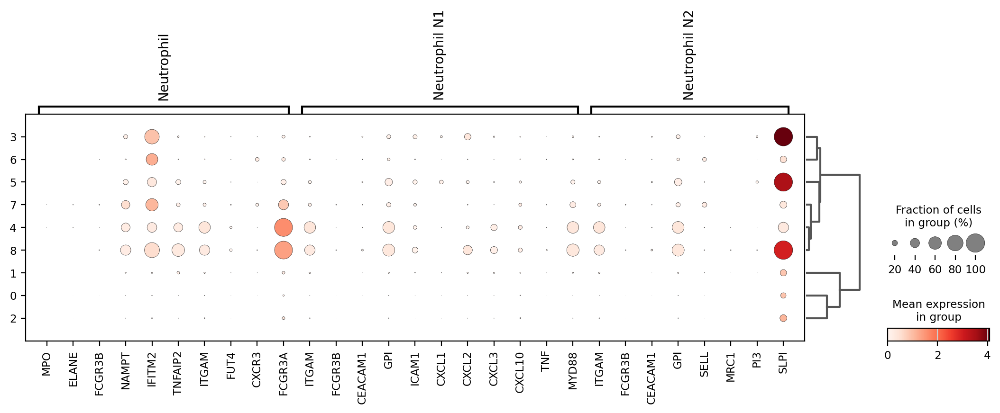

In [26]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    GSE135851_LAM2,
    marker_Neutrophil,
    groupby = ["leiden"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - LAM 2 Samples [GSE135851]'
)

In [27]:
#| remove-cell
GSE135851_LAM2.obs["Cell_Type"] = "Other"
GSE135851_LAM2.obs["Cell_Type"] = GSE135851_LAM2.obs["Cell_Type"].astype("category")

In [28]:
#| remove-cell
GSE135851_LAM2

AnnData object with n_obs × n_vars = 37436 × 19170
    obs: 'sample', 'dataset', 'n_genes', 'leiden', 'Cell_Type'
    var: 'gene_ids', 'n_cells'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'dendrogram_leiden', 'leiden_colors', 'dataset_colors', 'sample_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [29]:
#| hide-input
# Utility function to safely extract gene expression values
# Step 1: Subset epithelial only
GSE135851_LAM2_Neutrophil = GSE135851_LAM2.copy()

def get_gene_expression(adata, gene_name):
    """Extract expression values for a given gene safely, accounting for sparse matrices."""
    if gene_name in adata.var_names:
        gene_idx = adata.var_names.get_loc(gene_name)
        values = adata.X[:, gene_idx].toarray() if sp.issparse(adata.X) else adata.X[:, gene_idx]
        return values.flatten()
    else:
        print(f"Warning: Gene {gene_name} not found in dataset.")
        return np.zeros(adata.shape[0])

#Neutrophil
MPO_values = get_gene_expression(GSE135851_LAM2_Neutrophil, 'MPO')
ELANE_values = get_gene_expression(GSE135851_LAM2_Neutrophil, 'ELANE')

if "Neutrophil MPO+" not in GSE135851_LAM2_Neutrophil.obs["Cell_Type"].cat.categories:
    GSE135851_LAM2_Neutrophil.obs["Cell_Type"] = GSE135851_LAM2_Neutrophil.obs["Cell_Type"].cat.add_categories(["Neutrophil MPO+"]) 

neutrophil_mask = (MPO_values > 0.001)
GSE135851_LAM2_Neutrophil.obs.loc[neutrophil_mask, 'Cell_Type'] = "Neutrophil MPO+"

GSE135851_LAM2_Neutrophil.obs["Cell_Type"] = GSE135851_LAM2_Neutrophil.obs["Cell_Type"].astype("category")

print(GSE135851_LAM2_Neutrophil.obs['Cell_Type'].value_counts())

Cell_Type
Other              37429
Neutrophil MPO+        7
Name: count, dtype: int64


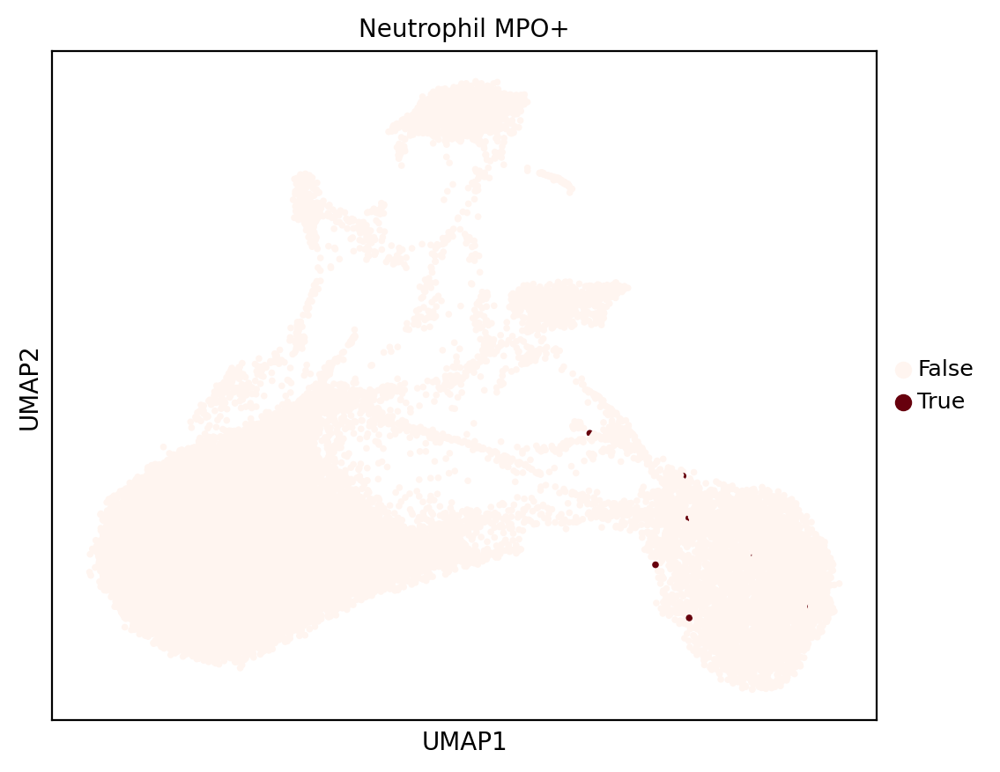

In [30]:
#| hide-input
GSE135851_LAM2_Neutrophil.obs['NP_Only'] = GSE135851_LAM2_Neutrophil.obs['Cell_Type'] == 'Neutrophil MPO+'
sc.pl.umap(GSE135851_LAM2_Neutrophil, color='NP_Only', palette = 'Reds', size = 30, title = 'Neutrophil MPO+')

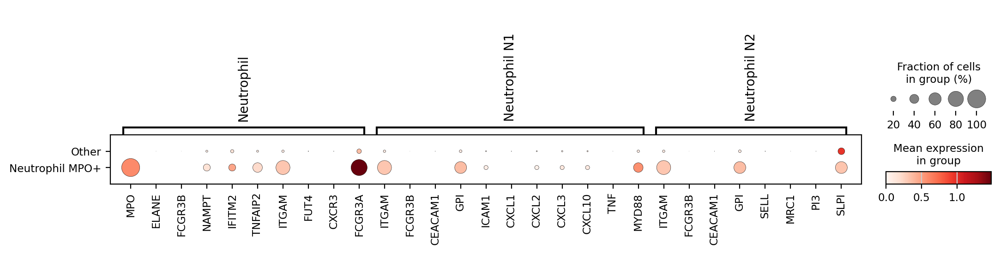

In [31]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    GSE135851_LAM2_Neutrophil,
    marker_Neutrophil,
    groupby = ["Cell_Type"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - Lam 2 Samples [GSE135851]'
)

#### LAM3

In [32]:
#| remove-cell
GSE135851_LAM3.obs['sample'] = "GSE135851_LAM3"
GSE135851_LAM3.obs['dataset'] = "GSE135851"

In [33]:
#| remove-cell
GSE135851_LAM3

AnnData object with n_obs × n_vars = 737280 × 32738
    obs: 'sample', 'dataset'
    var: 'gene_ids'

In [34]:
#| remove-cell
sc.pp.filter_cells(GSE135851_LAM3, min_genes=75)
sc.pp.filter_cells(GSE135851_LAM3, max_genes=7500)
sc.pp.filter_genes(GSE135851_LAM3, min_cells=3)

# Returns the dimensions of the expression matrix (cells, genes)
GSE135851_LAM3.shape

(57957, 19252)

In [35]:
#| remove-cell
sc.pp.normalize_total(GSE135851_LAM3, target_sum=1e4)
sc.pp.log1p(GSE135851_LAM3)

In [36]:
#| remove-cell
sc.pp.neighbors(GSE135851_LAM3)
sc.tl.umap(GSE135851_LAM3)
sc.tl.leiden(GSE135851_LAM3,flavor = "igraph", resolution=0.5, n_iterations = 2)
sc.tl.dendrogram(GSE135851_LAM3, groupby = "leiden")

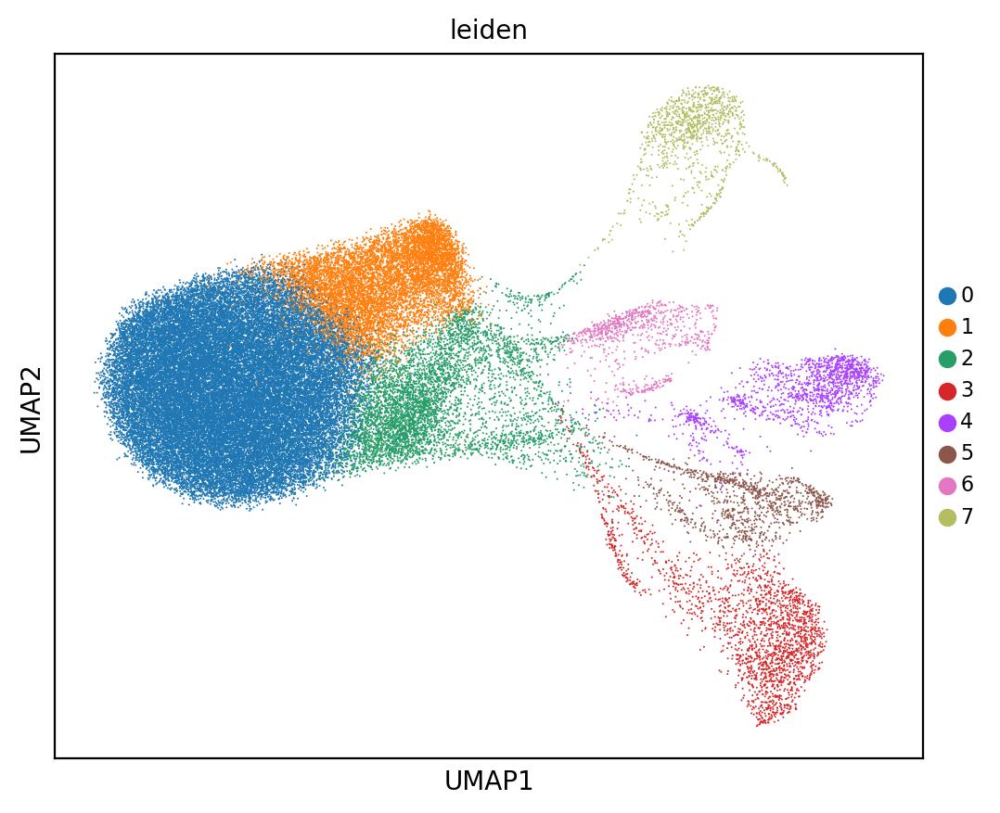

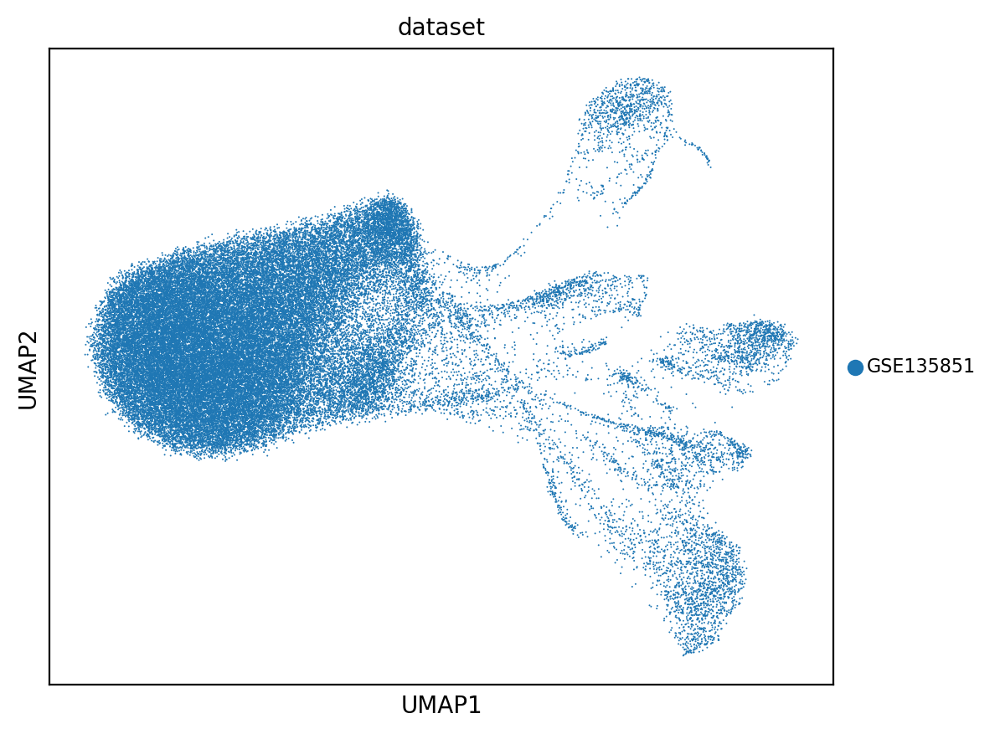

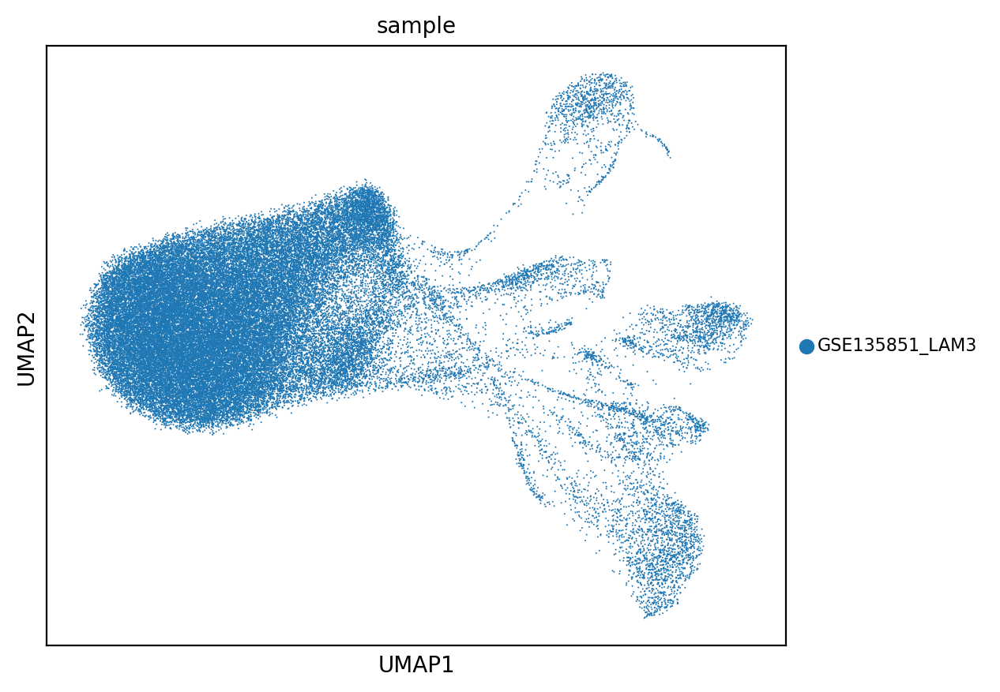

In [37]:
#| hide-input
sc.pl.umap(GSE135851_LAM3,color=['leiden'], legend_fontsize=8)
sc.pl.umap(GSE135851_LAM3,color=['dataset'], legend_fontsize=8)
sc.pl.umap(GSE135851_LAM3,color=['sample'], legend_fontsize=8)

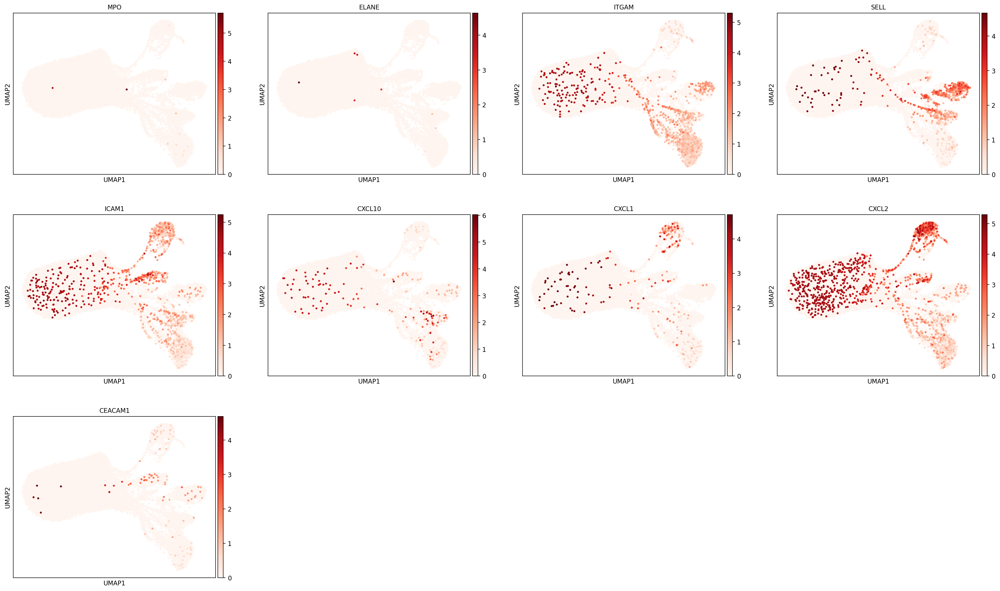

In [38]:
#| hide-input
sc.pl.umap(GSE135851_LAM3,color=['MPO','ELANE','ITGAM','SELL','ICAM1','CXCL10','CXCL1','CXCL2','CEACAM1'], legend_fontsize=20, size = 40, cmap = 'Reds')

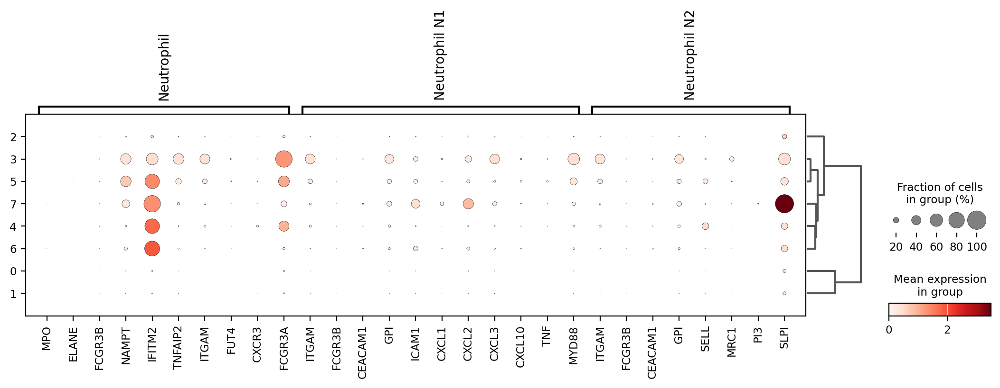

In [39]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    GSE135851_LAM3,
    marker_Neutrophil,
    groupby = ["leiden"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - LAM 2 Samples [GSE135851]'
)

In [40]:
#| remove-cell
GSE135851_LAM3.obs["Cell_Type"] = "Other"
GSE135851_LAM3.obs["Cell_Type"] = GSE135851_LAM3.obs["Cell_Type"].astype("category")

In [41]:
#| remove-cell
GSE135851_LAM3

AnnData object with n_obs × n_vars = 57957 × 19252
    obs: 'sample', 'dataset', 'n_genes', 'leiden', 'Cell_Type'
    var: 'gene_ids', 'n_cells'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'dendrogram_leiden', 'leiden_colors', 'dataset_colors', 'sample_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [42]:
#| hide-input
# Utility function to safely extract gene expression values
# Step 1: Subset epithelial only
GSE135851_LAM3_Neutrophil = GSE135851_LAM3.copy()

def get_gene_expression(adata, gene_name):
    """Extract expression values for a given gene safely, accounting for sparse matrices."""
    if gene_name in adata.var_names:
        gene_idx = adata.var_names.get_loc(gene_name)
        values = adata.X[:, gene_idx].toarray() if sp.issparse(adata.X) else adata.X[:, gene_idx]
        return values.flatten()
    else:
        print(f"Warning: Gene {gene_name} not found in dataset.")
        return np.zeros(adata.shape[0])

#Neutrophil
MPO_values = get_gene_expression(GSE135851_LAM3_Neutrophil, 'MPO')
ELANE_values = get_gene_expression(GSE135851_LAM3_Neutrophil, 'ELANE')

if "Neutrophil MPO+" not in GSE135851_LAM3_Neutrophil.obs["Cell_Type"].cat.categories:
    GSE135851_LAM3_Neutrophil.obs["Cell_Type"] = GSE135851_LAM3_Neutrophil.obs["Cell_Type"].cat.add_categories(["Neutrophil MPO+"]) 

neutrophil_mask = (MPO_values > 0.001)
GSE135851_LAM3_Neutrophil.obs.loc[neutrophil_mask, 'Cell_Type'] = "Neutrophil MPO+"

GSE135851_LAM3_Neutrophil.obs["Cell_Type"] = GSE135851_LAM3_Neutrophil.obs["Cell_Type"].astype("category")

print(GSE135851_LAM3_Neutrophil.obs['Cell_Type'].value_counts())

Cell_Type
Other              57943
Neutrophil MPO+       14
Name: count, dtype: int64


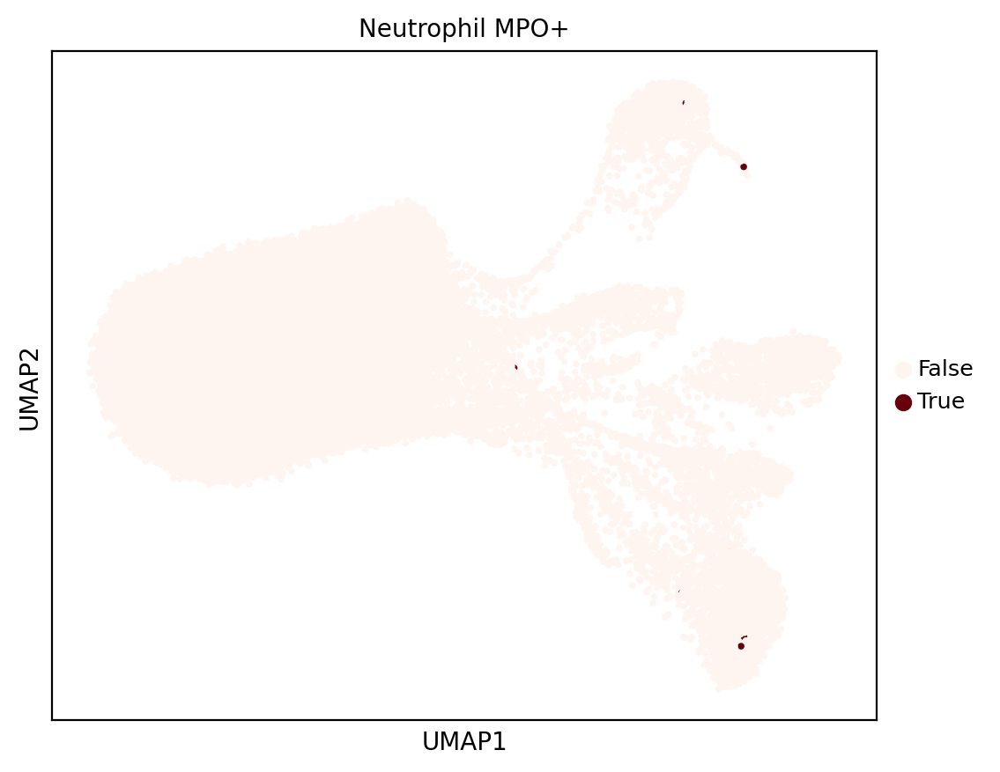

In [43]:
#| hide-input
GSE135851_LAM3_Neutrophil.obs['NP_Only'] = GSE135851_LAM3_Neutrophil.obs['Cell_Type'] == 'Neutrophil MPO+'
sc.pl.umap(GSE135851_LAM3_Neutrophil, color='NP_Only', palette = 'Reds', size = 30, title = 'Neutrophil MPO+')

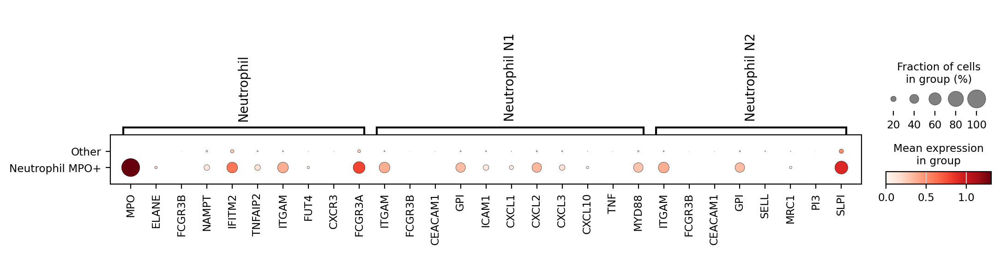

In [44]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    GSE135851_LAM3_Neutrophil,
    marker_Neutrophil,
    groupby = ["Cell_Type"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - Lam 2 Samples [GSE135851]'
)

#### LAM4
##### Removed from analysis as it didn't have any MPO+ Cells.

In [45]:
#| remove-cell
GSE135851_LAM4.obs['sample'] = "GSE135851_LAM4"
GSE135851_LAM4.obs['dataset'] = "GSE135851"

In [46]:
#| remove-cell
GSE135851_LAM4

AnnData object with n_obs × n_vars = 737280 × 63677
    obs: 'sample', 'dataset'
    var: 'gene_ids'

In [47]:
#| remove-cell
sc.pp.filter_cells(GSE135851_LAM4, min_genes=75)
sc.pp.filter_cells(GSE135851_LAM4, max_genes=7500)
sc.pp.filter_genes(GSE135851_LAM4, min_cells=3)

# Returns the dimensions of the expression matrix (cells, genes)
GSE135851_LAM4.shape

(12600, 22537)

In [48]:
#| remove-cell
sc.pp.normalize_total(GSE135851_LAM4, target_sum=1e4)
sc.pp.log1p(GSE135851_LAM4)

In [49]:
#| remove-cell
sc.pp.neighbors(GSE135851_LAM4)
sc.tl.umap(GSE135851_LAM4)
sc.tl.leiden(GSE135851_LAM4,flavor = "igraph", resolution=0.5, n_iterations = 2)
sc.tl.dendrogram(GSE135851_LAM4, groupby = "leiden")

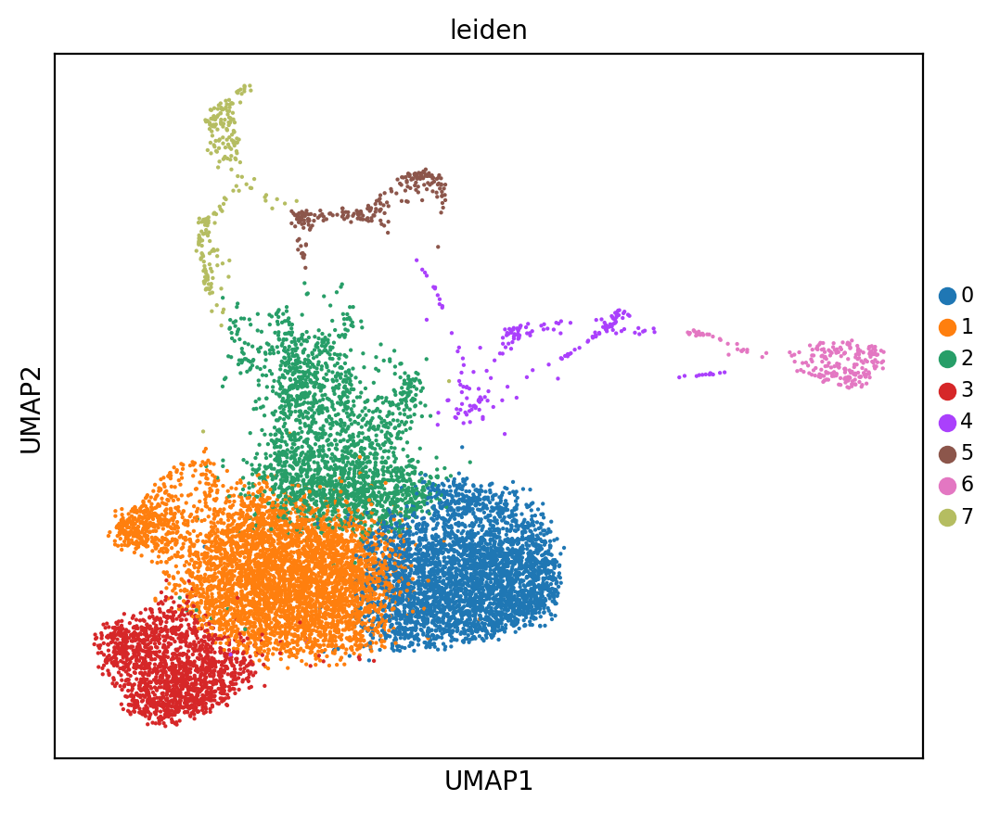

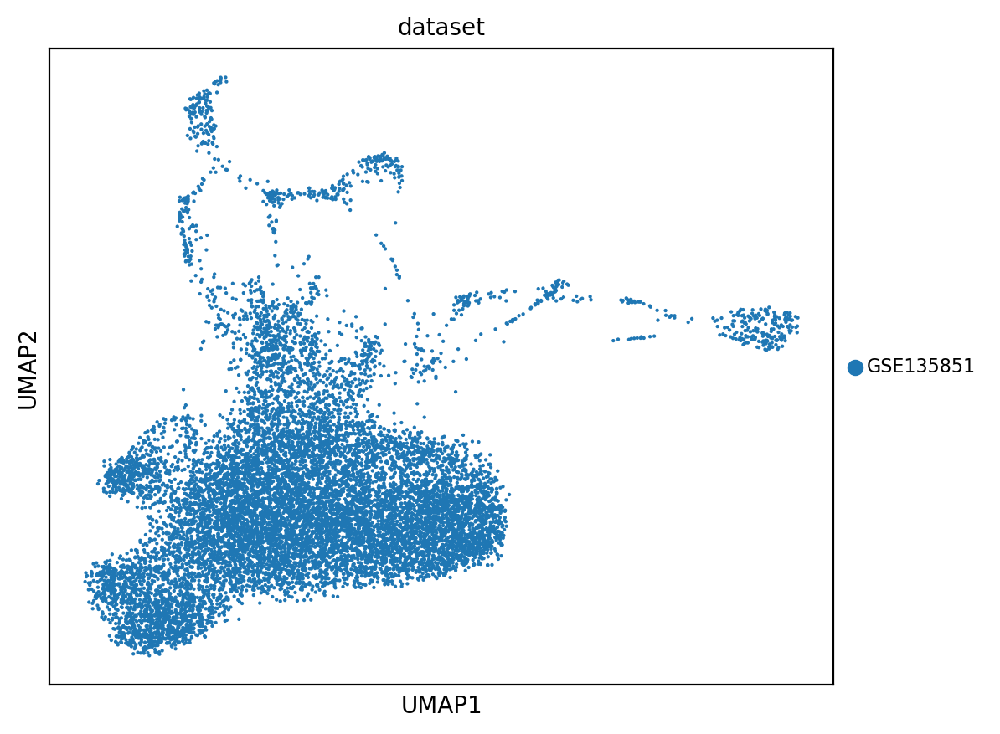

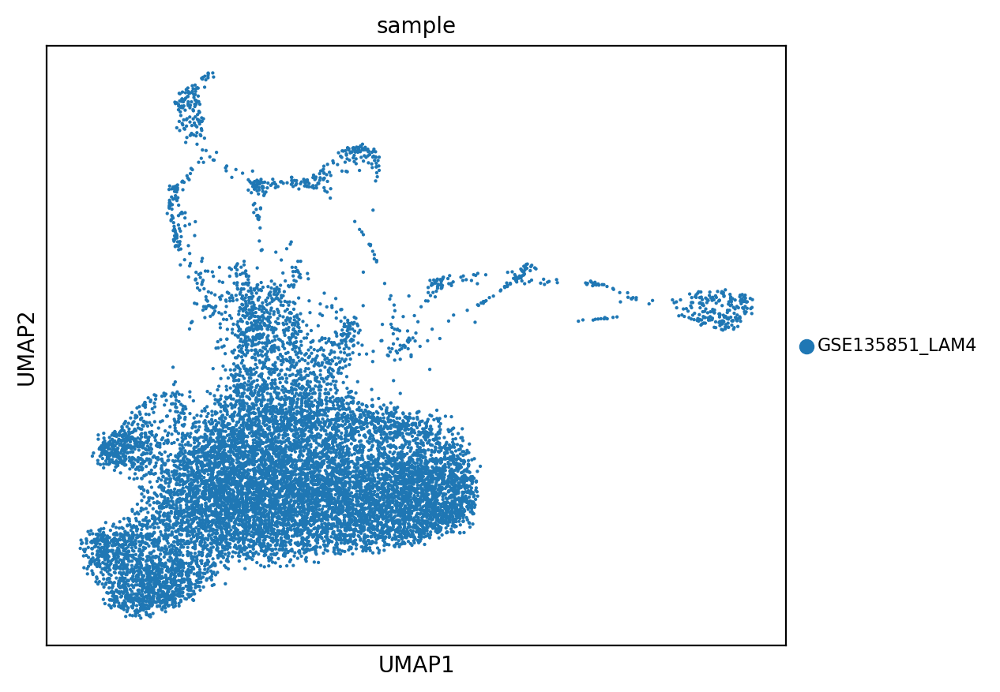

In [50]:
#| hide-input
sc.pl.umap(GSE135851_LAM4,color=['leiden'], legend_fontsize=8)
sc.pl.umap(GSE135851_LAM4,color=['dataset'], legend_fontsize=8)
sc.pl.umap(GSE135851_LAM4,color=['sample'], legend_fontsize=8)

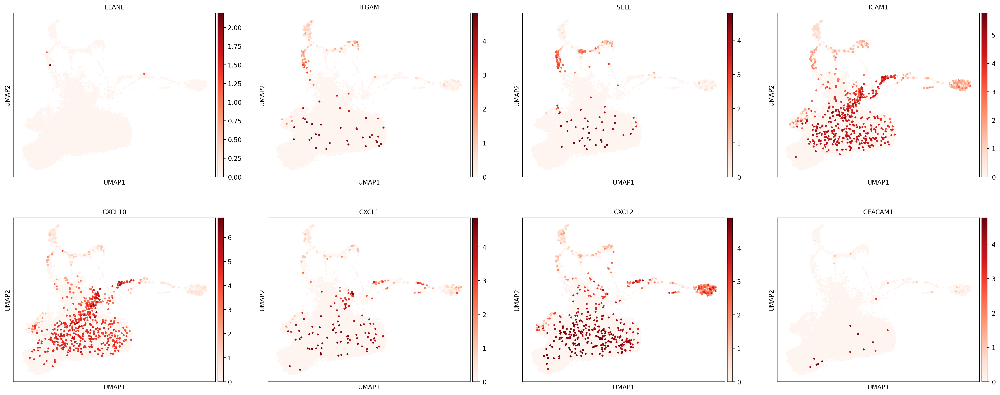

In [51]:
#| hide-input
sc.pl.umap(GSE135851_LAM4,color=['ELANE','ITGAM','SELL','ICAM1','CXCL10','CXCL1','CXCL2','CEACAM1'], legend_fontsize=20, size = 40, cmap = 'Reds')

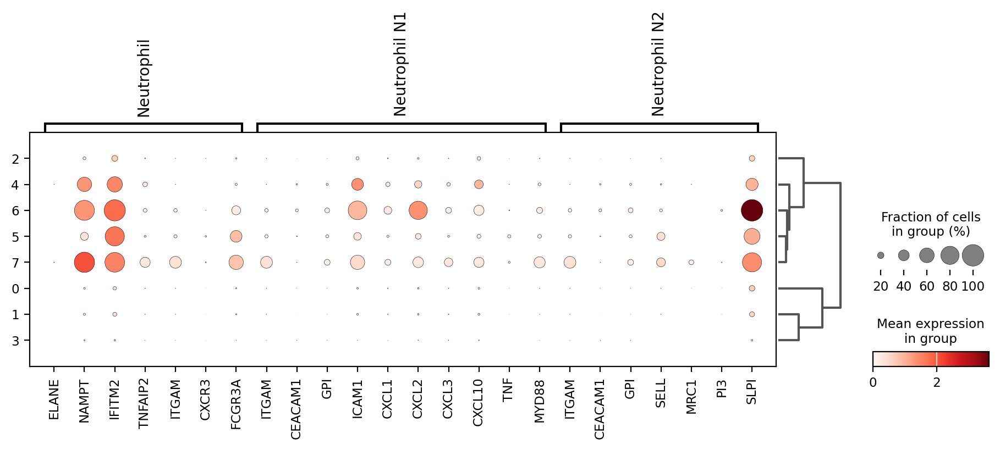

In [52]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['ELANE','NAMPT','IFITM2','TNFAIP2','ITGAM','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}
sc.pl.dotplot(
    GSE135851_LAM4,
    marker_Neutrophil,
    groupby = ["leiden"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - LAM 2 Samples [GSE135851]'
)

In [53]:
#| remove-cell
GSE135851_LAM4.obs["Cell_Type"] = "Other"
GSE135851_LAM4.obs["Cell_Type"] = GSE135851_LAM4.obs["Cell_Type"].astype("category")

In [54]:
#| remove-cell
GSE135851_LAM4

AnnData object with n_obs × n_vars = 12600 × 22537
    obs: 'sample', 'dataset', 'n_genes', 'leiden', 'Cell_Type'
    var: 'gene_ids', 'n_cells'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'dendrogram_leiden', 'leiden_colors', 'dataset_colors', 'sample_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [55]:
#| hide-input
# Utility function to safely extract gene expression values
# Step 1: Subset epithelial only
GSE135851_LAM4_Neutrophil = GSE135851_LAM4.copy()

def get_gene_expression(adata, gene_name):
    """Extract expression values for a given gene safely, accounting for sparse matrices."""
    if gene_name in adata.var_names:
        gene_idx = adata.var_names.get_loc(gene_name)
        values = adata.X[:, gene_idx].toarray() if sp.issparse(adata.X) else adata.X[:, gene_idx]
        return values.flatten()
    else:
        print(f"Warning: Gene {gene_name} not found in dataset.")
        return np.zeros(adata.shape[0])

#Neutrophil
MPO_values = get_gene_expression(GSE135851_LAM4_Neutrophil, 'MPO')
ELANE_values = get_gene_expression(GSE135851_LAM4_Neutrophil, 'ELANE')

if "Neutrophil MPO+" not in GSE135851_LAM4_Neutrophil.obs["Cell_Type"].cat.categories:
    GSE135851_LAM4_Neutrophil.obs["Cell_Type"] = GSE135851_LAM4_Neutrophil.obs["Cell_Type"].cat.add_categories(["Neutrophil MPO+"]) 

neutrophil_mask = (MPO_values > 0.001)
GSE135851_LAM4_Neutrophil.obs.loc[neutrophil_mask, 'Cell_Type'] = "Neutrophil MPO+"

GSE135851_LAM4_Neutrophil.obs["Cell_Type"] = GSE135851_LAM4_Neutrophil.obs["Cell_Type"].astype("category")

print(GSE135851_LAM4_Neutrophil.obs['Cell_Type'].value_counts())

Cell_Type
Other              12600
Neutrophil MPO+        0
Name: count, dtype: int64


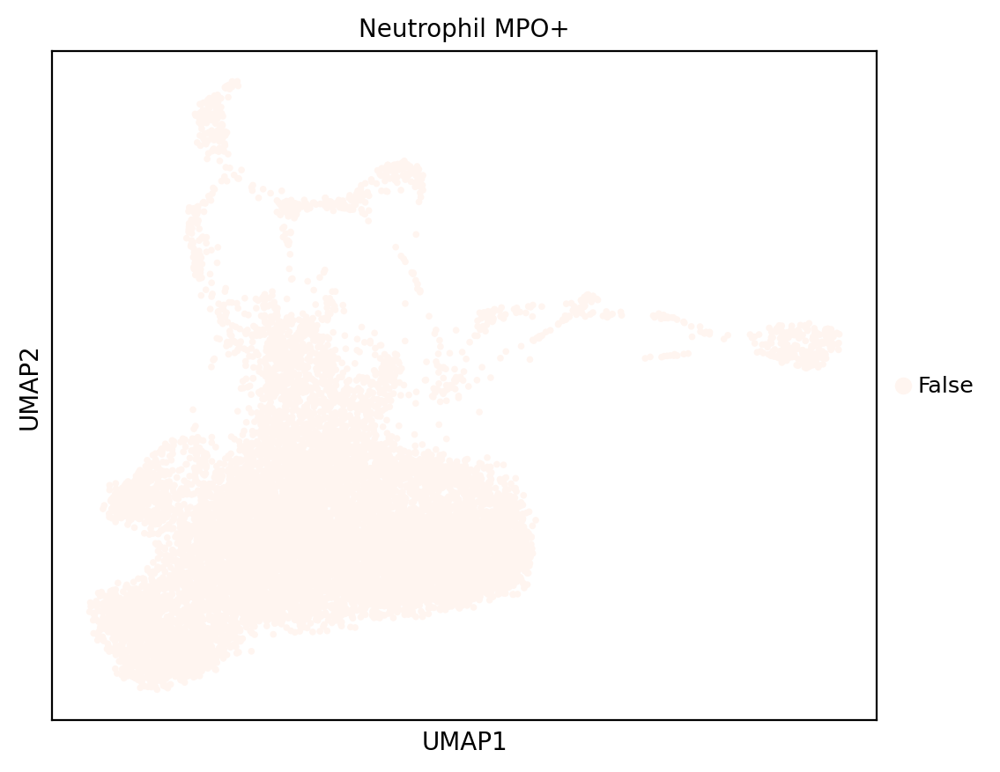

In [56]:
#| hide-input
GSE135851_LAM4_Neutrophil.obs['NP_Only'] = GSE135851_LAM4_Neutrophil.obs['Cell_Type'] == 'Neutrophil MPO+'
sc.pl.umap(GSE135851_LAM4_Neutrophil, color='NP_Only', palette = 'Reds', size = 30, title = 'Neutrophil MPO+')

### Joining Datasets for GSE135851

In [57]:
#| remove-cell
# fixed_pipeline.py
import mygene
import pandas as pd
import scanpy as sc
import numpy as np

mg = mygene.MyGeneInfo()

# =====================================
# Step 0: Collect datasets
# =====================================
datasets = {
    'GSE135851_LAM1': GSE135851_LAM1_Neutrophil,
    'GSE135851_LAM2': GSE135851_LAM2_Neutrophil,
    'GSE135851_LAM3': GSE135851_LAM3_Neutrophil
    #'GSE135851_LAM4': GSE135851_LAM4    
}

# Build reference gene set as union (keep any gene present in any dataset)
reference_genes = set().union(*(ad.var_names for ad in datasets.values()))
print(f"Reference gene set (union): {len(reference_genes)} genes")

# =====================================
# Step 1: Gene mapping
# =====================================
def build_gene_mapping(gene_list, reference_set, dataset_name):
    """
    Map Ensembl IDs, symbols, or aliases to HGNC symbols,
    prioritizing reference_set membership.

    Returns:
        mapping (dict): query -> mapped ID
        unmapped_df (pd.DataFrame): queries that could not be mapped
    """
    # Query mygene (ask for both 'ensembl.gene' and 'ensembl' to capture both formats)
    res = mg.querymany(
        list(gene_list),
        scopes=["ensembl.gene", "symbol", "alias", "ensembl"],
        fields="symbol,ensembl.gene,ensembl,alias",
        species="human",
        as_dataframe=True,
    )

    mapping = {}
    unmapped_records = []  # store info for dataframe

    # iterate rows (each query)
    for query, row in res.iterrows():
        # mygene returns a 'notfound' column for missing queries
        if isinstance(row, pd.Series) and row.get("notfound"):
            unmapped_records.append(
                {"dataset": dataset_name, "query": query, "reason": "notfound"}
            )
            continue

        # Collect all possible identifiers
        candidates = set()

        # symbol
        symbol = row.get("symbol")
        if pd.notna(symbol):
            candidates.add(symbol)

        # ensembl.gene (string or list)
        ens_gene = row.get("ensembl.gene")
        if pd.notna(ens_gene):
            if isinstance(ens_gene, list):
                candidates.update(ens_gene)
            else:
                candidates.add(ens_gene)

        # ensembl (list of dicts or single dict) -> extract 'gene' keys
        ens_full = row.get("ensembl")
        if pd.notna(ens_full):
            if isinstance(ens_full, dict) and "gene" in ens_full:
                candidates.add(ens_full["gene"])
            elif isinstance(ens_full, list):
                for entry in ens_full:
                    if isinstance(entry, dict) and "gene" in entry:
                        candidates.add(entry["gene"])

        # alias (string or list)
        aliases = row.get("alias")
        if pd.notna(aliases):
            if isinstance(aliases, list):
                candidates.update(aliases)
            else:
                candidates.add(aliases)

        # Try to match against reference set (priority)
        match = next((c for c in candidates if c in reference_set), None)

        if match:
            mapping[query] = match
        elif symbol:  # fallback: use symbol if present
            mapping[query] = symbol
        else:
            unmapped_records.append(
                {"dataset": dataset_name, "query": query, "reason": "no_match_in_reference"}
            )

    unmapped_df = pd.DataFrame(unmapped_records)
    # ensure consistent columns even if empty
    if unmapped_df.empty:
        unmapped_df = pd.DataFrame(columns=["dataset", "query", "reason"])
    return mapping, unmapped_df


# =====================================
# Step 2: Harmonize + merge duplicates
# =====================================
def harmonize_and_merge(adata, reference_set, dataset_name, merge_method="sum", convert_sparse=True):
    """
    Rename genes to reference symbols, merge duplicates.
    Returns (adata_harmonized, unmapped_df).
    Parameters:
      - merge_method: "sum" (default) or "mean"
      - convert_sparse: if True, transiently convert sparse matrix to dense for grouping;
                        if False, will try a memory-friendly sparse approach (not implemented here).
    """
    print(f"\n--- Harmonizing {dataset_name} ---")
    mapping, unmapped_df = build_gene_mapping(adata.var_names, reference_set, dataset_name)

    # Keep a copy of original var names
    adata.var["old_names"] = adata.var_names

    # Apply mapping (map queries to mapped name or keep original)
    new_names = adata.var_names.to_series().map(lambda g: mapping.get(g, g))
    adata.var_names = new_names

    # If duplicates exist, merge them
    if adata.var_names.has_duplicates:
        ndup = adata.var_names.duplicated().sum()
        print(f"{dataset_name}: {ndup} duplicate gene names detected → merging ({merge_method})")

        # Convert to dense carefully — only if requested and if size allows
        if convert_sparse and hasattr(adata.X, "toarray"):
            X = adata.X.T.toarray()  # genes x cells
        else:
            # fallback to numpy conversion (may still be large)
            X = np.asarray(adata.X.T)

        # Create DataFrame with genes x cells
        df = pd.DataFrame(X, index=adata.var_names, columns=adata.obs_names)

        # Group by gene name and aggregate
        if merge_method == "sum":
            df2 = df.groupby(df.index).sum()
        elif merge_method == "mean":
            df2 = df.groupby(df.index).mean()
        else:
            raise ValueError("merge_method must be 'sum' or 'mean'")

        # Re-create AnnData (cells x genes)
        adata = sc.AnnData(df2.T, obs=adata.obs.copy())
        adata.var_names = df2.index
        adata.var_names.name = None

    # Final sanity-check: ensure var_names are strings
    adata.var_names = adata.var_names.astype(str)

    print(f"{dataset_name}: {adata.n_vars} genes after harmonization")
    return adata, unmapped_df


# =====================================
# Step 3: Apply harmonization & track unmapped
# =====================================
all_unmapped_list = []
harmonized_datasets = {}

for name, ad in datasets.items():
    adata_harmonized, unmapped_df = harmonize_and_merge(ad.copy(), reference_genes, name)
    harmonized_datasets[name] = adata_harmonized
    all_unmapped_list.append(unmapped_df)

# Concatenate unmapped into one DataFrame
all_unmapped = pd.concat(all_unmapped_list, ignore_index=True)

# =====================================
# Step 4: Concatenate (intersection or union as desired)
# =====================================
# Use join="outer" for union, "inner" for intersection across datasets
GSE135851_LAM = sc.concat(
    list(harmonized_datasets.values()),
    join="outer",
    label="dataset",
    keys=list(harmonized_datasets.keys()),
)

print("\nFinal concatenated AnnData:")
print(f"Shape: {GSE135851_LAM.shape}")   # (cells, genes)

# Show unmapped summary
print("\n⚠️ Unmapped genes summary:")
display(all_unmapped.head())


Input sequence provided is already in string format. No operation performed
querying 1-1000 ...


Reference gene set (union): 21030 genes

--- Harmonizing GSE135851_LAM1 ---


querying 1001-2000 ...
querying 2001-3000 ...
querying 3001-4000 ...
querying 4001-5000 ...
querying 5001-6000 ...
querying 6001-7000 ...
querying 7001-8000 ...
querying 8001-9000 ...
querying 9001-10000 ...
querying 10001-11000 ...
querying 11001-12000 ...
querying 12001-13000 ...
querying 13001-14000 ...
querying 14001-15000 ...
querying 15001-16000 ...
querying 16001-17000 ...
querying 17001-18000 ...
querying 18001-19000 ...
querying 19001-19835 ...
Finished.
1038 input query terms found dup hits:	[('LINC00115', 2), ('DVL1', 2), ('SLC35E2', 2), ('CHD5', 4), ('PLEKHG5', 2), ('PIK3CD', 2), ('PGD', 
3292 input query terms found no hit:	['RP11-34P13.7', 'AL627309.1', 'AP006222.2', 'RP4-669L17.10', 'RP11-206L10.3', 'RP11-206L10.2', 'RP1
Pass "returnall=True" to return complete lists of duplicate or missing query terms.
Input sequence provided is already in string format. No operation performed
querying 1-1000 ...


GSE135851_LAM1: 19835 genes after harmonization

--- Harmonizing GSE135851_LAM2 ---


querying 1001-2000 ...
querying 2001-3000 ...
querying 3001-4000 ...
querying 4001-5000 ...
querying 5001-6000 ...
querying 6001-7000 ...
querying 7001-8000 ...
querying 8001-9000 ...
querying 9001-10000 ...
querying 10001-11000 ...
querying 11001-12000 ...
querying 12001-13000 ...
querying 13001-14000 ...
querying 14001-15000 ...
querying 15001-16000 ...
querying 16001-17000 ...
querying 17001-18000 ...
querying 18001-19000 ...
querying 19001-19170 ...
Finished.
1015 input query terms found dup hits:	[('LINC00115', 2), ('DVL1', 2), ('SLC35E2', 2), ('PLEKHG5', 2), ('PIK3CD', 2), ('PGD', 2), ('APITD1'
3030 input query terms found no hit:	['RP11-34P13.7', 'AL627309.1', 'AP006222.2', 'RP4-669L17.10', 'RP11-206L10.3', 'RP11-206L10.2', 'RP1
Pass "returnall=True" to return complete lists of duplicate or missing query terms.
Input sequence provided is already in string format. No operation performed
querying 1-1000 ...


GSE135851_LAM2: 19170 genes after harmonization

--- Harmonizing GSE135851_LAM3 ---


querying 1001-2000 ...
querying 2001-3000 ...
querying 3001-4000 ...
querying 4001-5000 ...
querying 5001-6000 ...
querying 6001-7000 ...
querying 7001-8000 ...
querying 8001-9000 ...
querying 9001-10000 ...
querying 10001-11000 ...
querying 11001-12000 ...
querying 12001-13000 ...
querying 13001-14000 ...
querying 14001-15000 ...
querying 15001-16000 ...
querying 16001-17000 ...
querying 17001-18000 ...
querying 18001-19000 ...
querying 19001-19252 ...
Finished.
1021 input query terms found dup hits:	[('LINC00115', 2), ('DVL1', 2), ('SLC35E2', 2), ('CHD5', 4), ('PLEKHG5', 2), ('PIK3CD', 2), ('PGD', 
2992 input query terms found no hit:	['RP11-34P13.7', 'AL627309.1', 'AP006222.2', 'RP4-669L17.10', 'RP11-206L10.3', 'RP11-206L10.2', 'RP1
Pass "returnall=True" to return complete lists of duplicate or missing query terms.


GSE135851_LAM3: 19252 genes after harmonization

Final concatenated AnnData:
Shape: (112093, 21030)

⚠️ Unmapped genes summary:


,dataset,query,reason
0,GSE135851_LAM1,RP11-34P13.7,notfound
1,GSE135851_LAM1,AL627309.1,notfound
2,GSE135851_LAM1,AP006222.2,notfound
3,GSE135851_LAM1,RP4-669L17.10,notfound
4,GSE135851_LAM1,RP11-206L10.3,notfound


In [58]:
#| remove-cell
GSE135851_LAM

AnnData object with n_obs × n_vars = 112093 × 21030
    obs: 'sample', 'dataset', 'n_genes', 'leiden', 'Cell_Type', 'NP_Only'
    obsm: 'X_pca', 'X_umap'

In [59]:
#| remove-cell
GSE135851_LAM.obs['sample'].value_counts()

sample
GSE135851_LAM3    57957
GSE135851_LAM2    37436
GSE135851_LAM1    16700
Name: count, dtype: int64

In [60]:
#| remove-cell
GSE135851_LAM.obs['dataset'].value_counts()

dataset
GSE135851_LAM3    57957
GSE135851_LAM2    37436
GSE135851_LAM1    16700
Name: count, dtype: int64

In [61]:
#| remove-cell
# Run PCA
#sc.pp.scale(AT2_HLCA)                # optional but recommended
sc.tl.pca(GSE135851_LAM, svd_solver="arpack")

sce.pp.harmony_integrate(GSE135851_LAM, key = 'dataset')
'X_pca_harmony' in GSE135851_LAM.obsm
True

2026-01-19 17:15:19,619 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
Computing initial centroids with sklearn.KMeans...
2026-01-19 17:15:22,290 - harmonypy - INFO - sklearn.KMeans initialization complete.
sklearn.KMeans initialization complete.
2026-01-19 17:15:22,504 - harmonypy - INFO - Iteration 1 of 10
Iteration 1 of 10
2026-01-19 17:15:42,776 - harmonypy - INFO - Iteration 2 of 10
Iteration 2 of 10
2026-01-19 17:16:06,778 - harmonypy - INFO - Iteration 3 of 10
Iteration 3 of 10
2026-01-19 17:16:22,648 - harmonypy - INFO - Converged after 3 iterations
Converged after 3 iterations


True

In [62]:
#| remove-cell
print(f"Total counts in lcc_h_filt: {GSE135851_LAM.X.sum()}")

Total counts in lcc_h_filt: 90259096.0


In [63]:
#| remove-cell
sc.pp.normalize_total(GSE135851_LAM, target_sum=1e4)
sc.pp.log1p(GSE135851_LAM)

#if sp.issparse(AT2_HLCA.X):
#    AT2_HLCA.X = AT2_HLCA.X.toarray()  # Convert sparse to dense matrix
#AT2_HLCA.X.shape

GSE135851_LAM.obsm['X_pca'] = GSE135851_LAM.obsm['X_pca_harmony']

In [64]:
#| remove-cell
sc.pp.neighbors(GSE135851_LAM)
sc.tl.umap(GSE135851_LAM)
sc.tl.leiden(GSE135851_LAM,flavor = "igraph", resolution=0.5, n_iterations = 2)
sc.tl.dendrogram(GSE135851_LAM, groupby = "leiden")

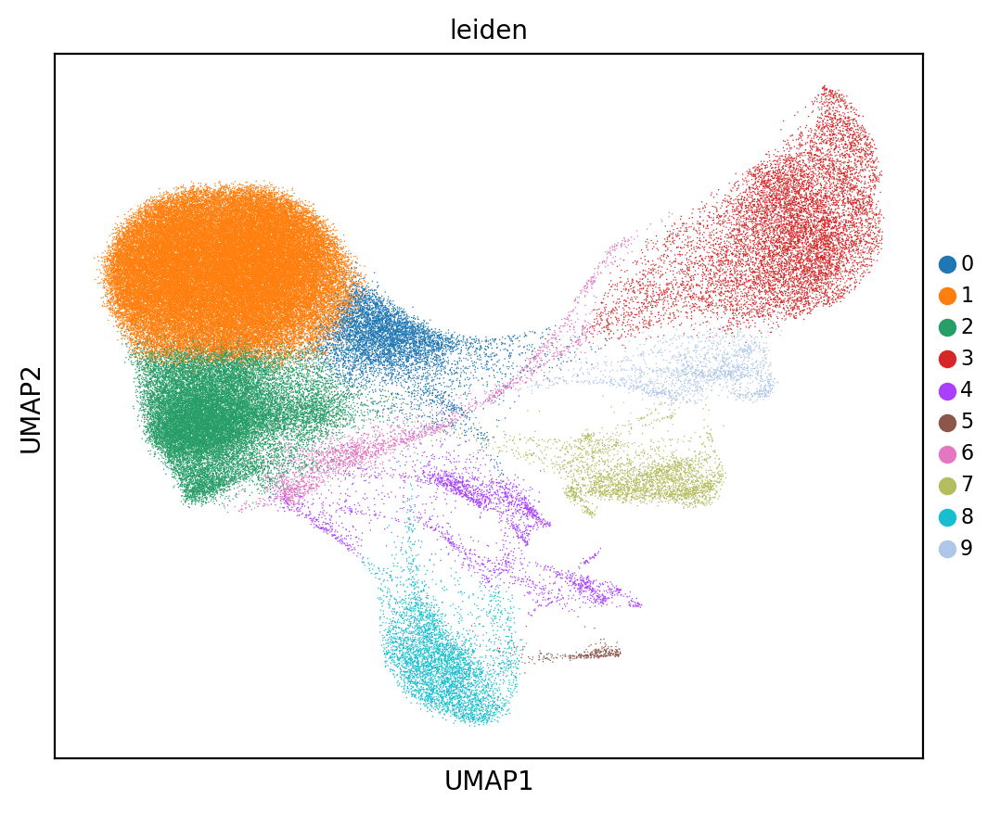

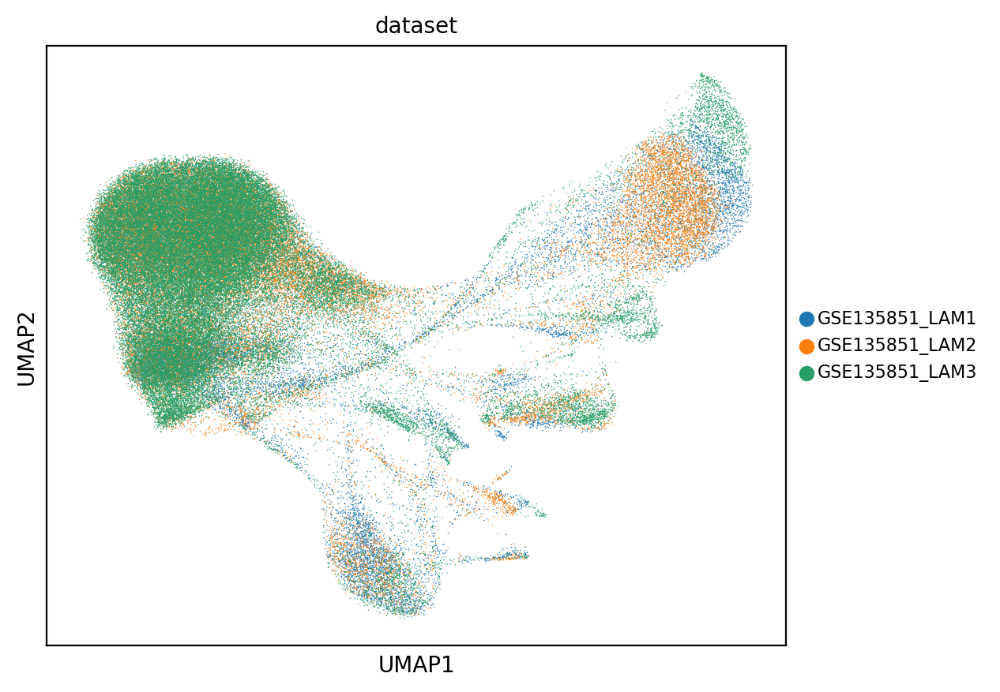

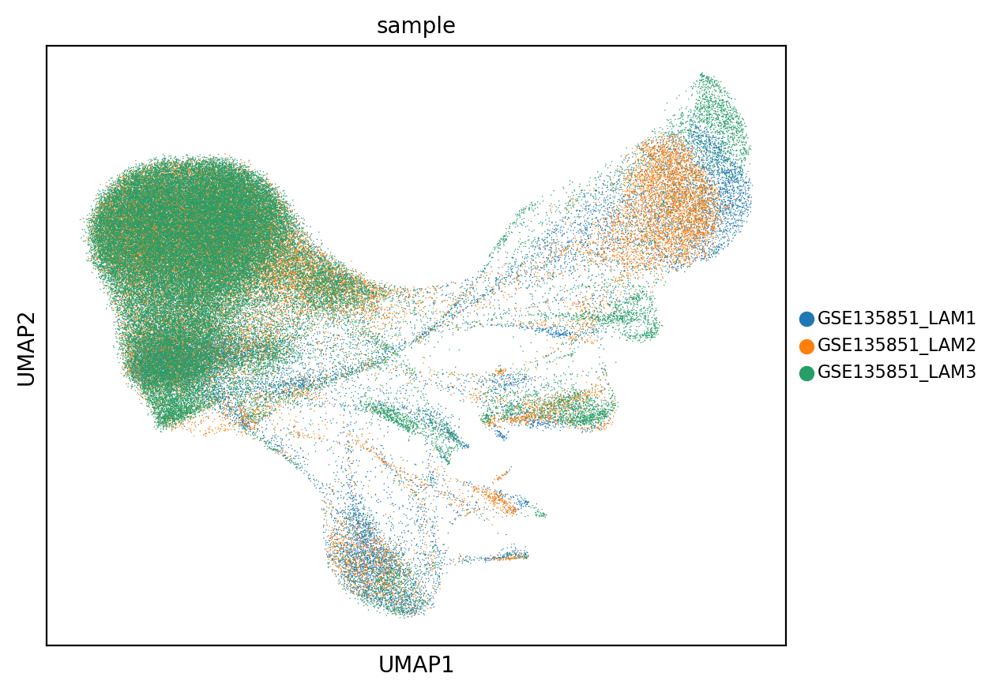

In [65]:
#| hide-input
sc.pl.umap(GSE135851_LAM,color=['leiden'], legend_fontsize=8)
sc.pl.umap(GSE135851_LAM,color=['dataset'], legend_fontsize=8)
sc.pl.umap(GSE135851_LAM,color=['sample'], legend_fontsize=8)

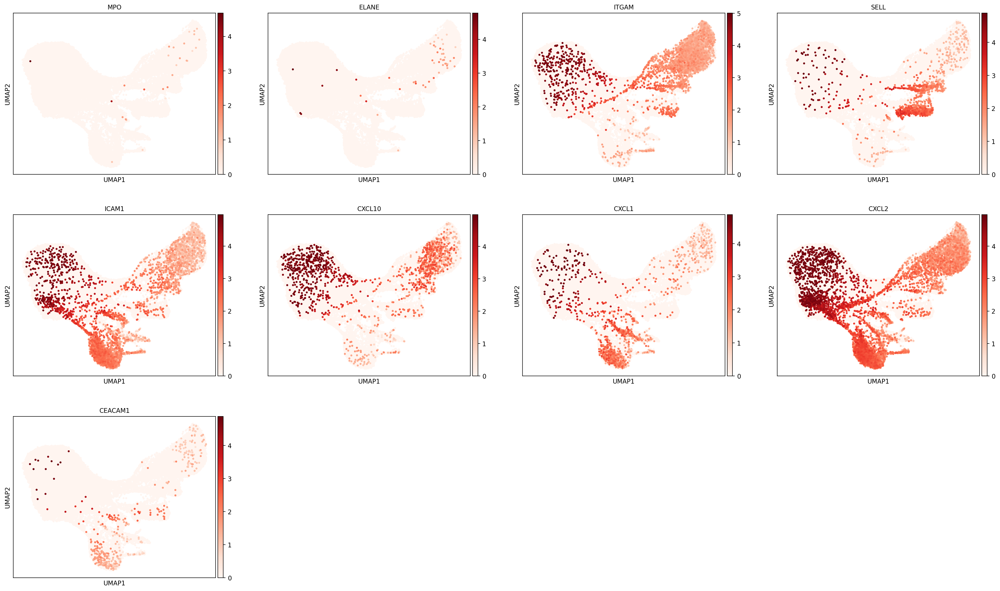

In [66]:
#| hide-input
sc.pl.umap(GSE135851_LAM,color=['MPO','ELANE','ITGAM','SELL','ICAM1','CXCL10','CXCL1','CXCL2','CEACAM1'], legend_fontsize=20, size = 40, cmap = 'Reds')

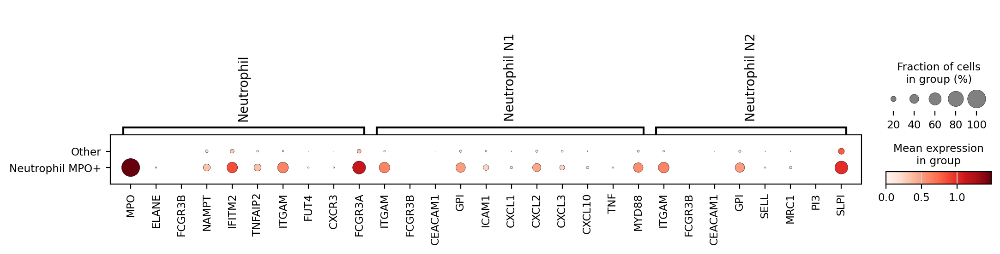

In [67]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}
sc.pl.dotplot(
    GSE135851_LAM,
    marker_Neutrophil,
    groupby = ["Cell_Type"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - Lam 2 Samples [GSE135851]'
)

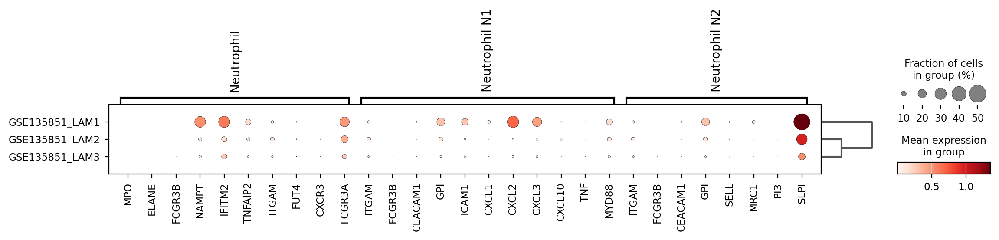

In [68]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    GSE135851_LAM,
    marker_Neutrophil,
    groupby = ["sample"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - Lam 2 Samples [GSE135851]'
)

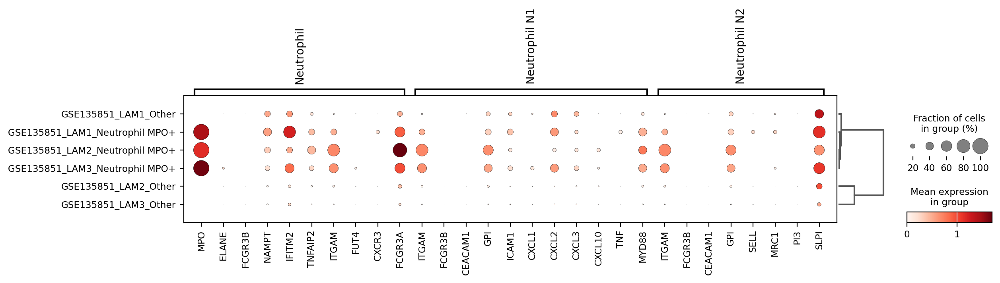

In [69]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    GSE135851_LAM,
    marker_Neutrophil,
    groupby = ["sample",'Cell_Type'], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - Lam 2 Samples [GSE135851]'
)

### GSE190260

In [70]:
#| remove-cell
!ls
%cd /gpfs01/home/mzxcs8/Extra/Neutrophil LAM Phenotype - Johnson Lab/GSE190260
!pwd
!mkdir LAM1
!tar -xvf GSM5718713_LAM1110.tar.gz -C LAM1
!mkdir LAM2
!tar -xvf GSM5718714_LAM1158.tar.gz -C LAM2
!mkdir LAM3
!tar -xvf GSM5718715_LAM1163.tar.gz -C LAM3

GSE135851-GPL16791_series_matrix.txt.gz  GSM4035467_LAM3.mtx.tsv.tar.gz  LAM3
GSE135851-GPL24676_series_matrix.txt.gz  GSM4035468_LAM4.mtx.tsv.tar.gz  LAM4
GSM4035465_LAM1.mtx.tsv.tar.gz		 LAM1
GSM4035466_LAM2.mtx.tsv.tar.gz		 LAM2
/gpfs01/home/mzxcs8/Extra/Neutrophil LAM Phenotype - Johnson Lab/GSE190260
/gpfs01/home/mzxcs8/Extra/Neutrophil LAM Phenotype - Johnson Lab/GSE190260
mkdir: cannot create directory 'LAM1': File exists
./
./genes.tsv
./barcodes.tsv
./matrix.mtx
mkdir: cannot create directory 'LAM2': File exists
./
./genes.tsv
./barcodes.tsv
./matrix.mtx
mkdir: cannot create directory 'LAM3': File exists
._.
./
./._features.tsv.gz
./features.tsv.gz
./._barcodes.tsv.gz
./barcodes.tsv.gz
./._matrix.mtx.gz
./matrix.mtx.gz


In [71]:
#| remove-cell
# Load each sample into python.
GSE190260_LAM1 = sc.read_10x_mtx('LAM1/', var_names='gene_symbols')
GSE190260_LAM2 = sc.read_10x_mtx('LAM2/', var_names='gene_symbols')
GSE190260_LAM3 = sc.read_10x_mtx('LAM3/', var_names='gene_symbols')

#### LAM1

In [72]:
#| remove-cell
GSE190260_LAM1.obs['sample'] = "GSE190260_LAM1"
GSE190260_LAM1.obs['dataset'] = "GSE190260"

In [73]:
#| remove-cell
GSE190260_LAM1

AnnData object with n_obs × n_vars = 2188 × 33694
    obs: 'sample', 'dataset'
    var: 'gene_ids'

In [74]:
#| remove-cell
sc.pp.filter_cells(GSE190260_LAM1, min_genes=75)
sc.pp.filter_cells(GSE190260_LAM1, max_genes=7500)
sc.pp.filter_genes(GSE190260_LAM1, min_cells=3)

# Returns the dimensions of the expression matrix (cells, genes)
GSE190260_LAM1.shape

(2187, 18890)

In [75]:
#| remove-cell
sc.pp.normalize_total(GSE190260_LAM1, target_sum=1e4)
sc.pp.log1p(GSE190260_LAM1)

In [76]:
#| remove-cell
sc.pp.neighbors(GSE190260_LAM1)
sc.tl.umap(GSE190260_LAM1)
sc.tl.leiden(GSE190260_LAM1,flavor = "igraph", resolution=0.5, n_iterations = 2)
sc.tl.dendrogram(GSE190260_LAM1, groupby = "leiden")

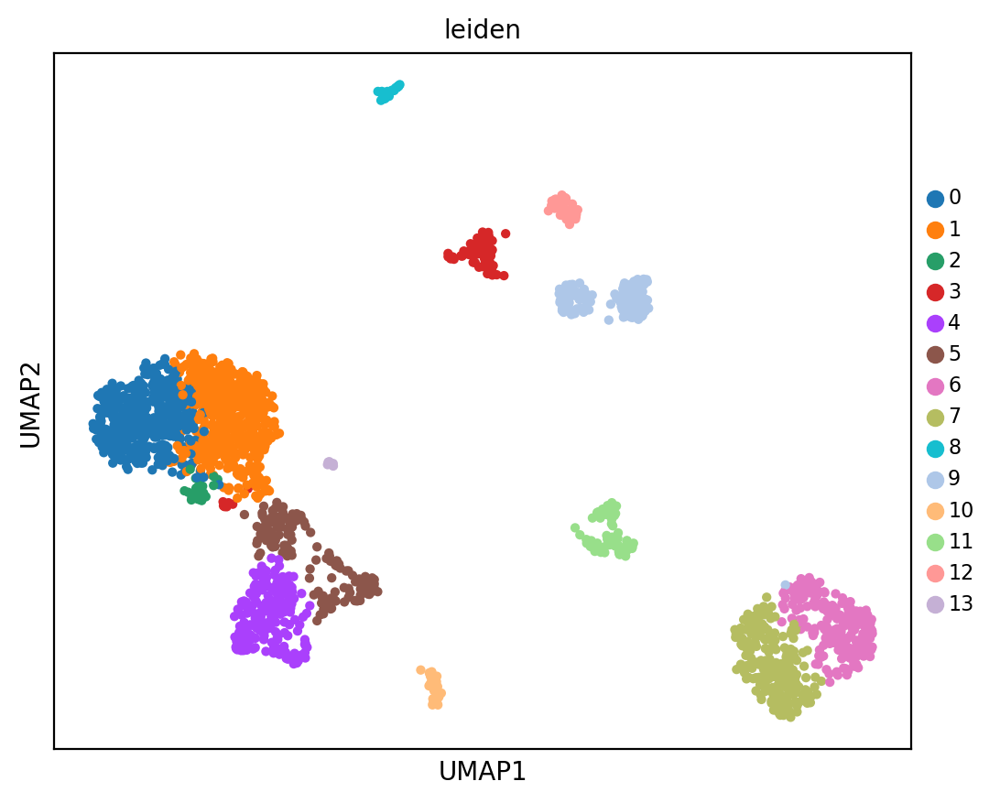

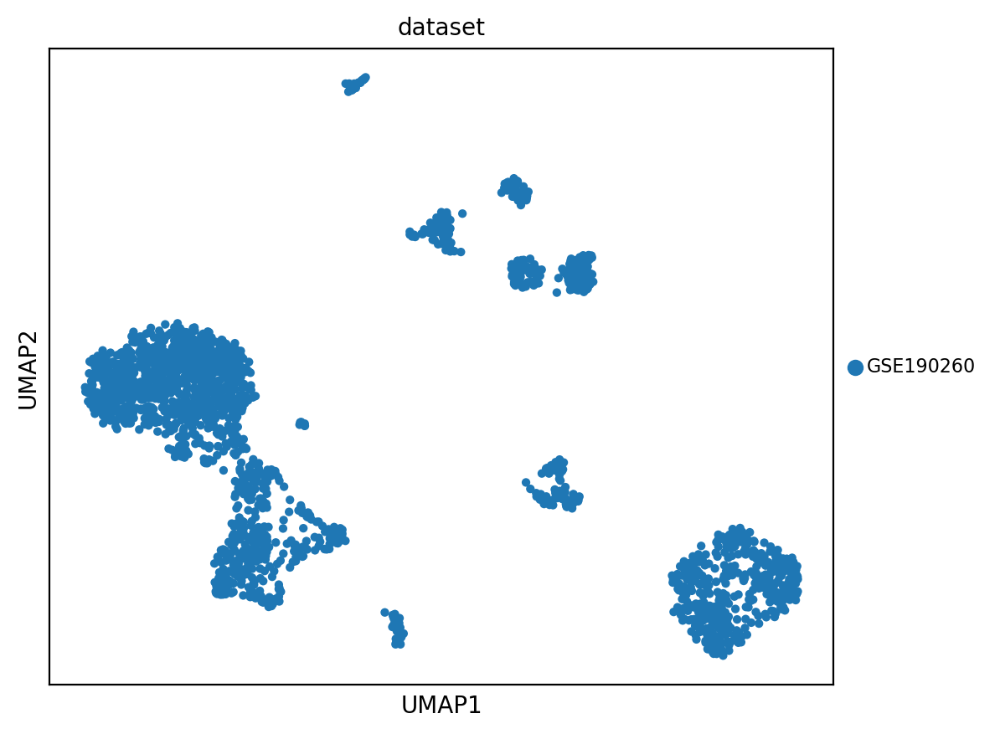

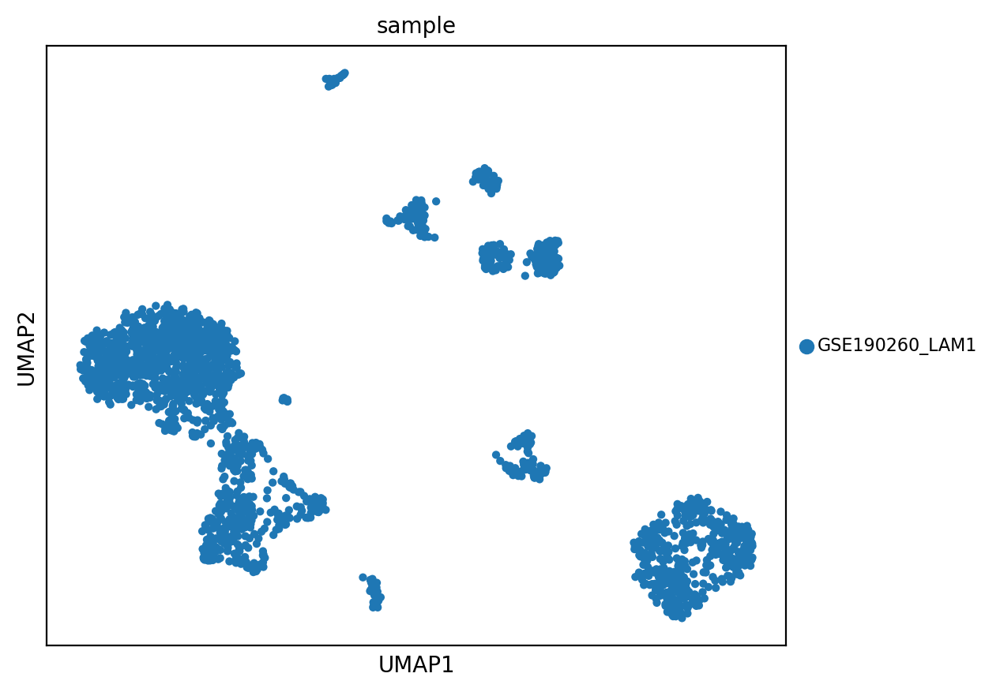

In [77]:
#| hide-input
sc.pl.umap(GSE190260_LAM1,color=['leiden'], legend_fontsize=8)
sc.pl.umap(GSE190260_LAM1,color=['dataset'], legend_fontsize=8)
sc.pl.umap(GSE190260_LAM1,color=['sample'], legend_fontsize=8)

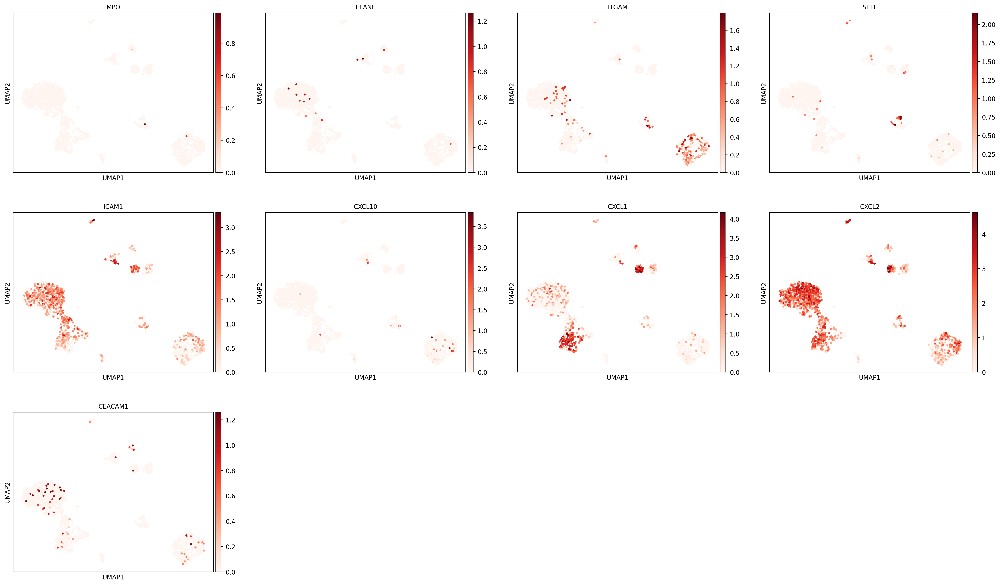

In [78]:
#| hide-input
sc.pl.umap(GSE190260_LAM1,color=['MPO','ELANE','ITGAM','SELL','ICAM1','CXCL10','CXCL1','CXCL2','CEACAM1'], legend_fontsize=20, size = 40, cmap = 'Reds')

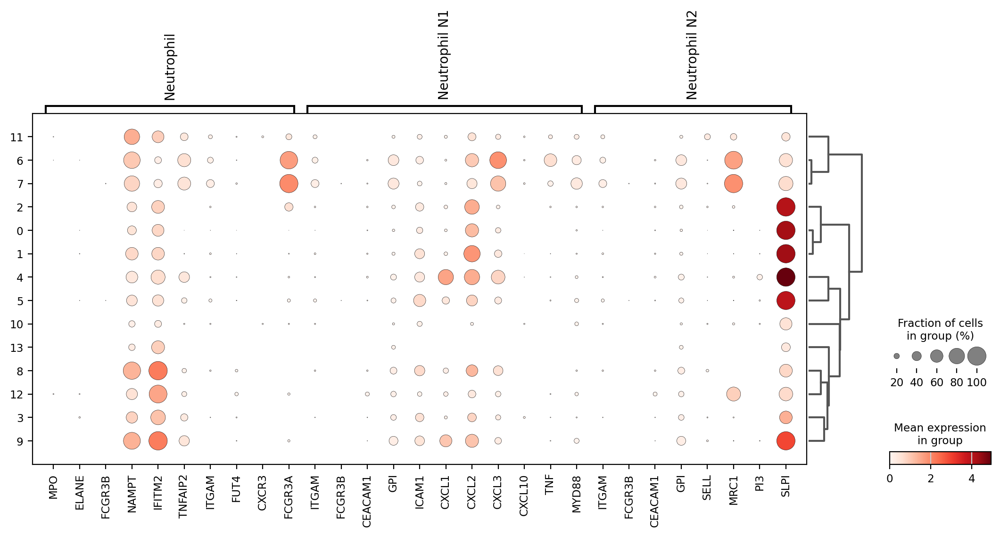

In [79]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    GSE190260_LAM1,
    marker_Neutrophil,
    groupby = ["leiden"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - LAM 2 Samples [GSE135851]'
)

In [80]:
#| remove-cell
GSE190260_LAM1.obs["Cell_Type"] = "Other"
GSE190260_LAM1.obs["Cell_Type"] = GSE190260_LAM1.obs["Cell_Type"].astype("category")

In [81]:
#| remove-cell
GSE190260_LAM1

AnnData object with n_obs × n_vars = 2187 × 18890
    obs: 'sample', 'dataset', 'n_genes', 'leiden', 'Cell_Type'
    var: 'gene_ids', 'n_cells'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'dendrogram_leiden', 'leiden_colors', 'dataset_colors', 'sample_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [82]:
#| hide-input
# Utility function to safely extract gene expression values
# Step 1: Subset epithelial only
GSE190260_LAM1_Neutrophil = GSE190260_LAM1.copy()

def get_gene_expression(adata, gene_name):
    """Extract expression values for a given gene safely, accounting for sparse matrices."""
    if gene_name in adata.var_names:
        gene_idx = adata.var_names.get_loc(gene_name)
        values = adata.X[:, gene_idx].toarray() if sp.issparse(adata.X) else adata.X[:, gene_idx]
        return values.flatten()
    else:
        print(f"Warning: Gene {gene_name} not found in dataset.")
        return np.zeros(adata.shape[0])

#Neutrophil
MPO_values = get_gene_expression(GSE190260_LAM1_Neutrophil, 'MPO')
ELANE_values = get_gene_expression(GSE190260_LAM1_Neutrophil, 'ELANE')

if "Neutrophil MPO+" not in GSE190260_LAM1_Neutrophil.obs["Cell_Type"].cat.categories:
    GSE190260_LAM1_Neutrophil.obs["Cell_Type"] = GSE190260_LAM1_Neutrophil.obs["Cell_Type"].cat.add_categories(["Neutrophil MPO+"]) 

neutrophil_mask = (MPO_values > 0.001)
GSE190260_LAM1_Neutrophil.obs.loc[neutrophil_mask, 'Cell_Type'] = "Neutrophil MPO+"

GSE190260_LAM1_Neutrophil.obs["Cell_Type"] = GSE190260_LAM1_Neutrophil.obs["Cell_Type"].astype("category")

print(GSE190260_LAM1_Neutrophil.obs['Cell_Type'].value_counts())

Cell_Type
Other              2184
Neutrophil MPO+       3
Name: count, dtype: int64


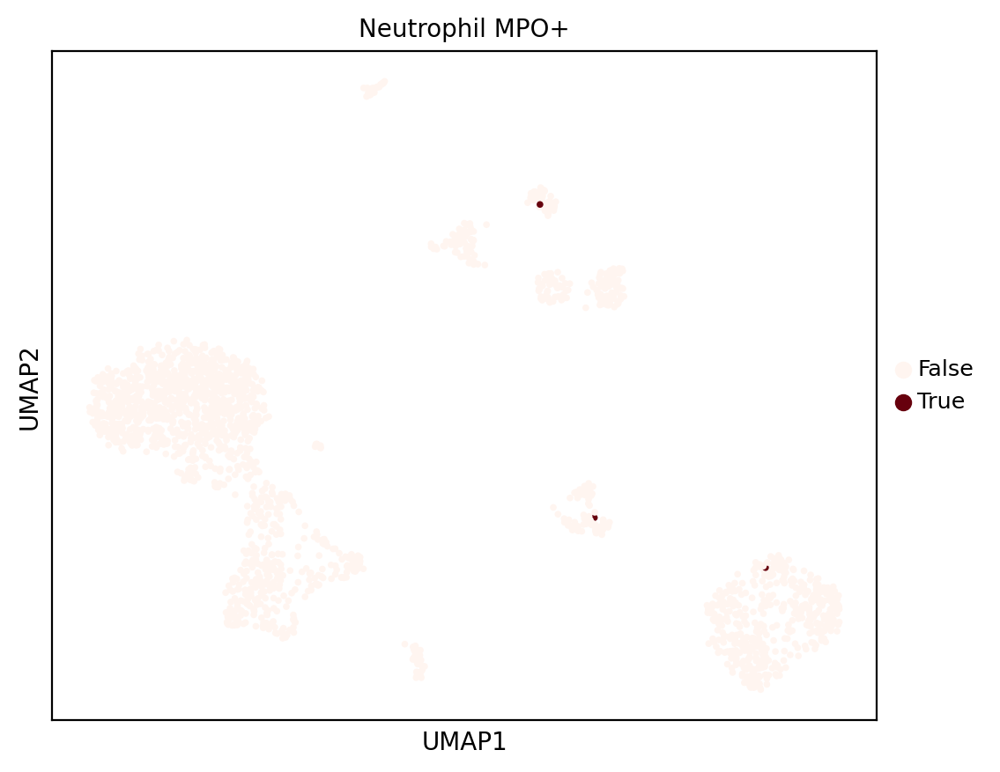

In [83]:
#| hide-input
GSE190260_LAM1_Neutrophil.obs['NP_Only'] = GSE190260_LAM1_Neutrophil.obs['Cell_Type'] == 'Neutrophil MPO+'
sc.pl.umap(GSE190260_LAM1_Neutrophil, color='NP_Only', palette = 'Reds', size = 30, title = 'Neutrophil MPO+')

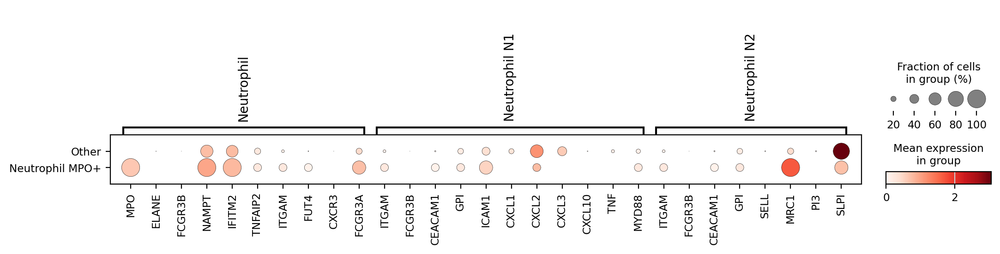

In [84]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    GSE190260_LAM1_Neutrophil,
    marker_Neutrophil,
    groupby = ["Cell_Type"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - Lam 2 Samples [GSE135851]'
)

#### LAM2

In [85]:
#| remove-cell
GSE190260_LAM2.obs['sample'] = "GSE190260_LAM2"
GSE190260_LAM2.obs['dataset'] = "GSE190260"

In [86]:
#| remove-cell
GSE190260_LAM2

AnnData object with n_obs × n_vars = 2057 × 33694
    obs: 'sample', 'dataset'
    var: 'gene_ids'

In [87]:
#| remove-cell
sc.pp.filter_cells(GSE190260_LAM2, min_genes=75)
sc.pp.filter_cells(GSE190260_LAM2, max_genes=7500)
sc.pp.filter_genes(GSE190260_LAM2, min_cells=3)

# Returns the dimensions of the expression matrix (cells, genes)
GSE190260_LAM2.shape

(2040, 20484)

In [88]:
#| remove-cell
sc.pp.normalize_total(GSE190260_LAM2, target_sum=1e4)
sc.pp.log1p(GSE190260_LAM2)

In [89]:
#| remove-cell
sc.pp.neighbors(GSE190260_LAM2)
sc.tl.umap(GSE190260_LAM2)
sc.tl.leiden(GSE190260_LAM2,flavor = "igraph", resolution=0.5, n_iterations = 2)
sc.tl.dendrogram(GSE190260_LAM2, groupby = "leiden")

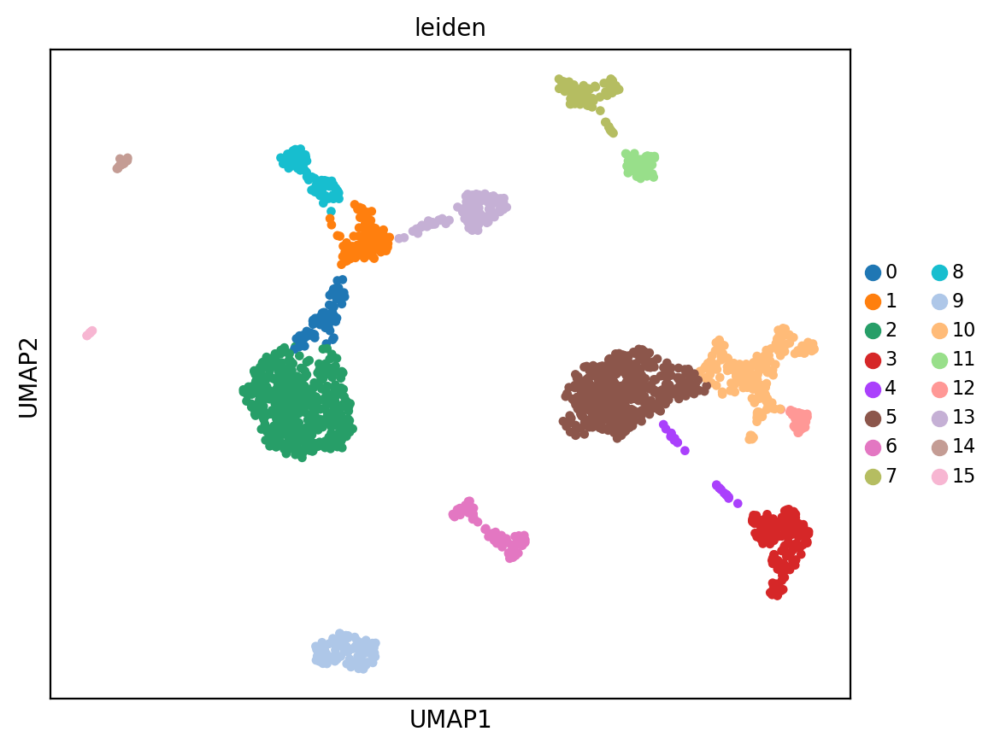

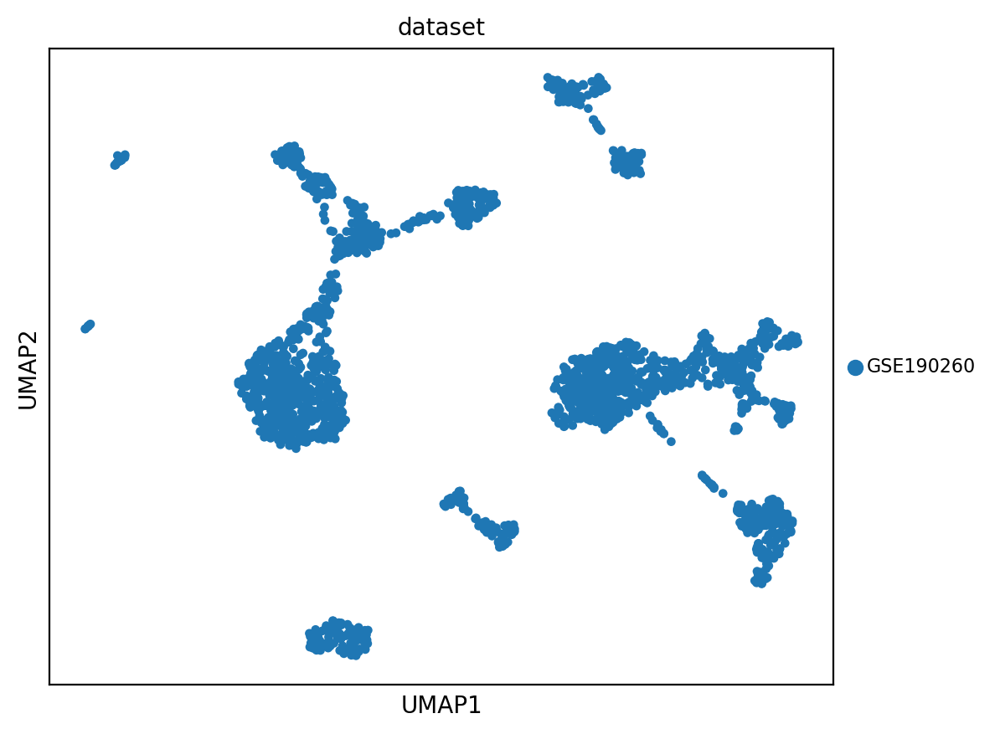

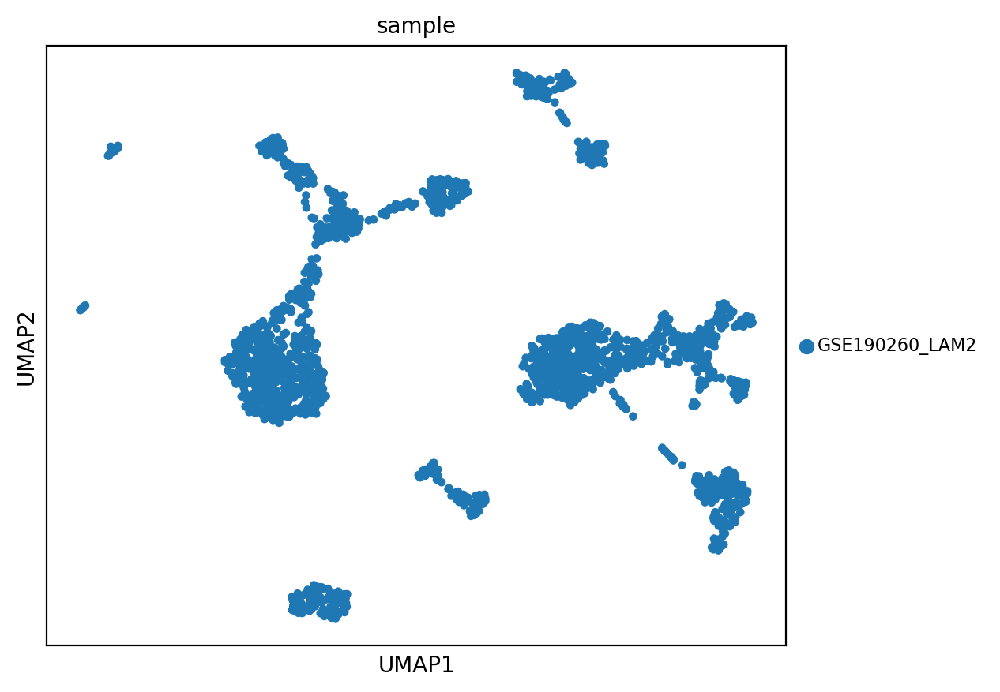

In [90]:
#| hide-input
sc.pl.umap(GSE190260_LAM2,color=['leiden'], legend_fontsize=8)
sc.pl.umap(GSE190260_LAM2,color=['dataset'], legend_fontsize=8)
sc.pl.umap(GSE190260_LAM2,color=['sample'], legend_fontsize=8)

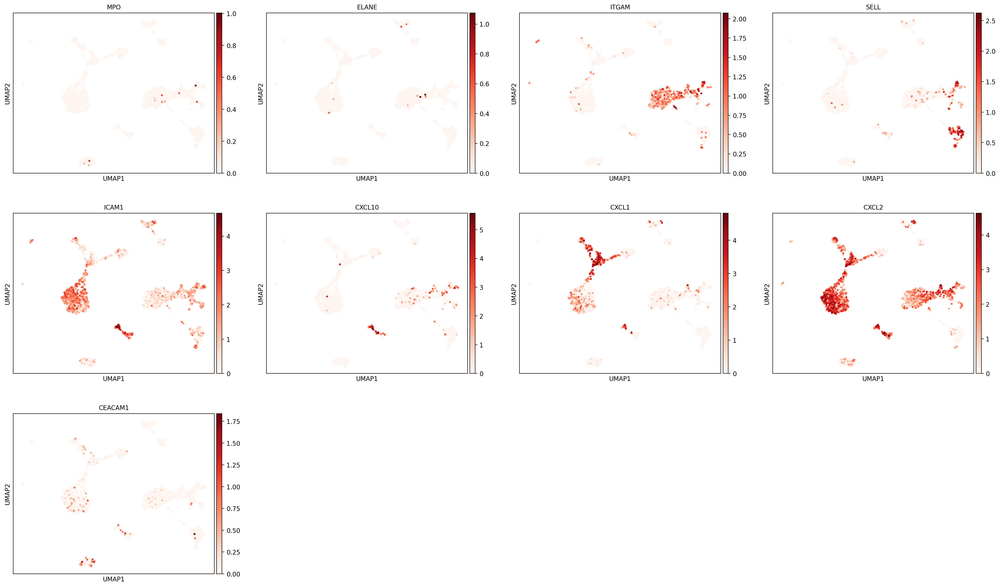

In [91]:
#| hide-input
sc.pl.umap(GSE190260_LAM2,color=['MPO','ELANE','ITGAM','SELL','ICAM1','CXCL10','CXCL1','CXCL2','CEACAM1'], legend_fontsize=20, size = 40, cmap = 'Reds')

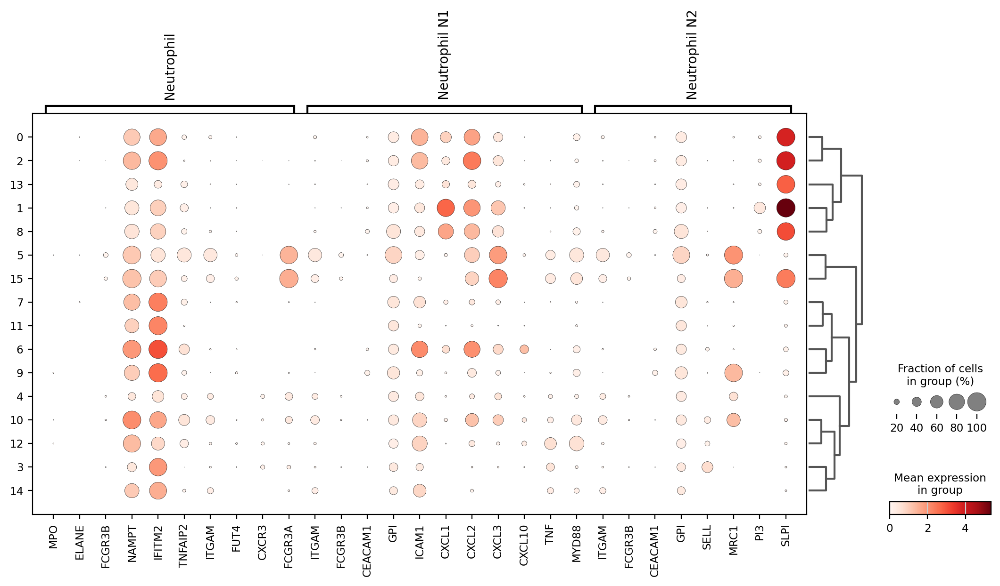

In [92]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    GSE190260_LAM2,
    marker_Neutrophil,
    groupby = ["leiden"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - LAM 2 Samples [GSE135851]'
)

In [93]:
#| remove-cell
GSE190260_LAM2.obs["Cell_Type"] = "Other"
GSE190260_LAM2.obs["Cell_Type"] = GSE190260_LAM2.obs["Cell_Type"].astype("category")

In [94]:
#| remove-cell
GSE190260_LAM2

AnnData object with n_obs × n_vars = 2040 × 20484
    obs: 'sample', 'dataset', 'n_genes', 'leiden', 'Cell_Type'
    var: 'gene_ids', 'n_cells'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'dendrogram_leiden', 'leiden_colors', 'dataset_colors', 'sample_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [95]:
#| hide-input
# Utility function to safely extract gene expression values
# Step 1: Subset epithelial only
GSE190260_LAM2_Neutrophil = GSE190260_LAM2.copy()

def get_gene_expression(adata, gene_name):
    """Extract expression values for a given gene safely, accounting for sparse matrices."""
    if gene_name in adata.var_names:
        gene_idx = adata.var_names.get_loc(gene_name)
        values = adata.X[:, gene_idx].toarray() if sp.issparse(adata.X) else adata.X[:, gene_idx]
        return values.flatten()
    else:
        print(f"Warning: Gene {gene_name} not found in dataset.")
        return np.zeros(adata.shape[0])

#Neutrophil
MPO_values = get_gene_expression(GSE190260_LAM2_Neutrophil, 'MPO')
ELANE_values = get_gene_expression(GSE190260_LAM2_Neutrophil, 'ELANE')

if "Neutrophil MPO+" not in GSE190260_LAM2_Neutrophil.obs["Cell_Type"].cat.categories:
    GSE190260_LAM2_Neutrophil.obs["Cell_Type"] = GSE190260_LAM2_Neutrophil.obs["Cell_Type"].cat.add_categories(["Neutrophil MPO+"]) 

neutrophil_mask = (MPO_values > 0.001)
GSE190260_LAM2_Neutrophil.obs.loc[neutrophil_mask, 'Cell_Type'] = "Neutrophil MPO+"

GSE190260_LAM2_Neutrophil.obs["Cell_Type"] = GSE190260_LAM2_Neutrophil.obs["Cell_Type"].astype("category")

print(GSE190260_LAM2_Neutrophil.obs['Cell_Type'].value_counts())

Cell_Type
Other              2029
Neutrophil MPO+      11
Name: count, dtype: int64


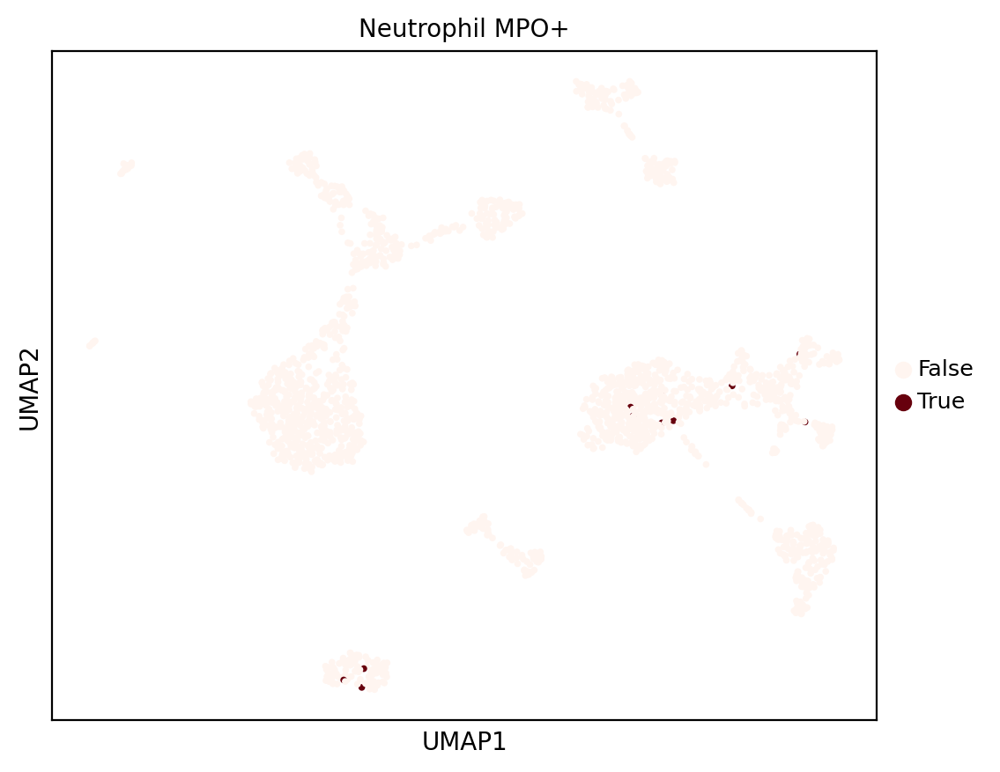

In [96]:
#| hide-input
GSE190260_LAM2_Neutrophil.obs['NP_Only'] = GSE190260_LAM2_Neutrophil.obs['Cell_Type'] == 'Neutrophil MPO+'
sc.pl.umap(GSE190260_LAM2_Neutrophil, color='NP_Only', palette = 'Reds', size = 30, title = 'Neutrophil MPO+')

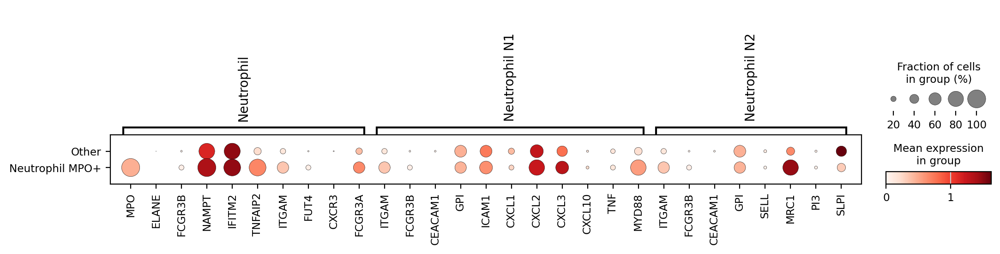

In [97]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    GSE190260_LAM2_Neutrophil,
    marker_Neutrophil,
    groupby = ["Cell_Type"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - Lam 2 Samples [GSE135851]'
)

#### LAM3

In [98]:
#| remove-cell
GSE190260_LAM3.obs['sample'] = "GSE190260_LAM3"
GSE190260_LAM3.obs['dataset'] = "GSE190260"

In [99]:
#| remove-cell
GSE190260_LAM3

AnnData object with n_obs × n_vars = 15497 × 33694
    obs: 'sample', 'dataset'
    var: 'gene_ids', 'feature_types'

In [100]:
#| remove-cell
sc.pp.filter_cells(GSE190260_LAM3, min_genes=75)
sc.pp.filter_cells(GSE190260_LAM3, max_genes=7500)
sc.pp.filter_genes(GSE190260_LAM3, min_cells=3)

# Returns the dimensions of the expression matrix (cells, genes)
GSE190260_LAM3.shape

(15366, 23506)

In [101]:
#| remove-cell
sc.pp.normalize_total(GSE190260_LAM3, target_sum=1e4)
sc.pp.log1p(GSE190260_LAM3)

In [102]:
#| remove-cell
sc.pp.neighbors(GSE190260_LAM3)
sc.tl.umap(GSE190260_LAM3)
sc.tl.leiden(GSE190260_LAM3,flavor = "igraph", resolution=0.5, n_iterations = 2)
sc.tl.dendrogram(GSE190260_LAM3, groupby = "leiden")

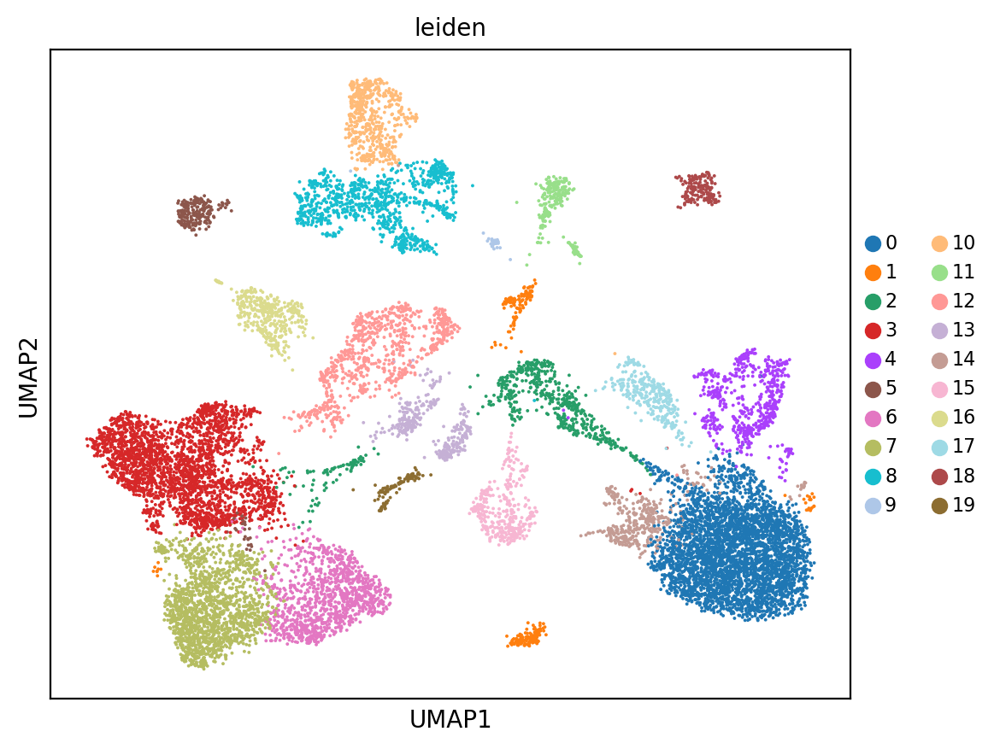

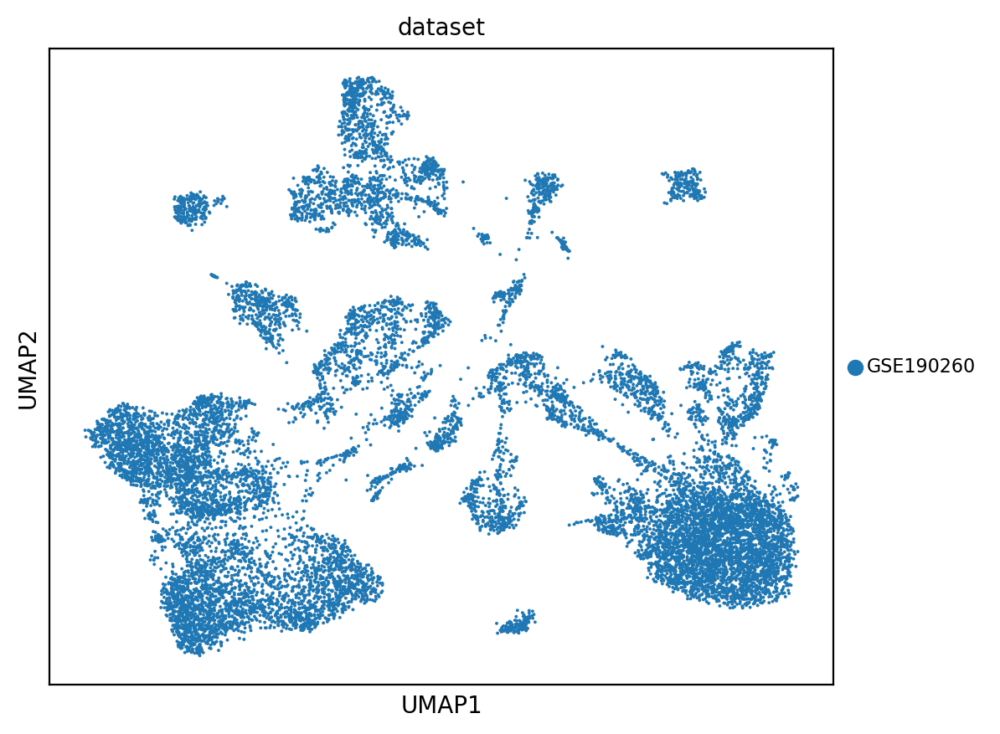

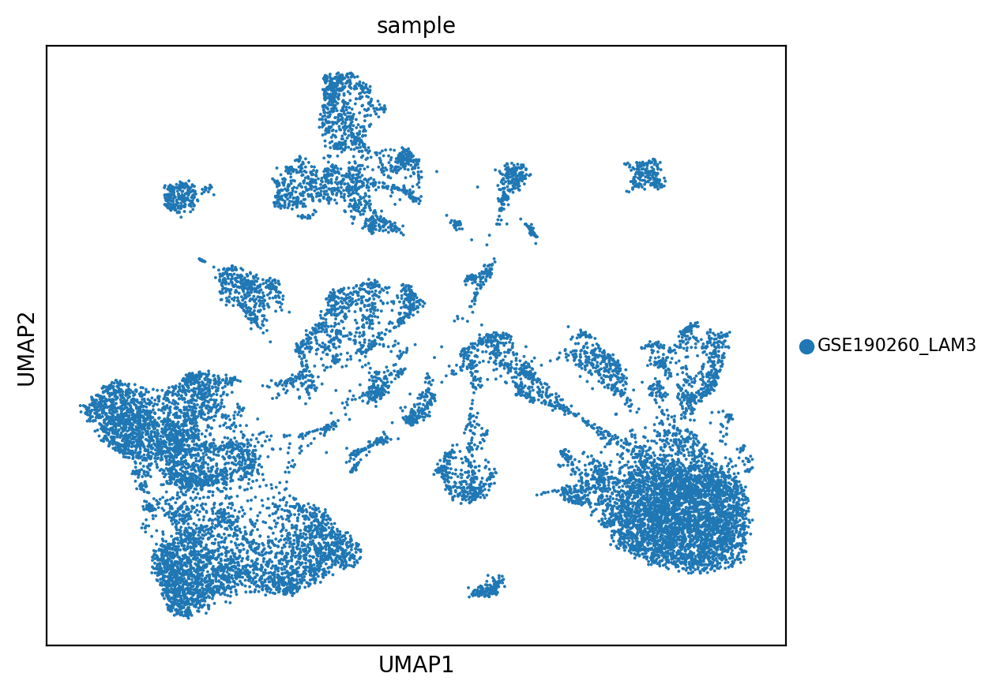

In [103]:
#| hide-input
sc.pl.umap(GSE190260_LAM3,color=['leiden'], legend_fontsize=8)
sc.pl.umap(GSE190260_LAM3,color=['dataset'], legend_fontsize=8)
sc.pl.umap(GSE190260_LAM3,color=['sample'], legend_fontsize=8)

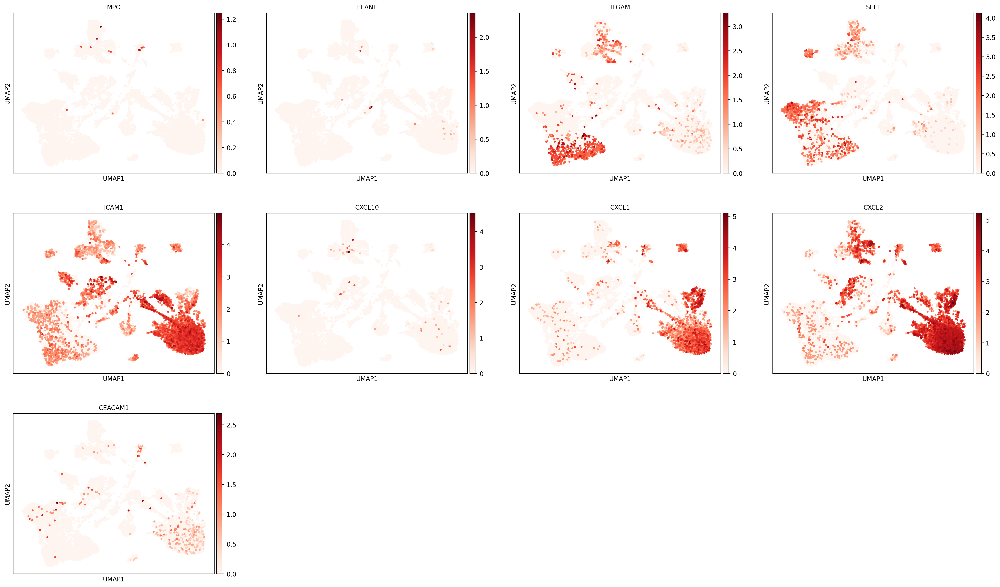

In [104]:
#| hide-input
sc.pl.umap(GSE190260_LAM3,color=['MPO','ELANE','ITGAM','SELL','ICAM1','CXCL10','CXCL1','CXCL2','CEACAM1'], legend_fontsize=20, size = 40, cmap = 'Reds')

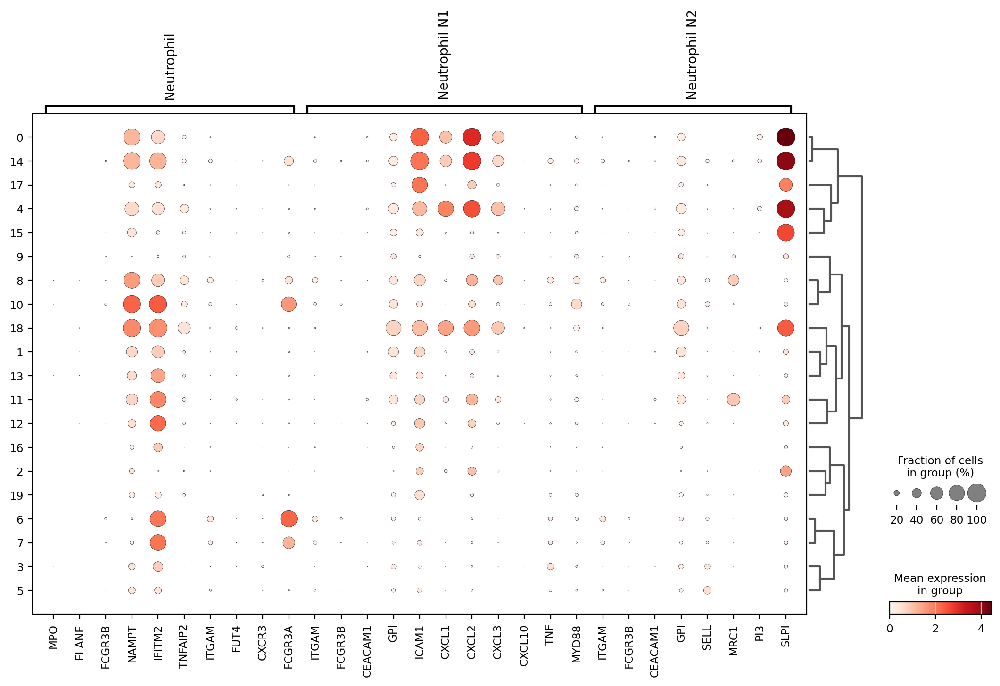

In [105]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    GSE190260_LAM3,
    marker_Neutrophil,
    groupby = ["leiden"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - LAM 2 Samples [GSE135851]'
)

In [106]:
#| remove-cell
GSE190260_LAM3.obs["Cell_Type"] = "Other"
GSE190260_LAM3.obs["Cell_Type"] = GSE190260_LAM3.obs["Cell_Type"].astype("category")

In [107]:
#| remove-cell
GSE190260_LAM3

AnnData object with n_obs × n_vars = 15366 × 23506
    obs: 'sample', 'dataset', 'n_genes', 'leiden', 'Cell_Type'
    var: 'gene_ids', 'feature_types', 'n_cells'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'dendrogram_leiden', 'leiden_colors', 'dataset_colors', 'sample_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [108]:
#| hide-input
# Utility function to safely extract gene expression values
# Step 1: Subset epithelial only
GSE190260_LAM3_Neutrophil = GSE190260_LAM3.copy()

def get_gene_expression(adata, gene_name):
    """Extract expression values for a given gene safely, accounting for sparse matrices."""
    if gene_name in adata.var_names:
        gene_idx = adata.var_names.get_loc(gene_name)
        values = adata.X[:, gene_idx].toarray() if sp.issparse(adata.X) else adata.X[:, gene_idx]
        return values.flatten()
    else:
        print(f"Warning: Gene {gene_name} not found in dataset.")
        return np.zeros(adata.shape[0])

#Neutrophil
MPO_values = get_gene_expression(GSE190260_LAM3_Neutrophil, 'MPO')
ELANE_values = get_gene_expression(GSE190260_LAM3_Neutrophil, 'ELANE')

if "Neutrophil MPO+" not in GSE190260_LAM3_Neutrophil.obs["Cell_Type"].cat.categories:
    GSE190260_LAM3_Neutrophil.obs["Cell_Type"] = GSE190260_LAM3_Neutrophil.obs["Cell_Type"].cat.add_categories(["Neutrophil MPO+"]) 

neutrophil_mask = (MPO_values > 0.001)
GSE190260_LAM3_Neutrophil.obs.loc[neutrophil_mask, 'Cell_Type'] = "Neutrophil MPO+"

GSE190260_LAM3_Neutrophil.obs["Cell_Type"] = GSE190260_LAM3_Neutrophil.obs["Cell_Type"].astype("category")

print(GSE190260_LAM3_Neutrophil.obs['Cell_Type'].value_counts())

Cell_Type
Other              15352
Neutrophil MPO+       14
Name: count, dtype: int64


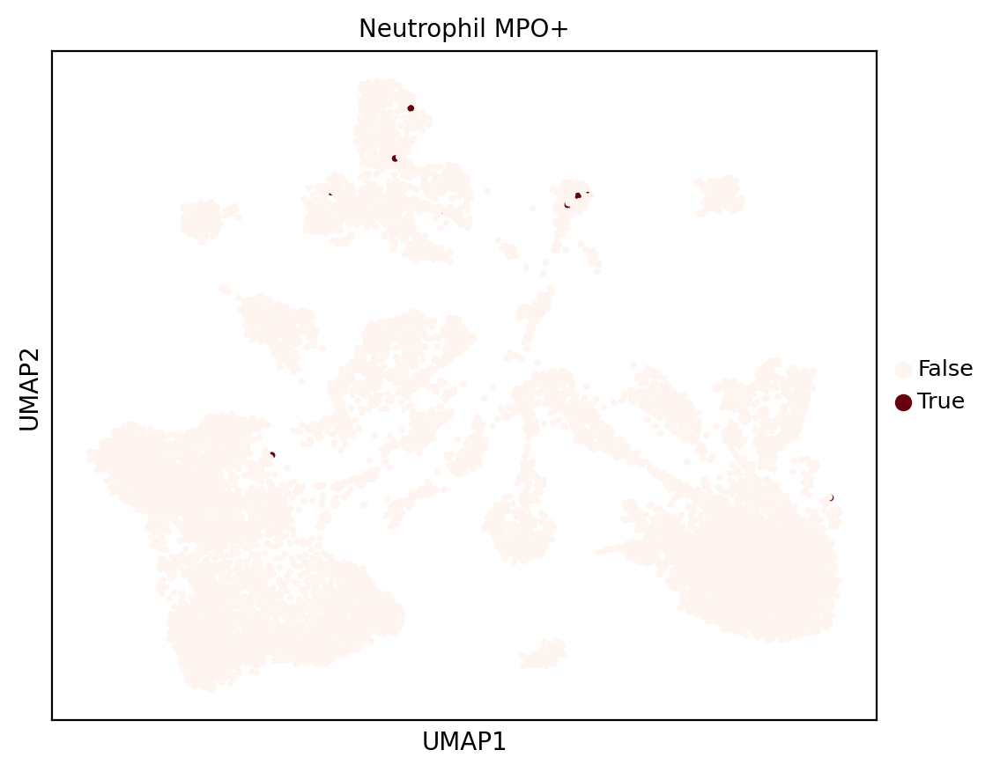

In [109]:
#| hide-input
GSE190260_LAM3_Neutrophil.obs['NP_Only'] = GSE190260_LAM3_Neutrophil.obs['Cell_Type'] == 'Neutrophil MPO+'
sc.pl.umap(GSE190260_LAM3_Neutrophil, color='NP_Only', palette = 'Reds', size = 30, title = 'Neutrophil MPO+')

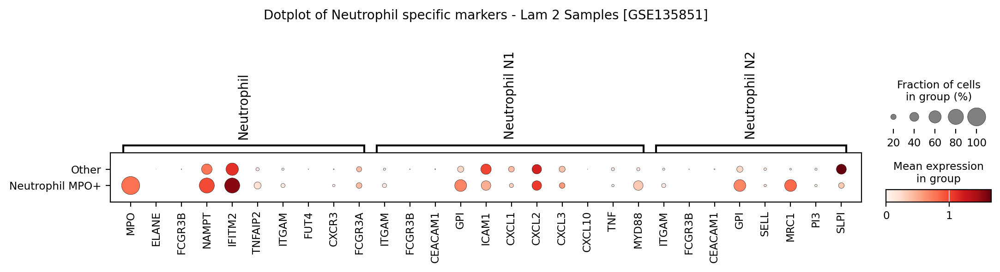

In [110]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    GSE190260_LAM3_Neutrophil,
    marker_Neutrophil,
    groupby = ["Cell_Type"], 
    dendrogram=True,
    use_raw=False,
    title = 'Dotplot of Neutrophil specific markers - Lam 2 Samples [GSE135851]'
)

### Joining DataSets for GSE190260

In [111]:
#| remove-cell
# fixed_pipeline.py
import mygene
import pandas as pd
import scanpy as sc
import numpy as np

mg = mygene.MyGeneInfo()

# =====================================
# Step 0: Collect datasets
# =====================================
datasets = {
    'GSE190260_LAM1': GSE190260_LAM1_Neutrophil,
    'GSE190260_LAM2': GSE190260_LAM2_Neutrophil,
    'GSE190260_LAM3': GSE190260_LAM3_Neutrophil    
}

# Build reference gene set as union (keep any gene present in any dataset)
reference_genes = set().union(*(ad.var_names for ad in datasets.values()))
print(f"Reference gene set (union): {len(reference_genes)} genes")

# =====================================
# Step 1: Gene mapping
# =====================================
def build_gene_mapping(gene_list, reference_set, dataset_name):
    """
    Map Ensembl IDs, symbols, or aliases to HGNC symbols,
    prioritizing reference_set membership.

    Returns:
        mapping (dict): query -> mapped ID
        unmapped_df (pd.DataFrame): queries that could not be mapped
    """
    # Query mygene (ask for both 'ensembl.gene' and 'ensembl' to capture both formats)
    res = mg.querymany(
        list(gene_list),
        scopes=["ensembl.gene", "symbol", "alias", "ensembl"],
        fields="symbol,ensembl.gene,ensembl,alias",
        species="human",
        as_dataframe=True,
    )

    mapping = {}
    unmapped_records = []  # store info for dataframe

    # iterate rows (each query)
    for query, row in res.iterrows():
        # mygene returns a 'notfound' column for missing queries
        if isinstance(row, pd.Series) and row.get("notfound"):
            unmapped_records.append(
                {"dataset": dataset_name, "query": query, "reason": "notfound"}
            )
            continue

        # Collect all possible identifiers
        candidates = set()

        # symbol
        symbol = row.get("symbol")
        if pd.notna(symbol):
            candidates.add(symbol)

        # ensembl.gene (string or list)
        ens_gene = row.get("ensembl.gene")
        if pd.notna(ens_gene):
            if isinstance(ens_gene, list):
                candidates.update(ens_gene)
            else:
                candidates.add(ens_gene)

        # ensembl (list of dicts or single dict) -> extract 'gene' keys
        ens_full = row.get("ensembl")
        if pd.notna(ens_full):
            if isinstance(ens_full, dict) and "gene" in ens_full:
                candidates.add(ens_full["gene"])
            elif isinstance(ens_full, list):
                for entry in ens_full:
                    if isinstance(entry, dict) and "gene" in entry:
                        candidates.add(entry["gene"])

        # alias (string or list)
        aliases = row.get("alias")
        if pd.notna(aliases):
            if isinstance(aliases, list):
                candidates.update(aliases)
            else:
                candidates.add(aliases)

        # Try to match against reference set (priority)
        match = next((c for c in candidates if c in reference_set), None)

        if match:
            mapping[query] = match
        elif symbol:  # fallback: use symbol if present
            mapping[query] = symbol
        else:
            unmapped_records.append(
                {"dataset": dataset_name, "query": query, "reason": "no_match_in_reference"}
            )

    unmapped_df = pd.DataFrame(unmapped_records)
    # ensure consistent columns even if empty
    if unmapped_df.empty:
        unmapped_df = pd.DataFrame(columns=["dataset", "query", "reason"])
    return mapping, unmapped_df


# =====================================
# Step 2: Harmonize + merge duplicates
# =====================================
def harmonize_and_merge(adata, reference_set, dataset_name, merge_method="sum", convert_sparse=True):
    """
    Rename genes to reference symbols, merge duplicates.
    Returns (adata_harmonized, unmapped_df).
    Parameters:
      - merge_method: "sum" (default) or "mean"
      - convert_sparse: if True, transiently convert sparse matrix to dense for grouping;
                        if False, will try a memory-friendly sparse approach (not implemented here).
    """
    print(f"\n--- Harmonizing {dataset_name} ---")
    mapping, unmapped_df = build_gene_mapping(adata.var_names, reference_set, dataset_name)

    # Keep a copy of original var names
    adata.var["old_names"] = adata.var_names

    # Apply mapping (map queries to mapped name or keep original)
    new_names = adata.var_names.to_series().map(lambda g: mapping.get(g, g))
    adata.var_names = new_names

    # If duplicates exist, merge them
    if adata.var_names.has_duplicates:
        ndup = adata.var_names.duplicated().sum()
        print(f"{dataset_name}: {ndup} duplicate gene names detected → merging ({merge_method})")

        # Convert to dense carefully — only if requested and if size allows
        if convert_sparse and hasattr(adata.X, "toarray"):
            X = adata.X.T.toarray()  # genes x cells
        else:
            # fallback to numpy conversion (may still be large)
            X = np.asarray(adata.X.T)

        # Create DataFrame with genes x cells
        df = pd.DataFrame(X, index=adata.var_names, columns=adata.obs_names)

        # Group by gene name and aggregate
        if merge_method == "sum":
            df2 = df.groupby(df.index).sum()
        elif merge_method == "mean":
            df2 = df.groupby(df.index).mean()
        else:
            raise ValueError("merge_method must be 'sum' or 'mean'")

        # Re-create AnnData (cells x genes)
        adata = sc.AnnData(df2.T, obs=adata.obs.copy())
        adata.var_names = df2.index
        adata.var_names.name = None

    # Final sanity-check: ensure var_names are strings
    adata.var_names = adata.var_names.astype(str)

    print(f"{dataset_name}: {adata.n_vars} genes after harmonization")
    return adata, unmapped_df


# =====================================
# Step 3: Apply harmonization & track unmapped
# =====================================
all_unmapped_list = []
harmonized_datasets = {}

for name, ad in datasets.items():
    adata_harmonized, unmapped_df = harmonize_and_merge(ad.copy(), reference_genes, name)
    harmonized_datasets[name] = adata_harmonized
    all_unmapped_list.append(unmapped_df)

# Concatenate unmapped into one DataFrame
all_unmapped = pd.concat(all_unmapped_list, ignore_index=True)

# =====================================
# Step 4: Concatenate (intersection or union as desired)
# =====================================
# Use join="outer" for union, "inner" for intersection across datasets
GSE190260_LAM = sc.concat(
    list(harmonized_datasets.values()),
    join="inner",
    label="dataset",
    keys=list(harmonized_datasets.keys()),
)

print("\nFinal concatenated AnnData:")
print(f"Shape: {GSE190260_LAM.shape}")   # (cells, genes)

# Show unmapped summary
print("\n⚠️ Unmapped genes summary:")
display(all_unmapped.head())


Input sequence provided is already in string format. No operation performed
querying 1-1000 ...


Reference gene set (union): 23975 genes

--- Harmonizing GSE190260_LAM1 ---


querying 1001-2000 ...
querying 2001-3000 ...
querying 3001-4000 ...
querying 4001-5000 ...
querying 5001-6000 ...
querying 6001-7000 ...
querying 7001-8000 ...
querying 8001-9000 ...
querying 9001-10000 ...
querying 10001-11000 ...
querying 11001-12000 ...
querying 12001-13000 ...
querying 13001-14000 ...
querying 14001-15000 ...
querying 15001-16000 ...
querying 16001-17000 ...
querying 17001-18000 ...
querying 18001-18890 ...
Finished.
1083 input query terms found dup hits:	[('LINC00115', 2), ('DVL1', 2), ('SLC35E2', 2), ('PLEKHG5', 2), ('PIK3CD', 2), ('PGD', 2), ('APITD1'
2550 input query terms found no hit:	['RP11-34P13.7', 'FO538757.2', 'AP006222.2', 'RP4-669L17.10', 'RP11-206L10.9', 'RP11-54O7.3', 'RP11-
Pass "returnall=True" to return complete lists of duplicate or missing query terms.
Input sequence provided is already in string format. No operation performed
querying 1-1000 ...


GSE190260_LAM1: 18890 genes after harmonization

--- Harmonizing GSE190260_LAM2 ---


querying 1001-2000 ...
querying 2001-3000 ...
querying 3001-4000 ...
querying 4001-5000 ...
querying 5001-6000 ...
querying 6001-7000 ...
querying 7001-8000 ...
querying 8001-9000 ...
querying 9001-10000 ...
querying 10001-11000 ...
querying 11001-12000 ...
querying 12001-13000 ...
querying 13001-14000 ...
querying 14001-15000 ...
querying 15001-16000 ...
querying 16001-17000 ...
querying 17001-18000 ...
querying 18001-19000 ...
querying 19001-20000 ...
querying 20001-20484 ...
Finished.
1207 input query terms found dup hits:	[('LINC00115', 2), ('DVL1', 2), ('SLC35E2', 2), ('PLEKHG5', 2), ('PIK3CD', 2), ('PGD', 2), ('APITD1'
3212 input query terms found no hit:	['RP11-34P13.7', 'FO538757.2', 'AP006222.2', 'RP4-669L17.10', 'RP5-857K21.4', 'RP11-206L10.9', 'RP11
Pass "returnall=True" to return complete lists of duplicate or missing query terms.
Input sequence provided is already in string format. No operation performed
querying 1-1000 ...


GSE190260_LAM2: 20484 genes after harmonization

--- Harmonizing GSE190260_LAM3 ---


querying 1001-2000 ...
querying 2001-3000 ...
querying 3001-4000 ...
querying 4001-5000 ...
querying 5001-6000 ...
querying 6001-7000 ...
querying 7001-8000 ...
querying 8001-9000 ...
querying 9001-10000 ...
querying 10001-11000 ...
querying 11001-12000 ...
querying 12001-13000 ...
querying 13001-14000 ...
querying 14001-15000 ...
querying 15001-16000 ...
querying 16001-17000 ...
querying 17001-18000 ...
querying 18001-19000 ...
querying 19001-20000 ...
querying 20001-21000 ...
querying 21001-22000 ...
querying 22001-23000 ...
querying 23001-23506 ...
Finished.
1412 input query terms found dup hits:	[('LINC00115', 2), ('DVL1', 2), ('SLC35E2', 2), ('CHD5', 4), ('PLEKHG5', 2), ('PIK3CD', 2), ('PGD', 
4911 input query terms found no hit:	['RP11-34P13.7', 'FO538757.3', 'FO538757.2', 'AP006222.2', 'RP4-669L17.10', 'RP5-857K21.4', 'RP11-20
Pass "returnall=True" to return complete lists of duplicate or missing query terms.


GSE190260_LAM3: 23506 genes after harmonization

Final concatenated AnnData:
Shape: (19593, 18046)

⚠️ Unmapped genes summary:


,dataset,query,reason
0,GSE190260_LAM1,RP11-34P13.7,notfound
1,GSE190260_LAM1,FO538757.2,notfound
2,GSE190260_LAM1,AP006222.2,notfound
3,GSE190260_LAM1,RP4-669L17.10,notfound
4,GSE190260_LAM1,RP11-206L10.9,notfound


In [112]:
#| remove-cell
GSE190260_LAM

AnnData object with n_obs × n_vars = 19593 × 18046
    obs: 'sample', 'dataset', 'n_genes', 'leiden', 'Cell_Type', 'NP_Only'
    obsm: 'X_pca', 'X_umap'

In [113]:
#| remove-cell
GSE190260_LAM.obs['sample'].value_counts()

sample
GSE190260_LAM3    15366
GSE190260_LAM1     2187
GSE190260_LAM2     2040
Name: count, dtype: int64

In [114]:
#| remove-cell
GSE190260_LAM.obs['dataset'].value_counts()

dataset
GSE190260_LAM3    15366
GSE190260_LAM1     2187
GSE190260_LAM2     2040
Name: count, dtype: int64

In [115]:
#| remove-cell
# Run PCA
#sc.pp.scale(AT2_HLCA)                # optional but recommended
sc.tl.pca(GSE190260_LAM, svd_solver="arpack")

sce.pp.harmony_integrate(GSE190260_LAM, key = 'dataset')
'X_pca_harmony' in GSE190260_LAM.obsm
True

2026-01-19 17:21:24,782 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
Computing initial centroids with sklearn.KMeans...
2026-01-19 17:21:25,475 - harmonypy - INFO - sklearn.KMeans initialization complete.
sklearn.KMeans initialization complete.
2026-01-19 17:21:25,512 - harmonypy - INFO - Iteration 1 of 10
Iteration 1 of 10
2026-01-19 17:21:29,189 - harmonypy - INFO - Iteration 2 of 10
Iteration 2 of 10
2026-01-19 17:21:31,328 - harmonypy - INFO - Iteration 3 of 10
Iteration 3 of 10
2026-01-19 17:21:33,594 - harmonypy - INFO - Iteration 4 of 10
Iteration 4 of 10
2026-01-19 17:21:35,587 - harmonypy - INFO - Iteration 5 of 10
Iteration 5 of 10
2026-01-19 17:21:37,571 - harmonypy - INFO - Converged after 5 iterations
Converged after 5 iterations


True

In [116]:
#| remove-cell
print(f"Total counts in lcc_h_filt: {GSE190260_LAM.X.sum()}")

Total counts in lcc_h_filt: 44933504.0


In [117]:
#| remove-cell
sc.pp.normalize_total(GSE190260_LAM, target_sum=1e4)
sc.pp.log1p(GSE190260_LAM)

#if sp.issparse(AT2_HLCA.X):
#    AT2_HLCA.X = AT2_HLCA.X.toarray()  # Convert sparse to dense matrix
#AT2_HLCA.X.shape

GSE190260_LAM.obsm['X_pca'] = GSE190260_LAM.obsm['X_pca_harmony']

In [118]:
#| remove-cell
sc.pp.neighbors(GSE190260_LAM)
sc.tl.umap(GSE190260_LAM)
sc.tl.leiden(GSE190260_LAM,flavor = "igraph", resolution=0.5, n_iterations = 2)
sc.tl.dendrogram(GSE190260_LAM, groupby = "leiden")

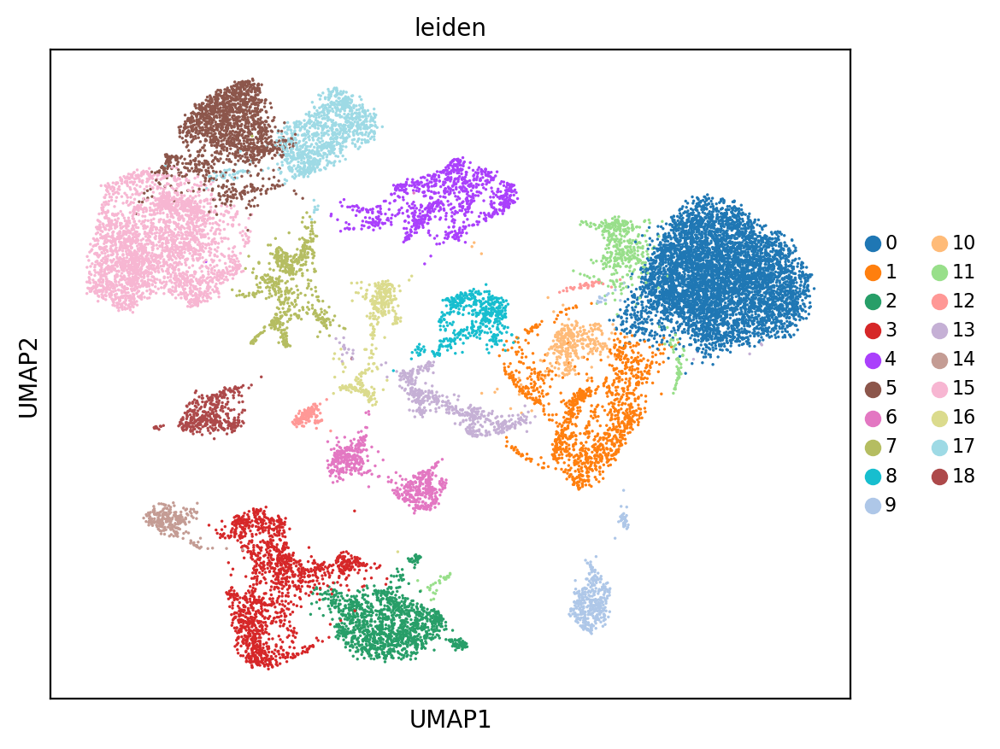

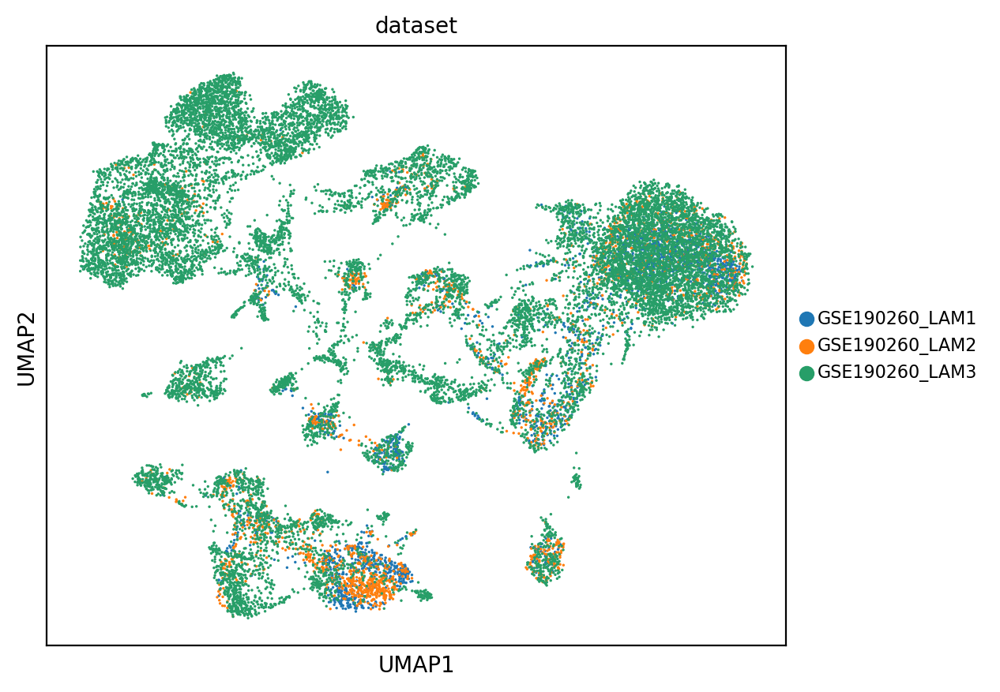

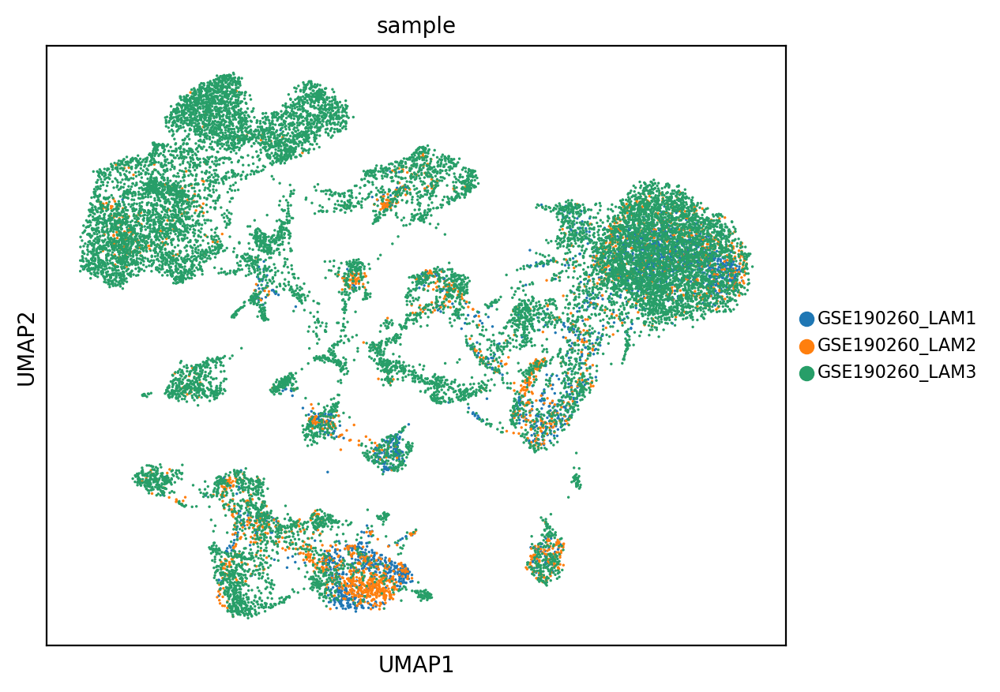

In [119]:
#| hide-input
sc.pl.umap(GSE190260_LAM,color=['leiden'], legend_fontsize=8)
sc.pl.umap(GSE190260_LAM,color=['dataset'], legend_fontsize=8)
sc.pl.umap(GSE190260_LAM,color=['sample'], legend_fontsize=8)

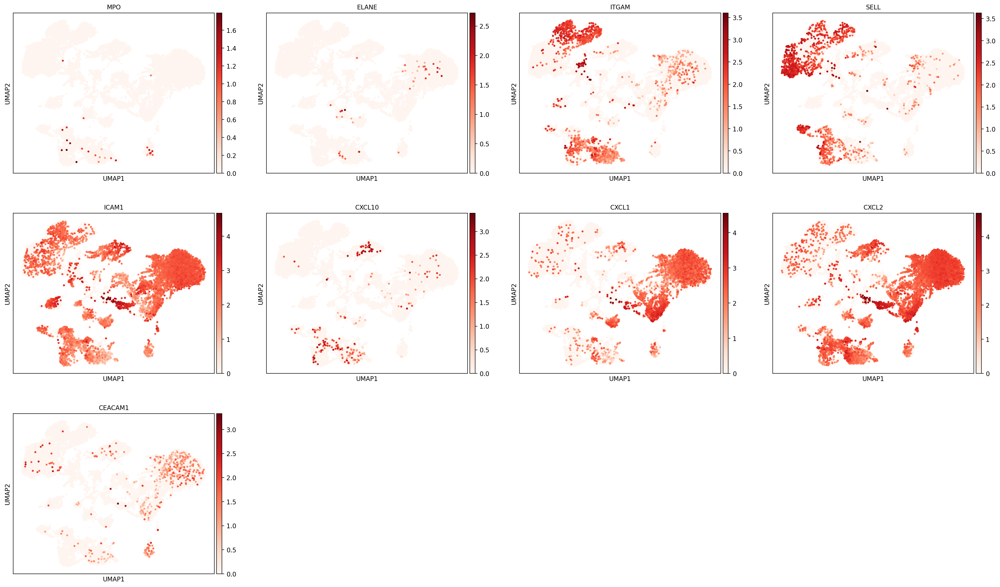

In [120]:
#| hide-input
sc.pl.umap(GSE190260_LAM,color=['MPO','ELANE','ITGAM','SELL','ICAM1','CXCL10','CXCL1','CXCL2','CEACAM1'], legend_fontsize=20, size = 40, cmap = 'Reds')

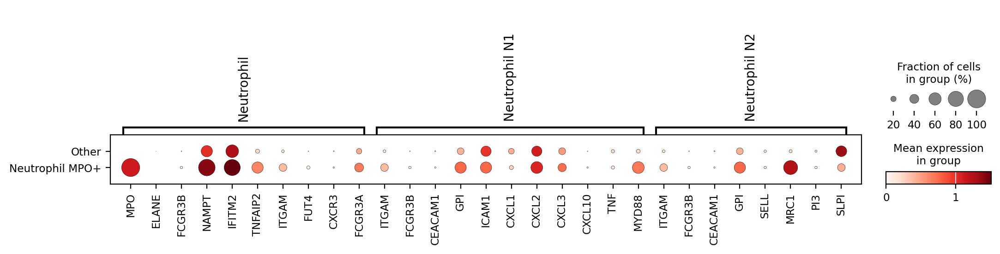

In [121]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}
sc.pl.dotplot(
    GSE190260_LAM,
    marker_Neutrophil,
    groupby = ["Cell_Type"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - Lam 2 Samples [GSE135851]'
)

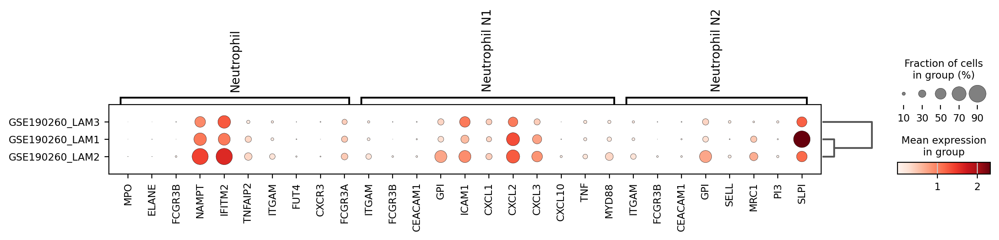

In [122]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    GSE190260_LAM,
    marker_Neutrophil,
    groupby = ["sample"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - Lam 2 Samples [GSE135851]'
)

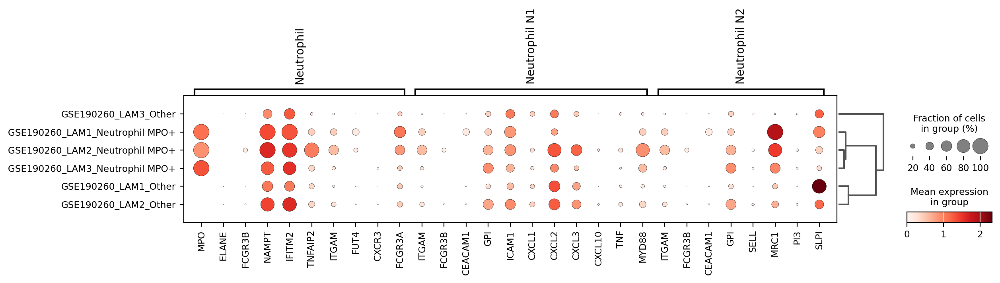

In [138]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    GSE190260_LAM,
    marker_Neutrophil,
    groupby = ["sample",'Cell_Type'], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - Lam 2 Samples [GSE135851]'
)

### Joining GSE190260_LAM with GSE135851_LAM

In [124]:
#| remove-cell
# fixed_pipeline.py
import mygene
import pandas as pd
import scanpy as sc
import numpy as np

mg = mygene.MyGeneInfo()

# =====================================
# Step 0: Collect datasets
# =====================================
datasets = {
    'GSE190260_LAM': GSE190260_LAM,
    'GSE135851_LAM': GSE135851_LAM   
}

# Build reference gene set as union (keep any gene present in any dataset)
reference_genes = set().union(*(ad.var_names for ad in datasets.values()))
print(f"Reference gene set (union): {len(reference_genes)} genes")

# =====================================
# Step 1: Gene mapping
# =====================================
def build_gene_mapping(gene_list, reference_set, dataset_name):
    """
    Map Ensembl IDs, symbols, or aliases to HGNC symbols,
    prioritizing reference_set membership.

    Returns:
        mapping (dict): query -> mapped ID
        unmapped_df (pd.DataFrame): queries that could not be mapped
    """
    # Query mygene (ask for both 'ensembl.gene' and 'ensembl' to capture both formats)
    res = mg.querymany(
        list(gene_list),
        scopes=["ensembl.gene", "symbol", "alias", "ensembl"],
        fields="symbol,ensembl.gene,ensembl,alias",
        species="human",
        as_dataframe=True,
    )

    mapping = {}
    unmapped_records = []  # store info for dataframe

    # iterate rows (each query)
    for query, row in res.iterrows():
        # mygene returns a 'notfound' column for missing queries
        if isinstance(row, pd.Series) and row.get("notfound"):
            unmapped_records.append(
                {"dataset": dataset_name, "query": query, "reason": "notfound"}
            )
            continue

        # Collect all possible identifiers
        candidates = set()

        # symbol
        symbol = row.get("symbol")
        if pd.notna(symbol):
            candidates.add(symbol)

        # ensembl.gene (string or list)
        ens_gene = row.get("ensembl.gene")
        if pd.notna(ens_gene):
            if isinstance(ens_gene, list):
                candidates.update(ens_gene)
            else:
                candidates.add(ens_gene)

        # ensembl (list of dicts or single dict) -> extract 'gene' keys
        ens_full = row.get("ensembl")
        if pd.notna(ens_full):
            if isinstance(ens_full, dict) and "gene" in ens_full:
                candidates.add(ens_full["gene"])
            elif isinstance(ens_full, list):
                for entry in ens_full:
                    if isinstance(entry, dict) and "gene" in entry:
                        candidates.add(entry["gene"])

        # alias (string or list)
        aliases = row.get("alias")
        if pd.notna(aliases):
            if isinstance(aliases, list):
                candidates.update(aliases)
            else:
                candidates.add(aliases)

        # Try to match against reference set (priority)
        match = next((c for c in candidates if c in reference_set), None)

        if match:
            mapping[query] = match
        elif symbol:  # fallback: use symbol if present
            mapping[query] = symbol
        else:
            unmapped_records.append(
                {"dataset": dataset_name, "query": query, "reason": "no_match_in_reference"}
            )

    unmapped_df = pd.DataFrame(unmapped_records)
    # ensure consistent columns even if empty
    if unmapped_df.empty:
        unmapped_df = pd.DataFrame(columns=["dataset", "query", "reason"])
    return mapping, unmapped_df


# =====================================
# Step 2: Harmonize + merge duplicates
# =====================================
def harmonize_and_merge(adata, reference_set, dataset_name, merge_method="sum", convert_sparse=True):
    """
    Rename genes to reference symbols, merge duplicates.
    Returns (adata_harmonized, unmapped_df).
    Parameters:
      - merge_method: "sum" (default) or "mean"
      - convert_sparse: if True, transiently convert sparse matrix to dense for grouping;
                        if False, will try a memory-friendly sparse approach (not implemented here).
    """
    print(f"\n--- Harmonizing {dataset_name} ---")
    mapping, unmapped_df = build_gene_mapping(adata.var_names, reference_set, dataset_name)

    # Keep a copy of original var names
    adata.var["old_names"] = adata.var_names

    # Apply mapping (map queries to mapped name or keep original)
    new_names = adata.var_names.to_series().map(lambda g: mapping.get(g, g))
    adata.var_names = new_names

    # If duplicates exist, merge them
    if adata.var_names.has_duplicates:
        ndup = adata.var_names.duplicated().sum()
        print(f"{dataset_name}: {ndup} duplicate gene names detected → merging ({merge_method})")

        # Convert to dense carefully — only if requested and if size allows
        if convert_sparse and hasattr(adata.X, "toarray"):
            X = adata.X.T.toarray()  # genes x cells
        else:
            # fallback to numpy conversion (may still be large)
            X = np.asarray(adata.X.T)

        # Create DataFrame with genes x cells
        df = pd.DataFrame(X, index=adata.var_names, columns=adata.obs_names)

        # Group by gene name and aggregate
        if merge_method == "sum":
            df2 = df.groupby(df.index).sum()
        elif merge_method == "mean":
            df2 = df.groupby(df.index).mean()
        else:
            raise ValueError("merge_method must be 'sum' or 'mean'")

        # Re-create AnnData (cells x genes)
        adata = sc.AnnData(df2.T, obs=adata.obs.copy())
        adata.var_names = df2.index
        adata.var_names.name = None

    # Final sanity-check: ensure var_names are strings
    adata.var_names = adata.var_names.astype(str)

    print(f"{dataset_name}: {adata.n_vars} genes after harmonization")
    return adata, unmapped_df


# =====================================
# Step 3: Apply harmonization & track unmapped
# =====================================
all_unmapped_list = []
harmonized_datasets = {}

for name, ad in datasets.items():
    adata_harmonized, unmapped_df = harmonize_and_merge(ad.copy(), reference_genes, name)
    harmonized_datasets[name] = adata_harmonized
    all_unmapped_list.append(unmapped_df)

# Concatenate unmapped into one DataFrame
all_unmapped = pd.concat(all_unmapped_list, ignore_index=True)

# =====================================
# Step 4: Concatenate (intersection or union as desired)
# =====================================
# Use join="outer" for union, "inner" for intersection across datasets
All_LAM = sc.concat(
    list(harmonized_datasets.values()),
    join="outer",
    label="dataset",
    keys=list(harmonized_datasets.keys()),
)

print("\nFinal concatenated AnnData:")
print(f"Shape: {All_LAM.shape}")   # (cells, genes)

# Show unmapped summary
print("\n⚠️ Unmapped genes summary:")
display(all_unmapped.head())


Input sequence provided is already in string format. No operation performed
querying 1-1000 ...


Reference gene set (union): 22291 genes

--- Harmonizing GSE190260_LAM ---


querying 1001-2000 ...
querying 2001-3000 ...
querying 3001-4000 ...
querying 4001-5000 ...
querying 5001-6000 ...
querying 6001-7000 ...
querying 7001-8000 ...
querying 8001-9000 ...
querying 9001-10000 ...
querying 10001-11000 ...
querying 11001-12000 ...
querying 12001-13000 ...
querying 13001-14000 ...
querying 14001-15000 ...
querying 15001-16000 ...
querying 16001-17000 ...
querying 17001-18000 ...
querying 18001-18046 ...
Finished.
1045 input query terms found dup hits:	[('LINC00115', 2), ('DVL1', 2), ('SLC35E2', 2), ('PLEKHG5', 2), ('PIK3CD', 2), ('PGD', 2), ('APITD1'
2061 input query terms found no hit:	['RP11-34P13.7', 'FO538757.2', 'AP006222.2', 'RP4-669L17.10', 'RP11-206L10.9', 'RP11-54O7.17', 'RP11
Pass "returnall=True" to return complete lists of duplicate or missing query terms.
Input sequence provided is already in string format. No operation performed
querying 1-1000 ...


GSE190260_LAM: 18046 genes after harmonization

--- Harmonizing GSE135851_LAM ---


querying 1001-2000 ...
querying 2001-3000 ...
querying 3001-4000 ...
querying 4001-5000 ...
querying 5001-6000 ...
querying 6001-7000 ...
querying 7001-8000 ...
querying 8001-9000 ...
querying 9001-10000 ...
querying 10001-11000 ...
querying 11001-12000 ...
querying 12001-13000 ...
querying 13001-14000 ...
querying 14001-15000 ...
querying 15001-16000 ...
querying 16001-17000 ...
querying 17001-18000 ...
querying 18001-19000 ...
querying 19001-20000 ...
querying 20001-21000 ...
querying 21001-21030 ...
Finished.
1098 input query terms found dup hits:	[('7SK', 10), ('A2M', 2), ('ACAT1', 2), ('ACAT2', 2), ('ACP1', 2), ('ACTB', 2), ('ADAM20P1', 2), ('A
3879 input query terms found no hit:	['7SK-1', '7SK-2', 'AC000003.2', 'AC000032.2', 'AC000068.10', 'AC000068.5', 'AC000068.9', 'AC000124.
Pass "returnall=True" to return complete lists of duplicate or missing query terms.


GSE135851_LAM: 21030 genes after harmonization

Final concatenated AnnData:
Shape: (131686, 22291)

⚠️ Unmapped genes summary:


,dataset,query,reason
0,GSE190260_LAM,RP11-34P13.7,notfound
1,GSE190260_LAM,FO538757.2,notfound
2,GSE190260_LAM,AP006222.2,notfound
3,GSE190260_LAM,RP4-669L17.10,notfound
4,GSE190260_LAM,RP11-206L10.9,notfound


In [125]:
#| remove-cell
All_LAM

AnnData object with n_obs × n_vars = 131686 × 22291
    obs: 'sample', 'dataset', 'n_genes', 'leiden', 'Cell_Type', 'NP_Only'
    obsm: 'X_pca', 'X_umap', 'X_pca_harmony'

In [126]:
#| remove-cell
All_LAM.obs['sample'].value_counts()

sample
GSE135851_LAM3    57957
GSE135851_LAM2    37436
GSE135851_LAM1    16700
GSE190260_LAM3    15366
GSE190260_LAM1     2187
GSE190260_LAM2     2040
Name: count, dtype: int64

In [127]:
#| remove-cell
All_LAM.obs['dataset'].value_counts()

dataset
GSE135851_LAM    112093
GSE190260_LAM     19593
Name: count, dtype: int64

In [128]:
#| remove-cell
# Run PCA
#sc.pp.scale(AT2_HLCA)                # optional but recommended
sc.tl.pca(All_LAM, svd_solver="arpack")

sce.pp.harmony_integrate(All_LAM, key = 'dataset')
'X_pca_harmony' in All_LAM.obsm
True

2026-01-19 17:24:04,937 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
Computing initial centroids with sklearn.KMeans...
2026-01-19 17:24:08,533 - harmonypy - INFO - sklearn.KMeans initialization complete.
sklearn.KMeans initialization complete.
2026-01-19 17:24:08,793 - harmonypy - INFO - Iteration 1 of 10
Iteration 1 of 10
2026-01-19 17:24:34,325 - harmonypy - INFO - Iteration 2 of 10
Iteration 2 of 10
2026-01-19 17:24:57,220 - harmonypy - INFO - Converged after 2 iterations
Converged after 2 iterations


True

In [129]:
#| remove-cell
print(f"Total counts in lcc_h_filt: {All_LAM.X.sum()}")

Total counts in lcc_h_filt: 172998112.0


In [130]:
#| remove-cell
sc.pp.normalize_total(All_LAM, target_sum=1e4)
sc.pp.log1p(All_LAM)

#if sp.issparse(AT2_HLCA.X):
#    AT2_HLCA.X = AT2_HLCA.X.toarray()  # Convert sparse to dense matrix
#AT2_HLCA.X.shape

All_LAM.obsm['X_pca'] = All_LAM.obsm['X_pca_harmony']

In [131]:
#| remove-cell
sc.pp.neighbors(All_LAM)
sc.tl.umap(All_LAM)
sc.tl.leiden(All_LAM,flavor = "igraph", resolution=0.5, n_iterations = 2)
sc.tl.dendrogram(All_LAM, groupby = "leiden")

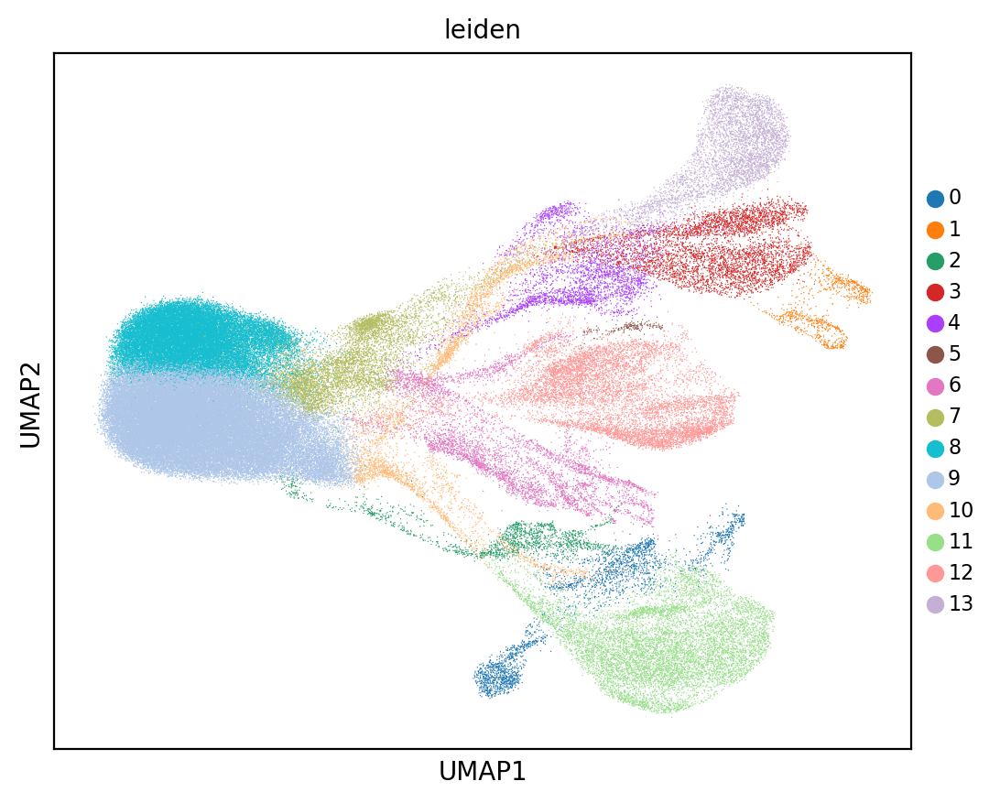

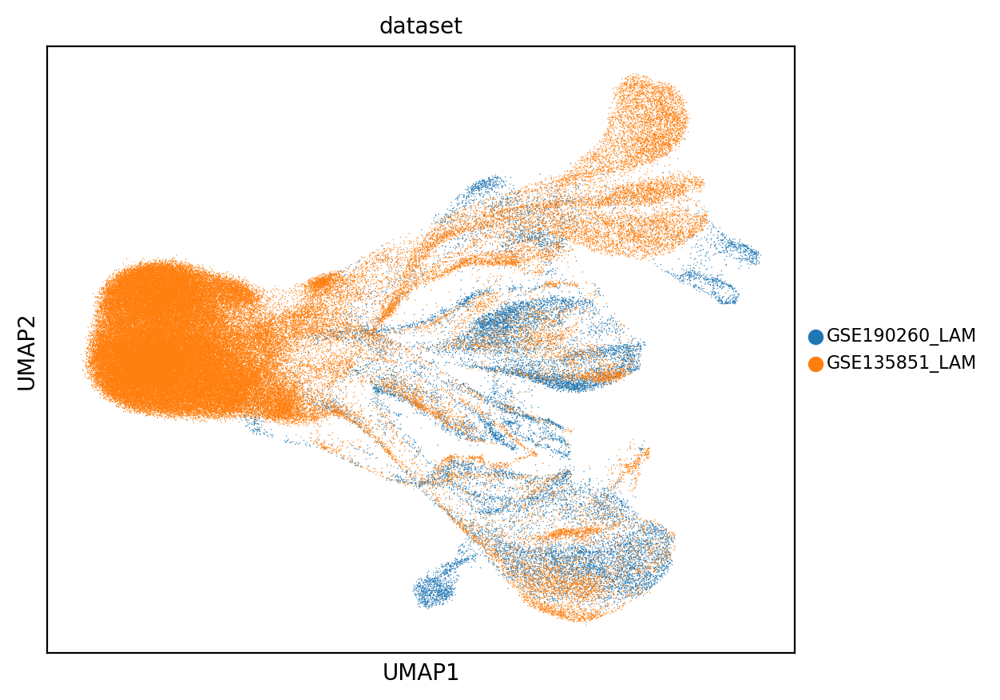

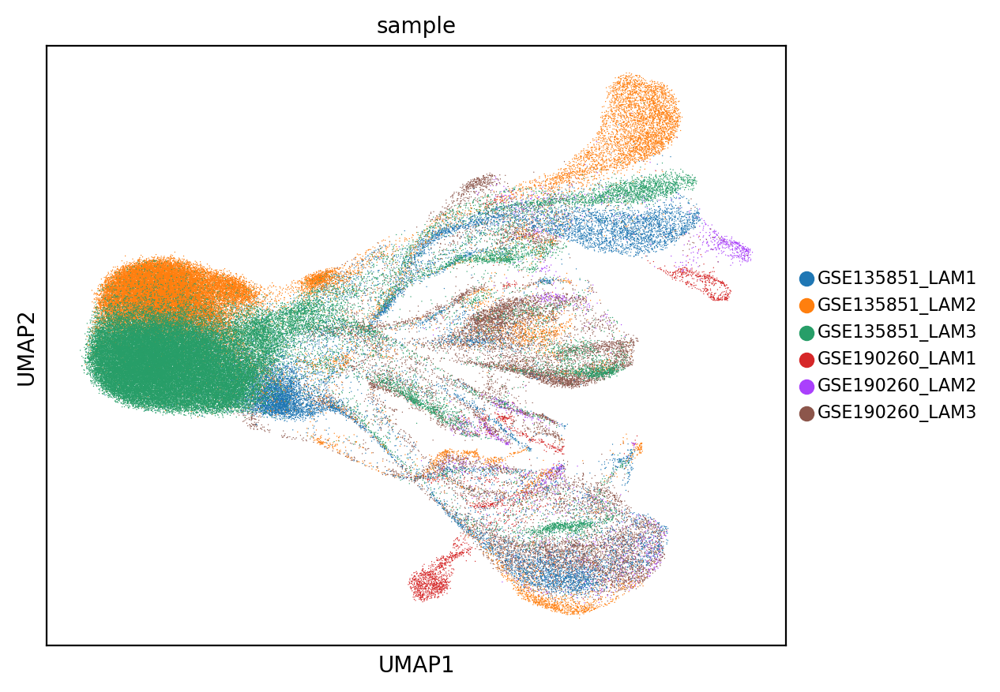

In [132]:
#| hide-input
sc.pl.umap(All_LAM,color=['leiden'], legend_fontsize=8)
sc.pl.umap(All_LAM,color=['dataset'], legend_fontsize=8)
sc.pl.umap(All_LAM,color=['sample'], legend_fontsize=8)

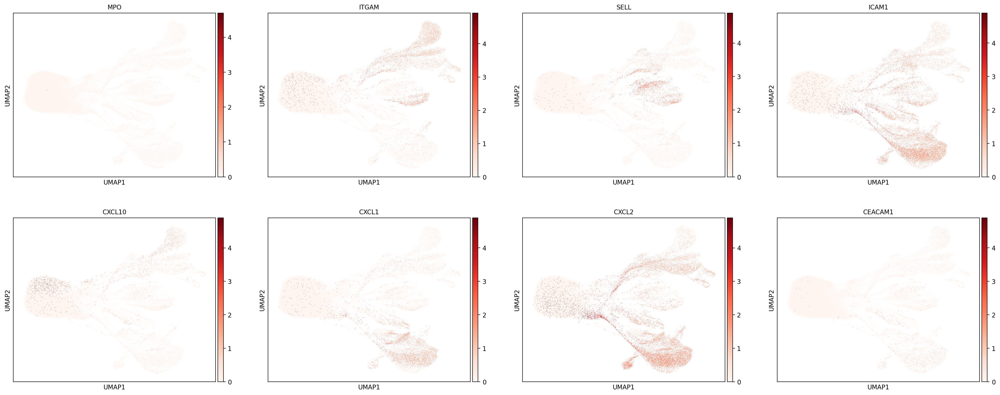

In [133]:
#| hide-input
sc.pl.umap(All_LAM,color=['MPO','ITGAM','SELL','ICAM1','CXCL10','CXCL1','CXCL2','CEACAM1'], legend_fontsize=10, cmap = 'Reds')

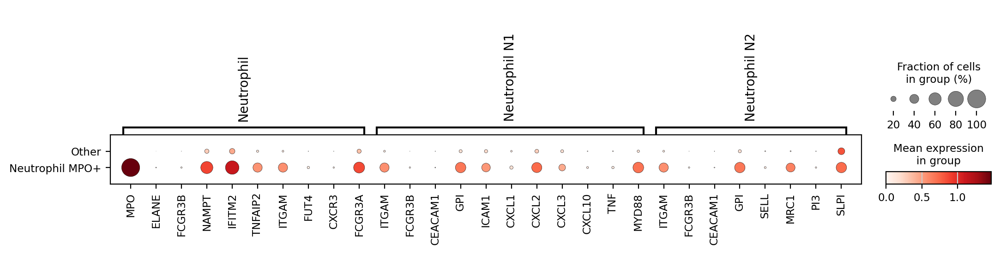

In [134]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}
sc.pl.dotplot(
    All_LAM,
    marker_Neutrophil,
    groupby = ["Cell_Type"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - Lam 2 Samples [GSE135851]'
)

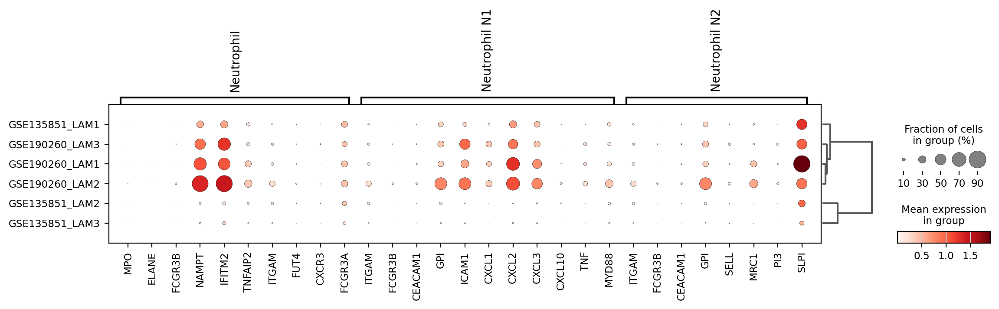

In [135]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    All_LAM,
    marker_Neutrophil,
    groupby = ["sample"], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - Lam 2 Samples [GSE135851]'
)

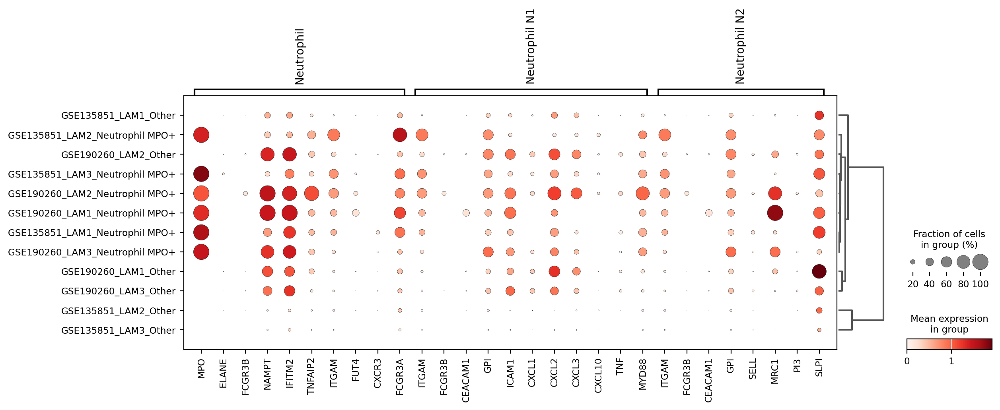

In [136]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    All_LAM,
    marker_Neutrophil,
    groupby = ["sample",'Cell_Type'], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - Lam 2 Samples [GSE135851]'
)

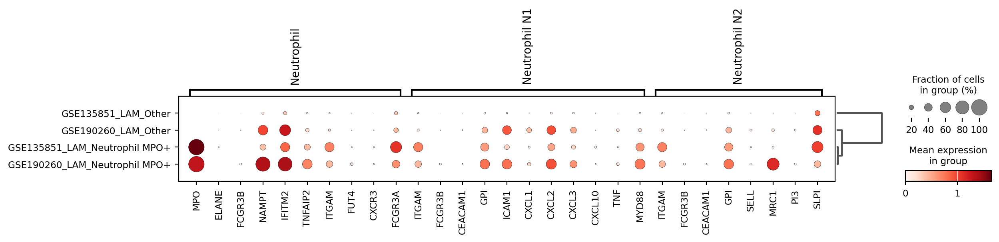

In [139]:
#| hide-input
marker_Neutrophil = {
    "Neutrophil": ['MPO','ELANE','FCGR3B','NAMPT','IFITM2','TNFAIP2','ITGAM','FUT4','CXCR3','FCGR3A'],
    "Neutrophil N1": ["ITGAM","FCGR3B","CEACAM1","GPI","ICAM1","CXCL1",'CXCL2','CXCL3','CXCL10','TNF','MYD88'],
    "Neutrophil N2": ['ITGAM','FCGR3B','CEACAM1','GPI','SELL','MRC1','PI3','SLPI']
}

sc.pl.dotplot(
    All_LAM,
    marker_Neutrophil,
    groupby = ["dataset",'Cell_Type'], 
    dendrogram=True,
    use_raw=False,
    label = 'Dotplot of Neutrophil specific markers - Lam 2 Samples [GSE135851]'
)

In [140]:
#| remove-cell
All_LAM.write_h5ad('/gpfs01/home/mzxcs8/Extra/Neutrophil LAM Phenotype - Johnson Lab/All_LAM.h5ad')